In [36]:
import pylab as plt
import matplotlib.pyplot as plt
import numpy as np
import h5py
import shutil
import pdb
import datetime
import os
from operator import truediv
import operator
from scipy.optimize import curve_fit
import matplotlib.cm as cm
from scipy.optimize import leastsq

%pylab
%matplotlib inline
%load_ext autoreload
%autoreload 2



Using matplotlib backend: Qt4Agg
Populating the interactive namespace from numpy and matplotlib
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
corr_list = [4,11,17,22,27,28,29]
freq_phase = np.linspace(400,800,1024)
colors=['r','g','b','k','c','y','m']
legend_crosscorr = ["(0,4) A63","(1,4) A00","(2,4) A48","(3,4) A31","(5,4) B00","(6,4) B63","(7,4) B48"]


num =14

In [3]:
def mag(tot_frames,corr_files):
        tot_magnitude = np.zeros((tot_frames, len(corr_list), len(freq_phase[50:990])))
        tot_magnitude_ref = np.zeros((tot_frames, 2, len(freq_phase[50:990])))
        x=0
        for corr_file in corr_files:
                for i in range(len(corr_list)):
                        frames =  corr_file['vis'][:].shape[0]
                        tot_magnitude[x:x+frames,i,:] = (np.sqrt(corr_file['vis'][:][:,corr_list[i],50:990]['imag'].astype(np.float)**2 + corr_file['vis'][:][:,corr_list[i],50:990]['real'].astype(np.float)**2))
                tot_magnitude_ref[x:x+frames,0,:] = np.sqrt(corr_file['vis'][:][:,26,50:990]['imag'].astype(np.float)**2 + corr_file['vis'][:][:,27,50:990]['real'].astype(np.float)**2)
                tot_magnitude_ref[x:x+frames,1,:] = corr_file['vis'][:][:,27,50:990]
                x = x + frames

        return tot_magnitude,tot_magnitude_ref

In [4]:
def gain_freq(corr_files,tot_frames,visibility, visibility_ref):
        x=0
        gain_1 = np.zeros((tot_frames, len(corr_list), len(freq_phase[50:990])))
        for corr_file in corr_files:
                frames = corr_file['vis'][:].shape[0]
                gain = np.zeros((frames, len(corr_list), len(freq_phase[50:990])))
                for i in range(len(corr_list)):
                        gain_1[x:frames+x,i,:] = 20*np.log10(np.sqrt(corr_file['vis'][:][:,corr_list[i],50:990]['imag'].astype(np.float)**2 + corr_file['vis'][:][:,corr_list[i],50:990]['real'].astype(np.float)**2)/(np.sqrt(corr_file['vis'][:][:,26,50:990]['imag'].astype(np.float)**2 + corr_file['vis'][:][:,26,50:990]['real'].astype(np.float)**2)))
                x=frames+x

        return gain_1[:,:,::-1]

In [5]:
def delay_unwrap(tot_frames,corr_files):
        delay = np.zeros((tot_frames,len(corr_list)))
        #phi = np.zeros((frames, len(corr_list), len(freq_phase[20:990])))# not taking some frequency bins
        kk=0
        delay_freq_bad_frame = np.zeros((len(corr_list),len(freq_phase[50:990])))
        for corr_file in corr_files:
                vis = corr_file['vis'][:][:,corr_list,50:990]
                frames = corr_file['vis'][:].shape[0]
                vis_abs =  np.sqrt((vis['imag']).astype(np.float)**2+(vis['real']).astype(np.float)**2)
                vis_abs =  np.sqrt((vis['imag']).astype(np.float)**2+(vis['real']).astype(np.float)**2)
                phi = np.arctan2((vis['imag']),(vis['real']))
                unwrap_phase_1 = np.unwrap(phi)
                unwrap_phase = unwrap_phase_1[:,::-1]/(2*np.pi)
                slope = [[0 for x in range(len(corr_list))] for y in range(frames)]
                for j in range(len(corr_list)):
                        slope_1 = []
                        for i in range(frames):
                                slope[i],b = np.polyfit(freq_phase[50:990]*10**6,unwrap_phase[i][j][:],1)
                                if slope[i]<0:
                                        slope[i] = slope[i]*(-1.0)
                        delay[kk:kk+frames,j] = slope
                kk=kk+frames
                #pdb.set_trace()
        return np.array(delay),unwrap_phase #

In [6]:
def get_timestamp(tot_frames,corr_files):
        cpu_cycle = np.zeros(tot_frames)
        x = 0
        for corr_file in corr_files:
                frame = corr_file['vis'][:].shape[0]
                timestamp = corr_file['timestamp']
                cpu_cycle[x:x+frame] = [time[1] for time in timestamp]
                x=x+frame
        return cpu_cycle


In [7]:
def data(chan):
        number_of_frame = corr_file['vis'][:].shape[0]
        print('Number of frames:' + str(number_of_frame))
        return number_of_frame

In [8]:
para=3
def quadratic(x,*p):
        freq_reqd = freq
        return p[0]*x**2 + p[1]*x+  p[2]

In [9]:
def sinusoidal(x,*p):
        freq_reqd = freq
        return p[0]*x + p[1]*(np.cos(2*np.pi*p[2]))#+ np.cos(2*np.pi*4/(0.84*3*10**2/freq_reqd)))

In [10]:
source_dir = ['C:/Users/sidhant/Desktop/data/20170407T194716Z_stone_corr/', 'C:/Users/sidhant/Desktop/data/20170410T180753Z_stone_corr/','C:/Users/sidhant/Desktop/data/20170414T020912Z_stone_corr/' ,'C:/Users/sidhant/Desktop/data/20170430T010748Z_stone_corr_one_file_deleted/', 'C:/Users/sidhant/Desktop/data/20170519T221539Z_stone_corr/' ,'C:/Users/sidhant/Desktop/data/20170525T174006Z_stone_corr_two_files_delated/'] #Apr 7-apr 10, #Apr 10-APR 13 #Apr 29 - May14
tot_frames = 0
corr_files=[]
for d in range(len(source_dir)):
    source_directory = source_dir[d]
    source_name = os.path.realpath(source_directory).split('/')[-1]
    active_dir = source_dir[d]
    all_file_names = os.listdir(active_dir)
    data_file_names = []
    for file_name in all_file_names:
        if ('.lock' not in file_name) and ('.h5' in file_name):
                data_file_names.append(file_name)
    data_file_names.sort()
    for file_name in data_file_names:
        corr_files.append(h5py.File(active_dir+file_name,'r'))

for corr_file in corr_files:
    frames = data(corr_list)
    tot_frames = tot_frames + frames
    

print(corr_files)
visibility, visibility_ref = mag(tot_frames,corr_files)
delay, unwrap_phase = delay_unwrap(tot_frames,corr_files)
# the return gain is in db/logrithmic
gain_all_db = gain_freq(corr_files,tot_frames,visibility, visibility_ref)
gain_all = 10**(gain_all_db/20)

time_stamp = get_timestamp(tot_frames,corr_files)
#date_stamp = [datetime.datetime.fromtimestamp(time) + datetime.timedelta(hours = -7) for time in time_stamp]
date_stamp = [datetime.datetime.fromtimestamp(time)  for time in time_stamp]

Number of frames:360
Number of frames:61
Number of frames:360
Number of frames:119
Number of frames:360
Number of frames:360
Number of frames:360
Number of frames:264
Number of frames:360
Number of frames:360
Number of frames:54
Number of frames:360
[<HDF5 file "00000000_0000.h5" (mode r)>, <HDF5 file "00216004_0000.h5" (mode r)>, <HDF5 file "00000000_0000.h5" (mode r)>, <HDF5 file "00216003_0000.h5" (mode r)>, <HDF5 file "00000000_0000.h5" (mode r)>, <HDF5 file "00000000_0000.h5" (mode r)>, <HDF5 file "00648000_0000.h5" (mode r)>, <HDF5 file "00863999_0000.h5" (mode r)>, <HDF5 file "00000000_0000.h5" (mode r)>, <HDF5 file "00216003_0000.h5" (mode r)>, <HDF5 file "00432001_0000.h5" (mode r)>, <HDF5 file "00216003_0000.h5" (mode r)>]


In [12]:
len(gain_all_db[1,1,:])

940

In [11]:
file = open("temp_data_all.out","r")
date_temp = np.loadtxt('temp_data_all.out')
file.close()

date_weather_data_new = date_temp[0]
temp_weather_data_new = date_temp[1]

temp_frame = [718,120,718,236,718,718,718,526,50,718,106,718]

a= date_weather_data_new[0:718]
b= temp_weather_data_new[0:718]
temp_1 = np.append(a[::2],a[717])
time_1 = np.append(b[::2],b[717])

a= date_weather_data_new[718:838]
b= temp_weather_data_new[718:838]
temp_1 = np.append(temp_1,a[::2])
temp_1 = np.append(temp_1,a[119])
time_1 = np.append(time_1,b[::2])
time_1 = np.append(time_1,b[119])

a= date_weather_data_new[838:1556]
b= temp_weather_data_new[838:1556]
temp_1 = np.append(temp_1,a[::2])
temp_1 = np.append(temp_1,a[717])
time_1 = np.append(time_1,b[::2])
time_1 = np.append(time_1,b[717])

a= date_weather_data_new[1556:1792]
b= temp_weather_data_new[1556:1792]
temp_1 = np.append(temp_1,a[::2])
temp_1 = np.append(temp_1,a[235])
time_1 = np.append(time_1,b[::2])
time_1 = np.append(time_1,b[235])

a= date_weather_data_new[1792:2510]
b= temp_weather_data_new[1792:2510]
temp_1 = np.append(temp_1,a[::2])
temp_1 = np.append(temp_1,a[717])
time_1 = np.append(time_1,b[::2])
time_1 = np.append(time_1,b[717])

a= date_weather_data_new[2510:3228]
b= temp_weather_data_new[2510:3228]
temp_1 = np.append(temp_1,a[::2])
temp_1 = np.append(temp_1,a[717])
time_1 = np.append(time_1,b[::2])
time_1 = np.append(time_1,b[717])

a= date_weather_data_new[3228:3946]
b= temp_weather_data_new[3228:3946]
temp_1 = np.append(temp_1,a[::2])
temp_1 = np.append(temp_1,a[717])
time_1 = np.append(time_1,b[::2])
time_1 = np.append(time_1,b[717])

a= date_weather_data_new[3946:4472]
print(len(a))
b= temp_weather_data_new[3946:4472]
temp_1 = np.append(temp_1,a[::2])
temp_1 = np.append(temp_1,a[525])
time_1 = np.append(time_1,b[::2])
time_1 = np.append(time_1,b[525])


time_partial_new = np.array([(datetime.datetime.fromtimestamp(x))  for x in temp_1 ])
#time_partial_new = np.array([(datetime.datetime.fromtimestamp(x)) for x in temp_1 ])

# these are the times that we are using from here!
temp_intercept_model = time_1[42::]
time_intercept_model = time_partial_new[42::]

526


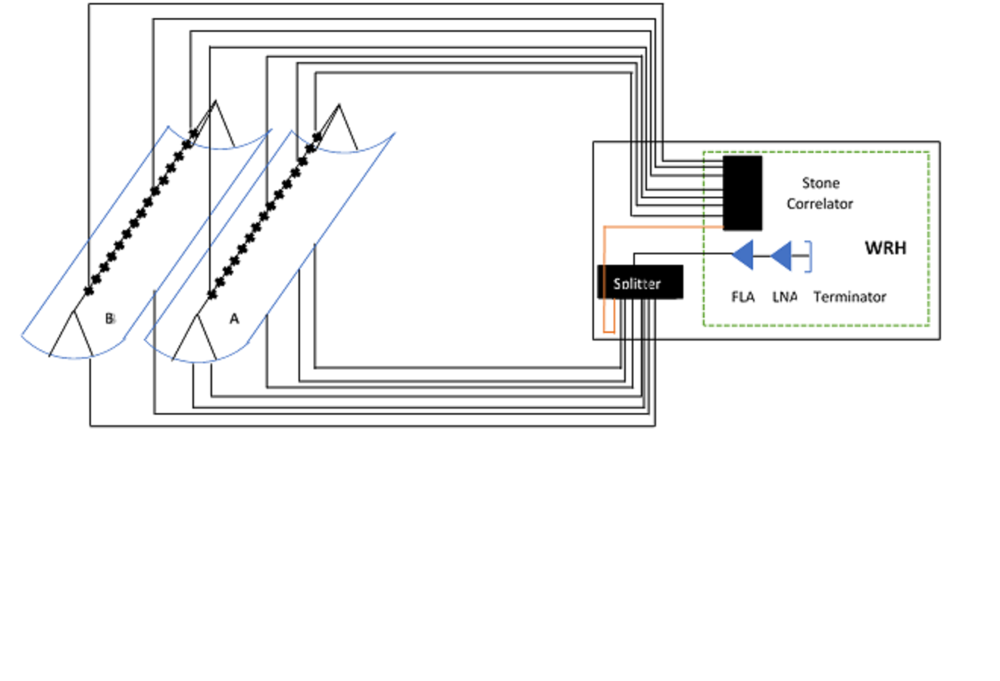

In [12]:
from IPython.display import Image
Image(filename='experimental_setup.png')

In [12]:
freq_selected = freq_phase[50:990]
print (freq_selected[462])

600.195503421


In [22]:
print(freq_selected[155])
freq=155

480.156402737


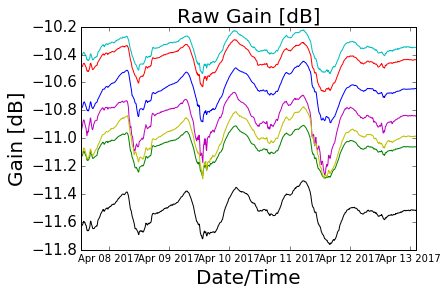

In [23]:
for i in range(len(corr_list)):
    plt.plot(date_stamp[0:800],gain_all_db[0:800,i,462])
    plt.xlabel('Date/Time',size=20)
    plt.yticks( fontsize = 15)
    plt.ylabel('Gain [dB]',size=20)
    plt.title('Raw Gain [dB]', size=20)

In [43]:
freq_phase[50]

419.5503421309873

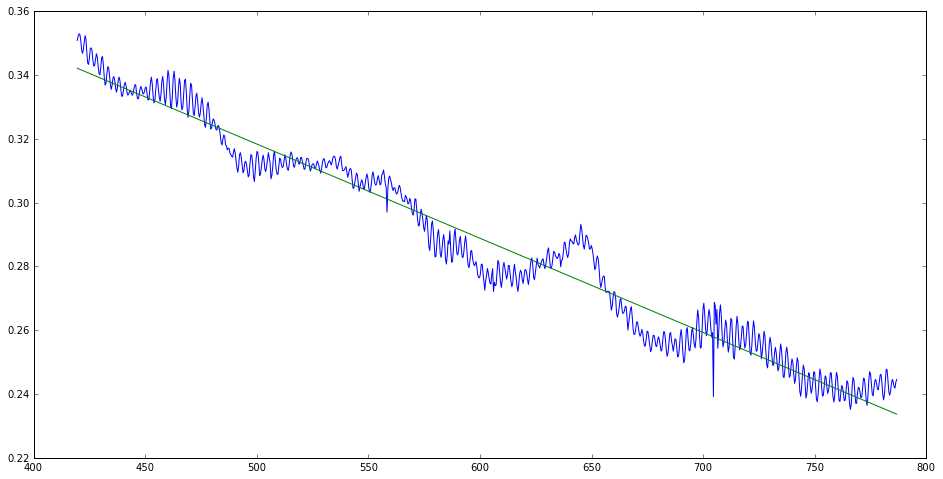

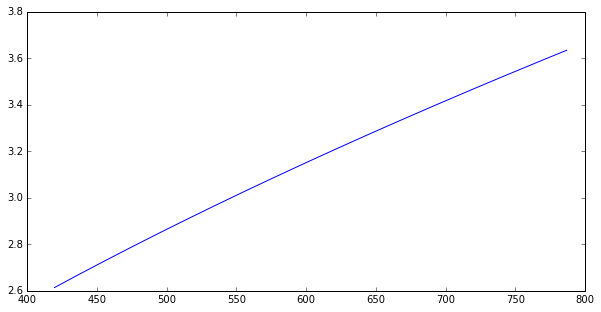

In [44]:
figure(figsize(16,8))
plt.plot(freq_phase[50:990],gain_all[0,1,:])
z=np.polyfit(freq_phase[50:990], gain_all[0,1,:],1)
p=np.poly1d(z)

plt.plot(freq_phase[50:990],p[1]*freq_phase[50:990]+p[0])
attenuation = (0.122290)*np.sqrt(freq_phase[50:990])  +  (0.000260)*freq_phase[50:990]
figure(figsize(10,5))
plt.plot(freq_phase[50:990],attenuation)

C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\ipykernel\__main__.py:28: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


only one
only one
only one
only one
only one
only one
only one
579.472140762
478.201368524


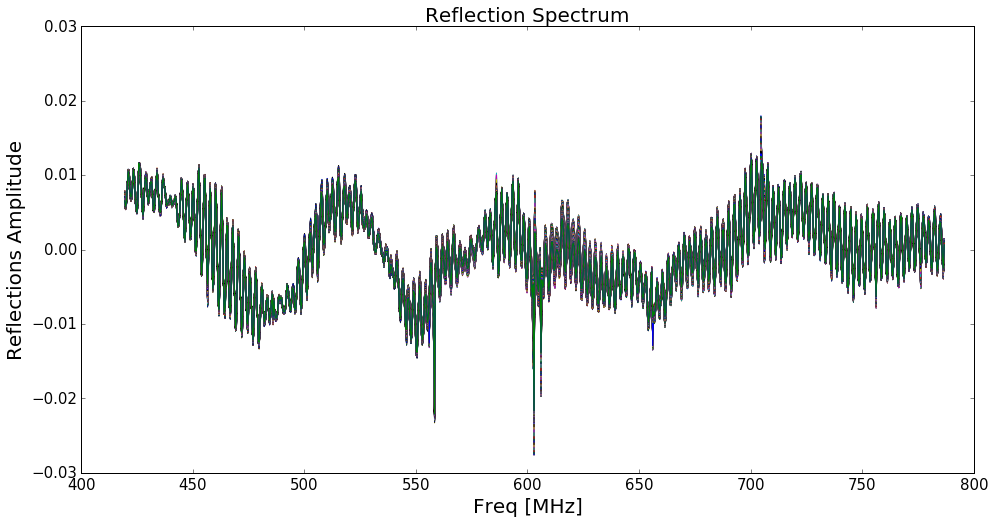

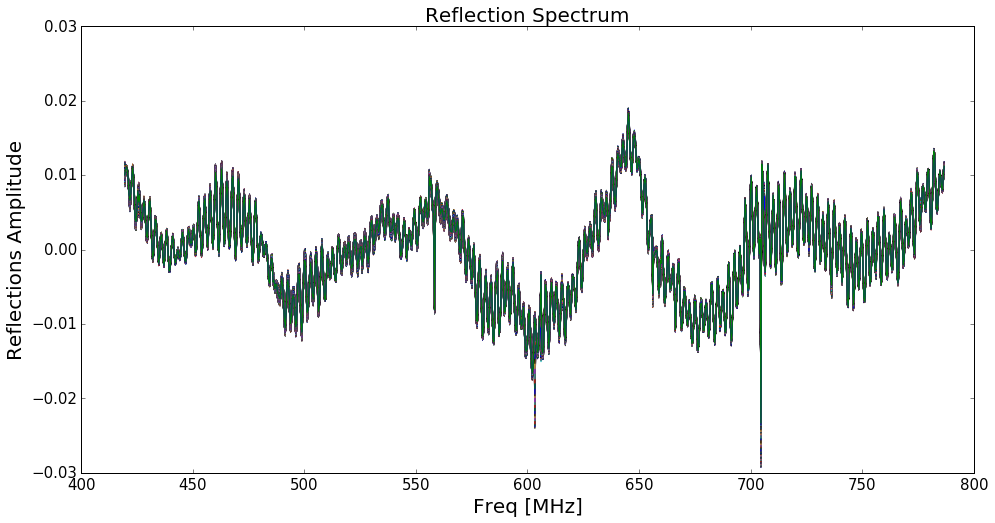

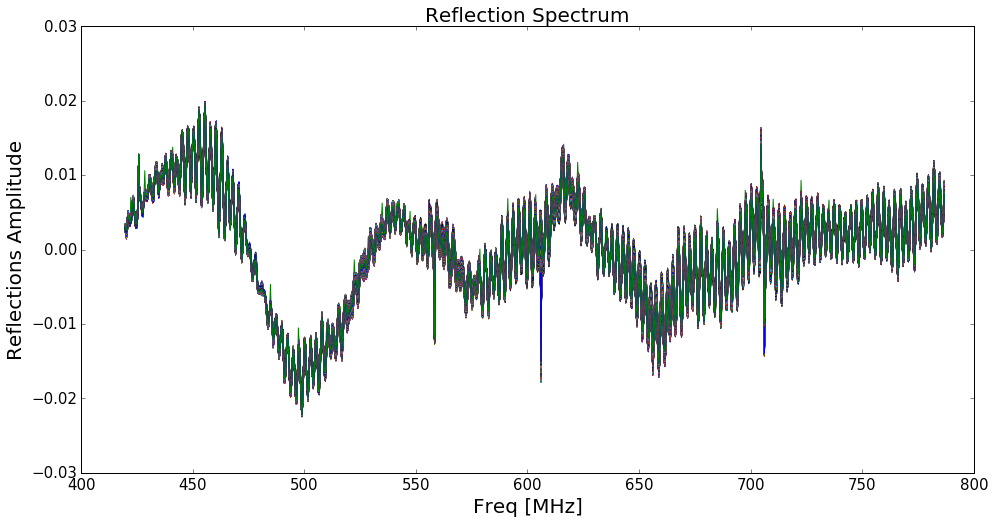

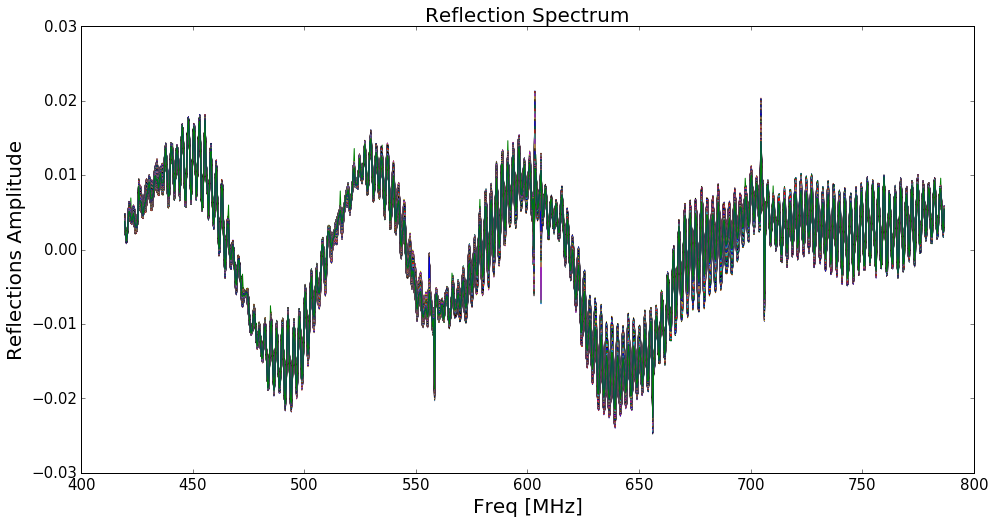

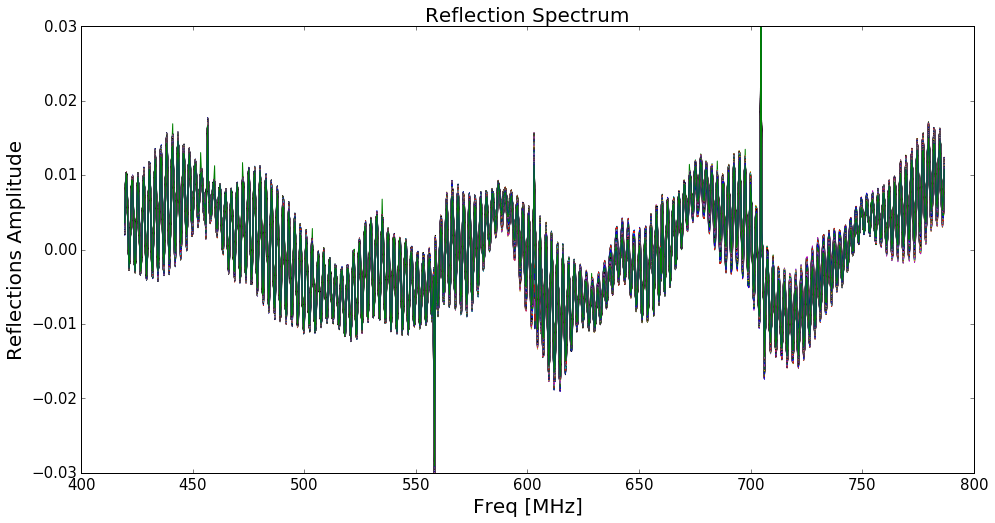

...

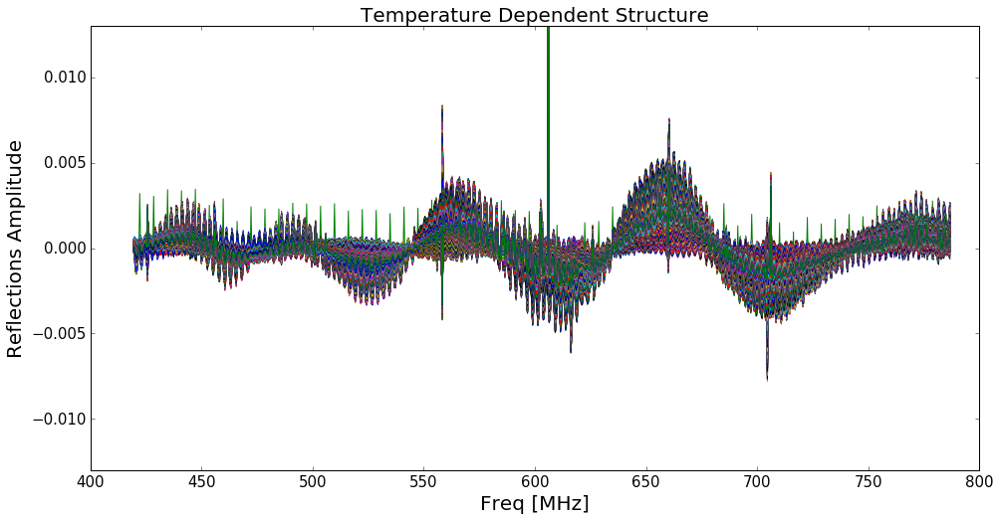

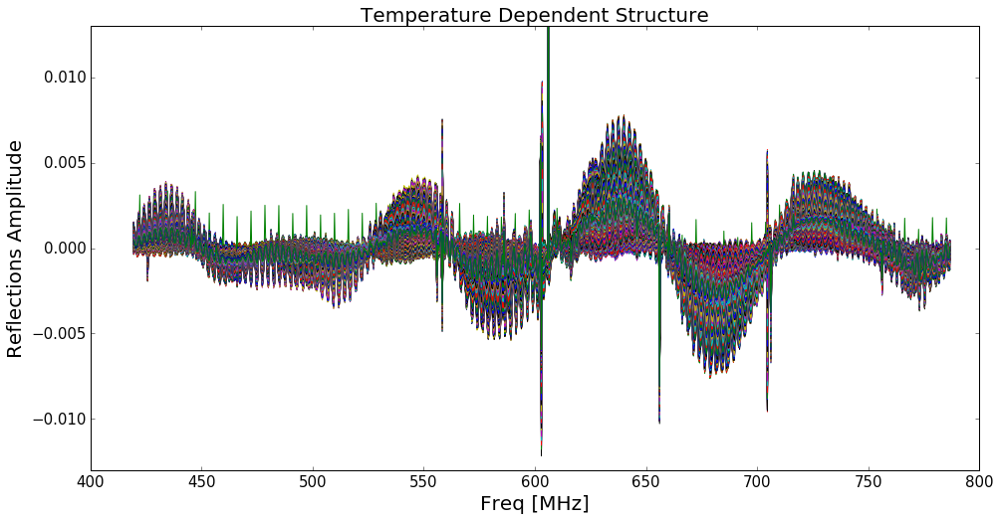

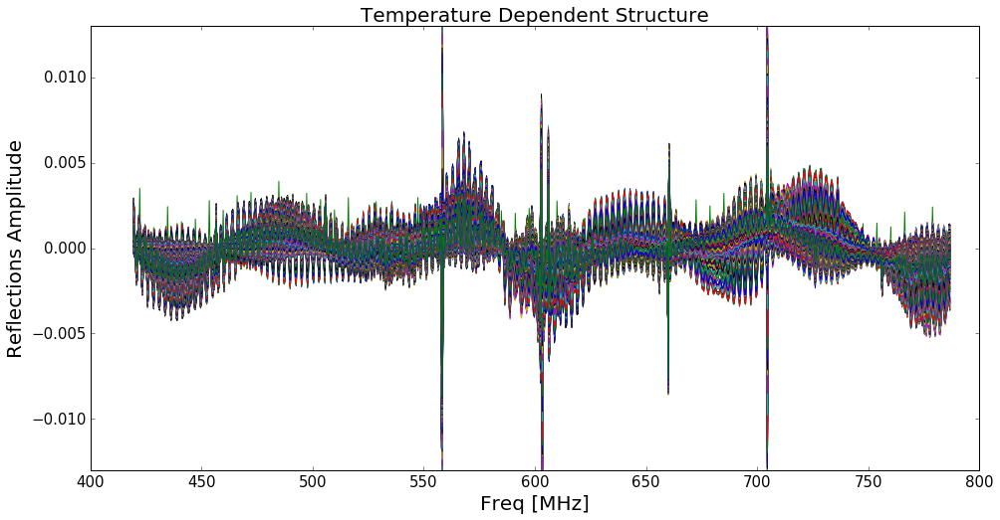

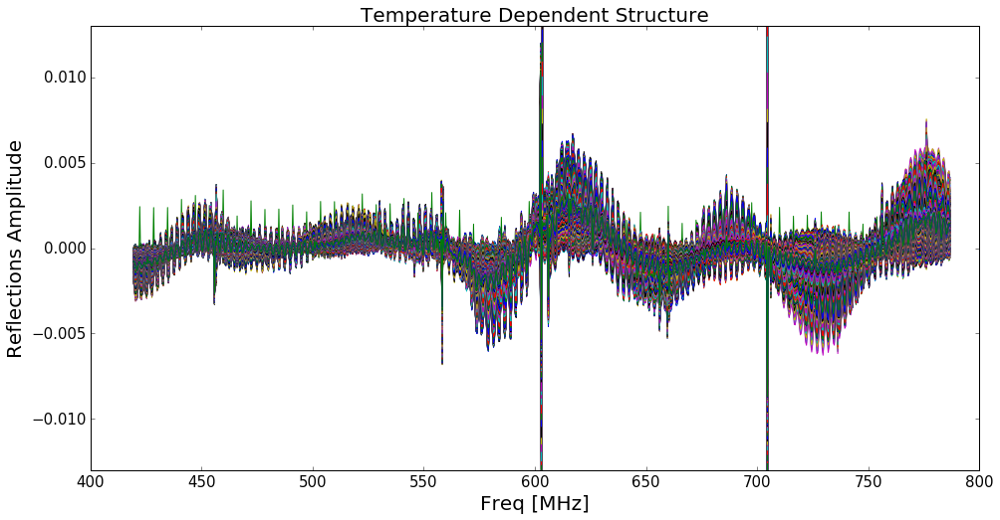

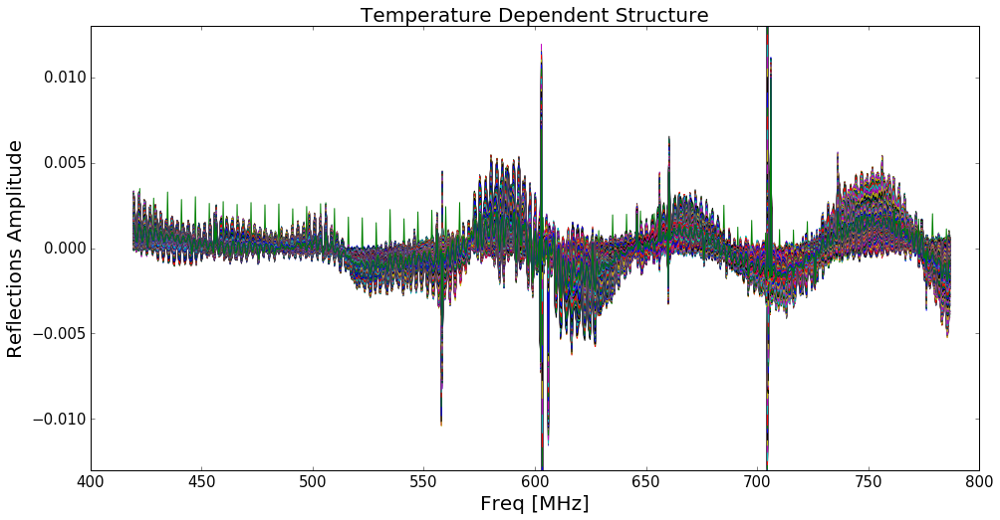

In [24]:
# Analyzing one cable and multiple time frames 

k=0
figure(figsize(16,8))
frame_numbers = np.linspace(0,800, num=800)

val_single_freq_bin1 = np.zeros(len(frame_numbers))
val_single_freq_bin2 = np.zeros(len(frame_numbers))
val_single_freq_bin3 = np.zeros(len(frame_numbers))
val_single_freq_bin4 = np.zeros(len(frame_numbers))

val_all_freq = []
val_all_freq_pre = np.zeros((len(frame_numbers),len(freq_phase[50:990])))
count=0
calc_avg = []

for i in range(len(corr_list)):
    val_all_freq.append([])

plt_count=0        
for kk in range(len(corr_list)):
    
    val_all_freq[kk] = np.zeros((len(frame_numbers),len(freq_phase[50:990])))
    plt_count = plt_count+1
      
    for i in range(len(frame_numbers)):
        
        gain_raw = gain_all[frame_numbers[i],kk,:] # for cable 2
        z=np.polyfit(freq_phase[50:990], gain_raw,1)
        p=np.poly1d(z)
        gain_line_sub = gain_raw - p(freq_phase[50:990])

        if i==0:
            print('only one')
            gain_line_sub_reference = gain_line_sub
            gain_reference = gain_raw
        
        plt.figure(plt_count)
        
        #plt.subplot(2,1,1)
        plt.plot(freq_phase[50:990], gain_line_sub )
        plt.ylim(-0.03,0.03)
        #plt.title('Reflections for cable number %s and multiple time frames' %(str(legend_crosscorr[kk])))
        #plt.ylabel('Raw Gain - Linear fit')
        plt.xlabel('Freq [MHz]', size=20)
        plt.title('Reflection Spectrum', size=20)
        plt.ylabel('Reflections Amplitude', size=20)
        plt.yticks( fontsize = 15)
        plt.xticks( fontsize = 15)
        
        
        plt.figure(plt_count+7)
        
        #plt.subplot(2,1,2)
        plt.plot(freq_phase[50:990],gain_line_sub- gain_line_sub_reference)
        plt.ylim(-0.013,0.013)
        plt.title('Temperature Dependent Structure', size=20)
        plt.ylabel('Reflections Amplitude', size=20)
        #plt.title('Subtracting Reflections of frame 1 from other frames for cable %s' %(str(legend_crosscorr[kk])),)
        #plt.ylabel('Difference in Reflections')
        plt.xlabel('Freq [MHz]', size=20)
        plt.yticks( fontsize = 15)
        plt.xticks( fontsize = 15)

        for k in range(len(freq_phase[50:990])):
            val_all_freq[kk][i][k] = gain_line_sub[k]- gain_line_sub_reference[k]
            val_all_freq_pre[i,k] = gain_line_sub[k]

        val_single_freq_bin1[i] = gain_line_sub[459]- gain_line_sub_reference[459]
        val_single_freq_bin2[i] = gain_line_sub[460]- gain_line_sub_reference[460]
        val_single_freq_bin3[i] = gain_line_sub[461]- gain_line_sub_reference[461]
        val_single_freq_bin4[i] = gain_line_sub[700]- gain_line_sub_reference[700]

    #plt.savefig('times-800-reflection %s .png' %(legend_crosscorr[kk]))
print(freq_phase[459])
print(freq_phase[200])
    

0
1
2
3
4
5
6


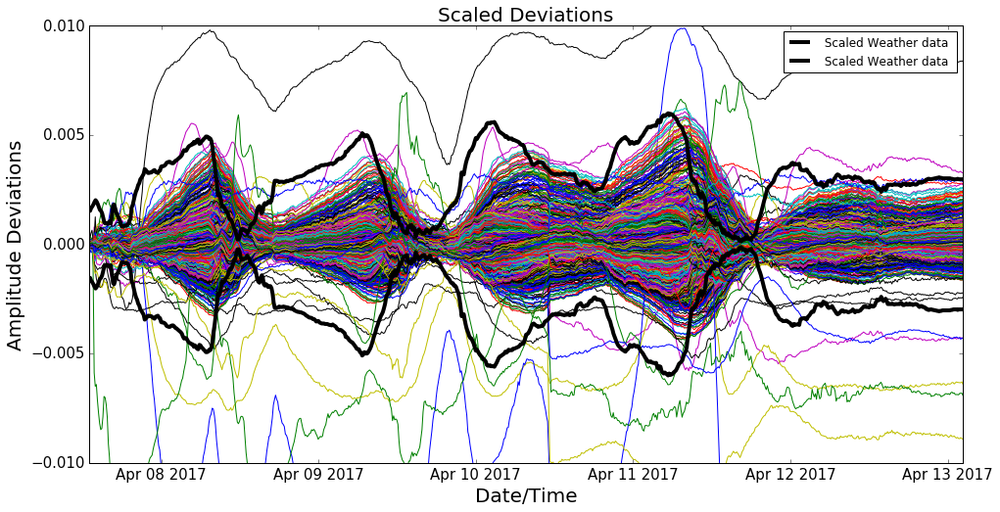

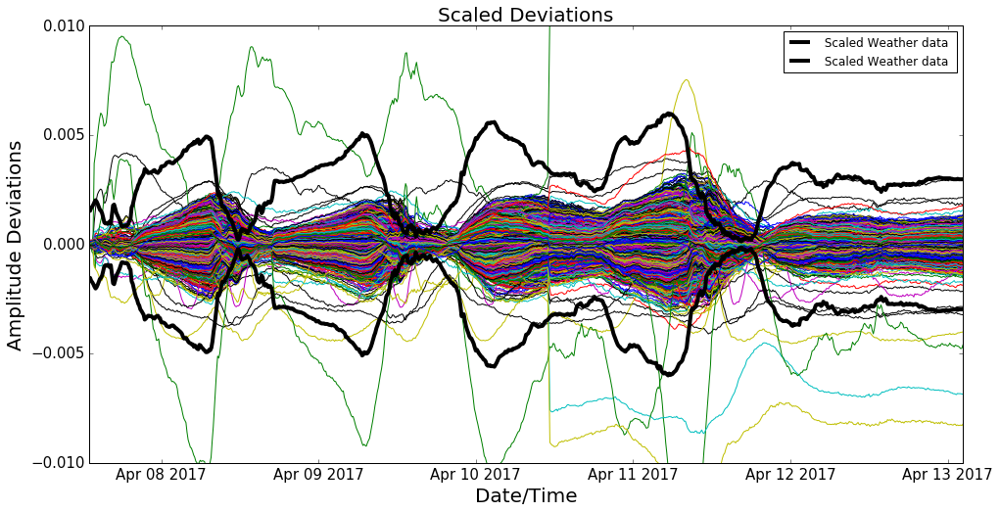

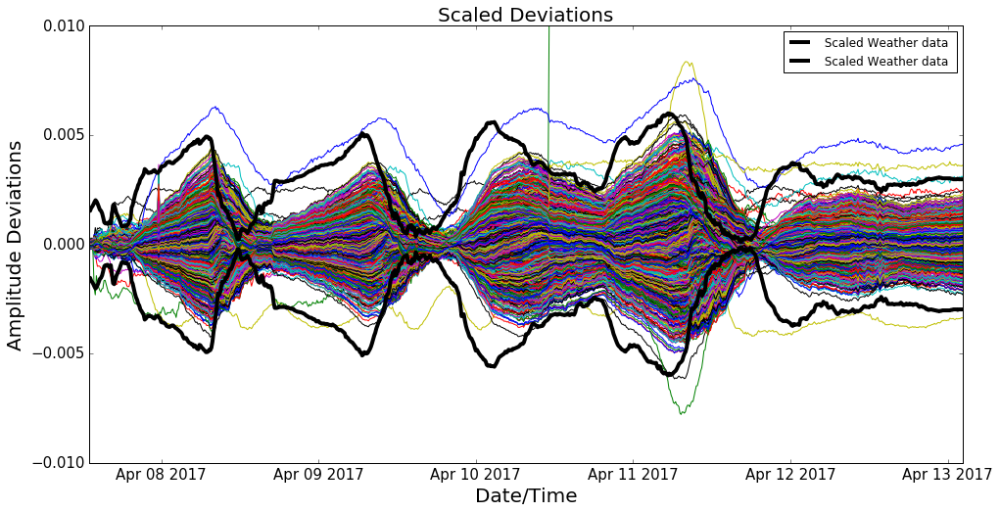

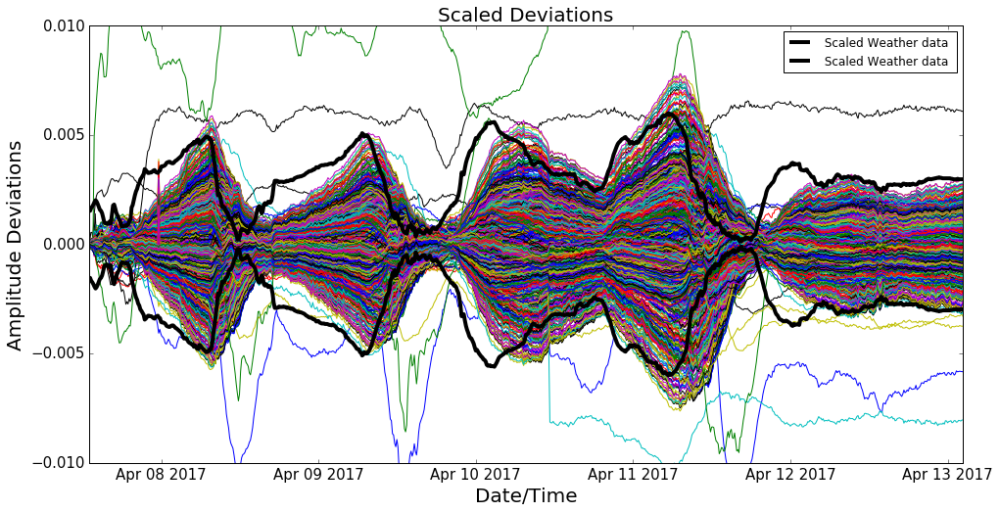

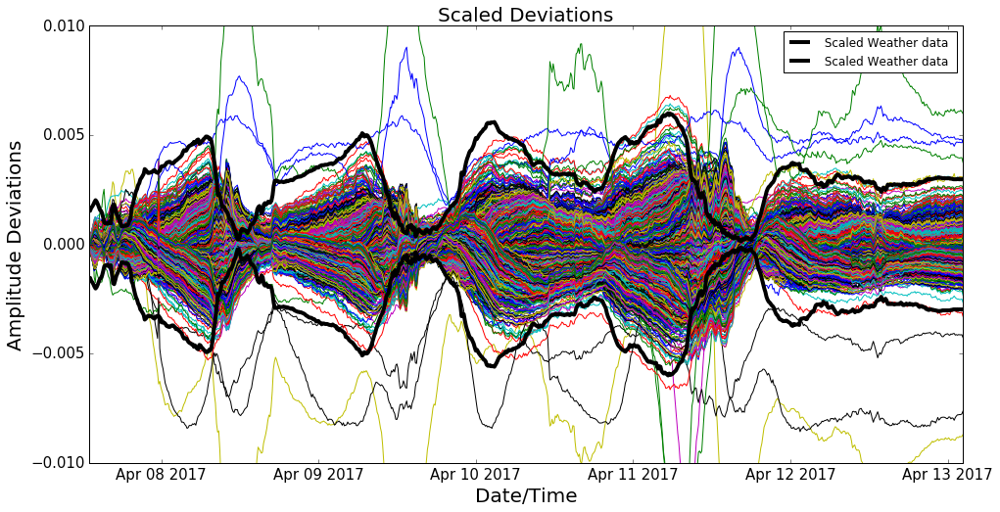

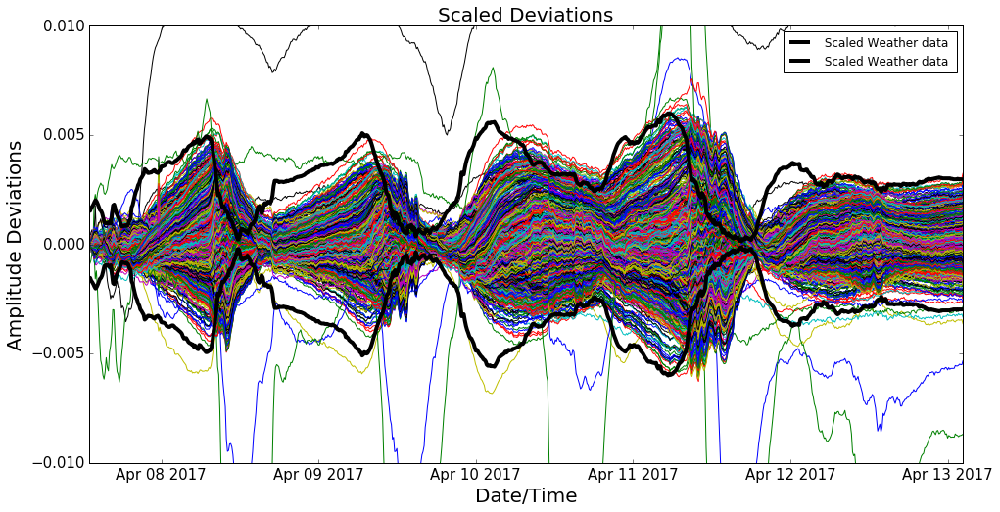

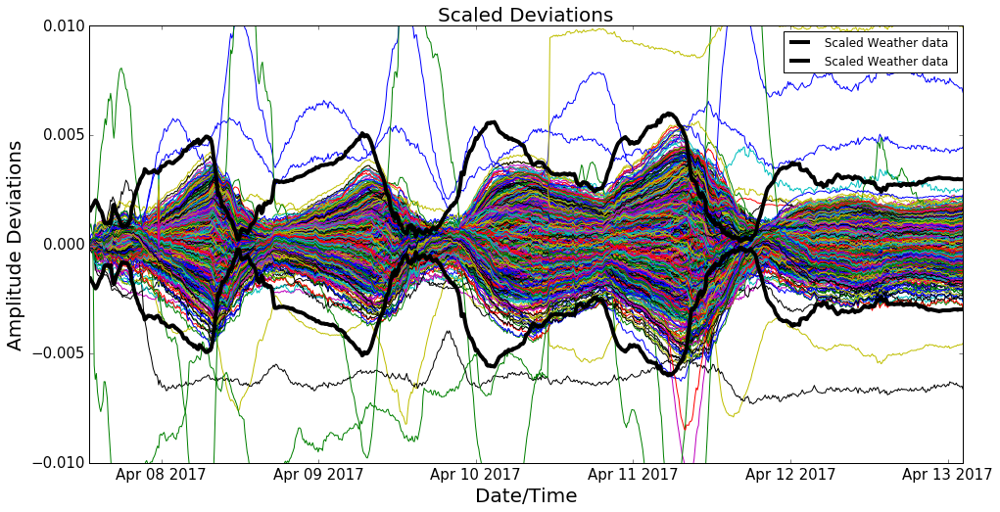

In [25]:
for kk in range(len(corr_list)):
    print(kk)
    for k in range(len(freq_phase[50:990])):
        plt.figure(kk+1)
        plt.plot(date_stamp[0:800],val_all_freq[kk][:,k])
    plt.ylim(-0.01,0.01)
    plt.plot(time_intercept_model[0:800],2*((temp_intercept_model[0:800]+273)/5000 -0.057), 'k',linewidth =4,label= ' Scaled Weather data ')   
    plt.plot(time_intercept_model[0:800],-2*((temp_intercept_model[0:800]+273)/5000 -0.057), 'k',linewidth =4,label= ' Scaled Weather data ')
    plt.title('Scaled Deviations', size=20)
    plt.ylabel('Amplitude Deviations', size=20)
    plt.xlabel('Date/Time', size = 20)
    plt.yticks( fontsize = 15)
    plt.xticks( fontsize = 15)
    #plt.title('(Reflection (t,f) - Reflection (ref,f)) at each frequency for cable %s' %(legend_crosscorr[kk]), size =20)
    #plt.ylabel('Difference in Reflection', size =20)
    #plt.xlabel('Time', size=20)
    #plt.axhline(y=0.004,linewidth=2)
    plt.legend()
    #plt.savefig('diff_reflection %s.png' %(legend_crosscorr[kk]))

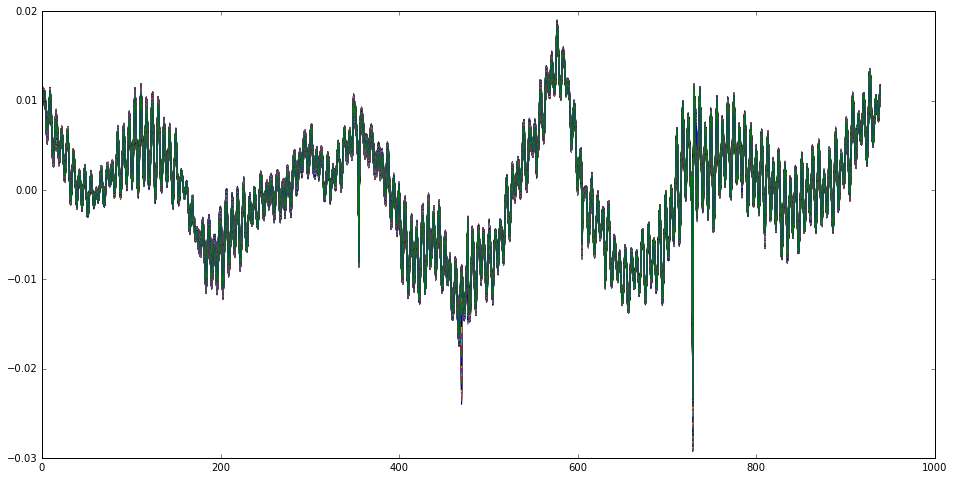

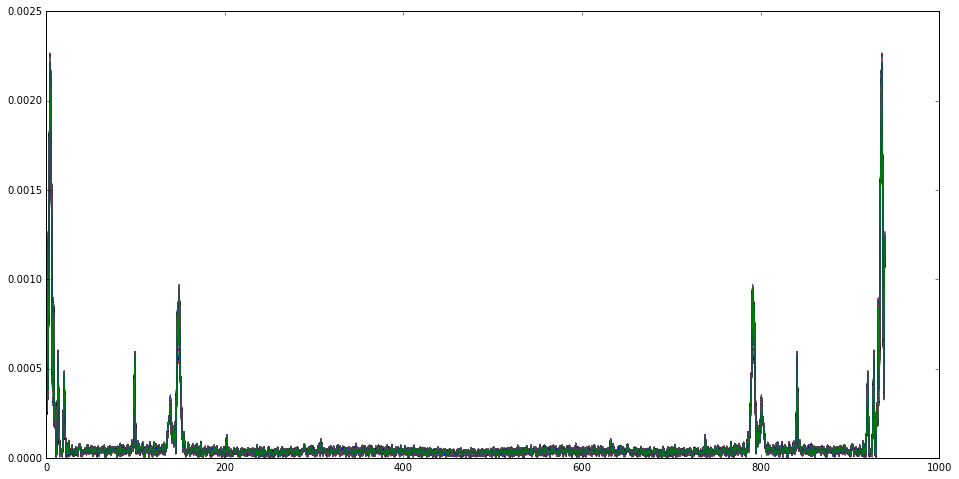

In [26]:
plt.figure(figsize(16,8))

for k in range(800):

    z=np.polyfit(freq_phase[50:990], gain_all[k,1,:],1)
    p=np.poly1d(z)
    gain_line_sub = gain_all[k,1,:] - p(freq_phase[50:990])
    #gain_all_line_sub.append(gain_line_sub)
    ifft_component = np.fft.ifft(gain_line_sub)  
    
    plt.figure(1)
    plt.plot(gain_line_sub)
    
    plt.figure(2)
    plt.plot(np.abs(ifft_component))
    '''
    plt.xlim(120,165)
    plt.ylim(0,0.001)
    plt.axvline(x=139)
    plt.axvline(x=147)
    plt.axvline(x=149)
    
    plt.xlim(780,850)
    plt.ylim(0,0.001)
    plt.axvline(x=940-139)
    plt.axvline(x=940-147)
    plt.axvline(x=940-149)
    # plt.xlime(120.150, lineshape = 3)
    '''

940
1880


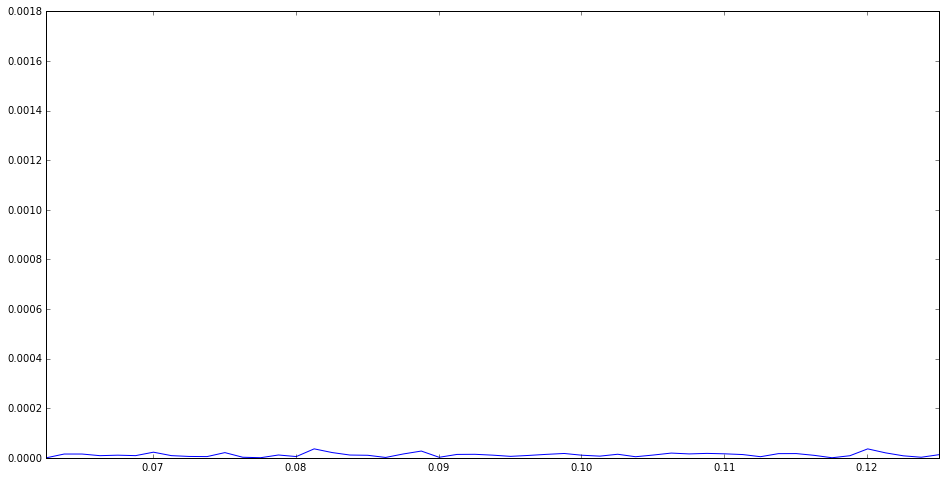

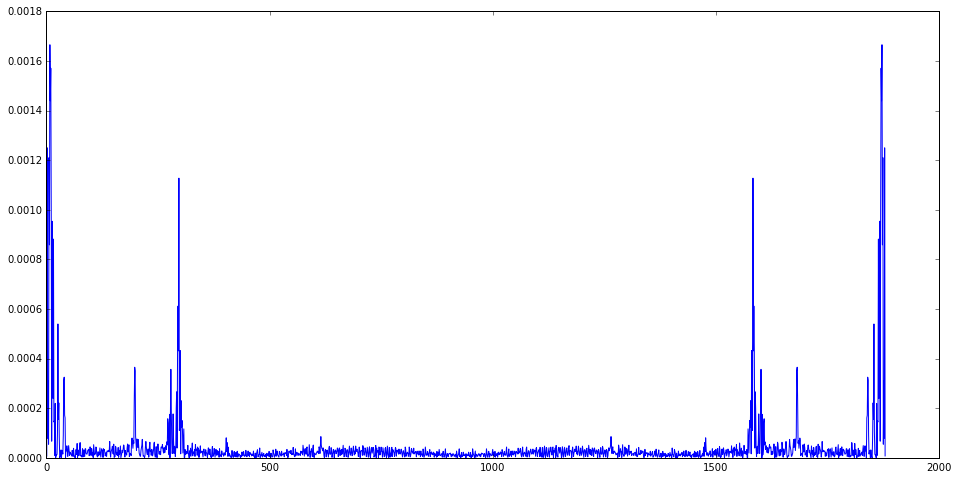

In [16]:
plt.figure(figsize(16,8))
k=1
z=np.polyfit(freq_phase[50:990], gain_all[k,1,:],1)
p=np.poly1d(z)
gain_line_sub1 = gain_all[k,1,:] - p(freq_phase[50:990])
gain_line_sub = np.concatenate((gain_line_sub1,gain_line_sub1[::-1]))

ifft_component = np.fft.ifft(gain_line_sub)  

time=np.linspace(0,2.56, num=2048)

print(len(time[50:990]))
print(len(ifft_component))
#plt.figure(1)
#plt.plot(time,gain_line_sub)

plt.figure(1)
plt.plot(time[50:990],np.abs(ifft_component)[940:len(ifft_component)])
plt.xlim(time[50],time[100])

plt.figure(2)
plt.plot(np.abs(ifft_component))

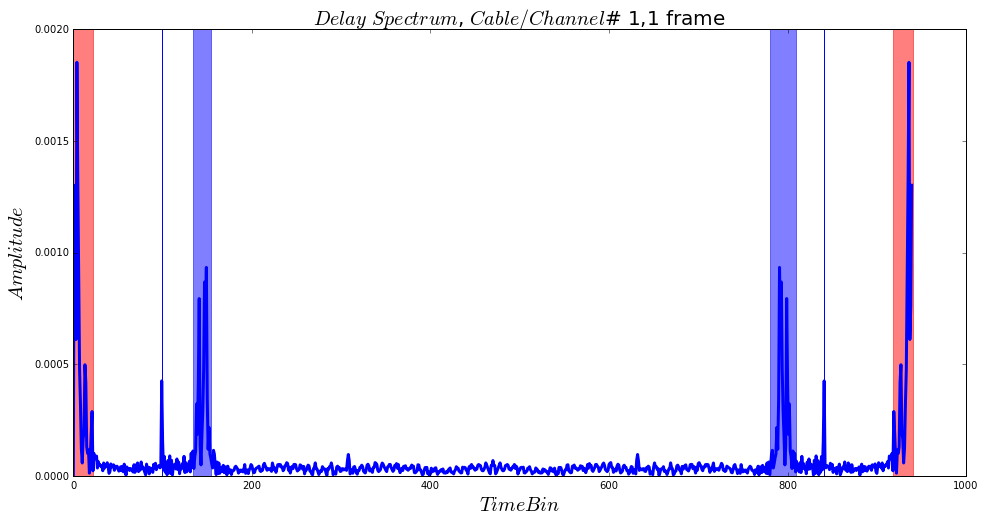

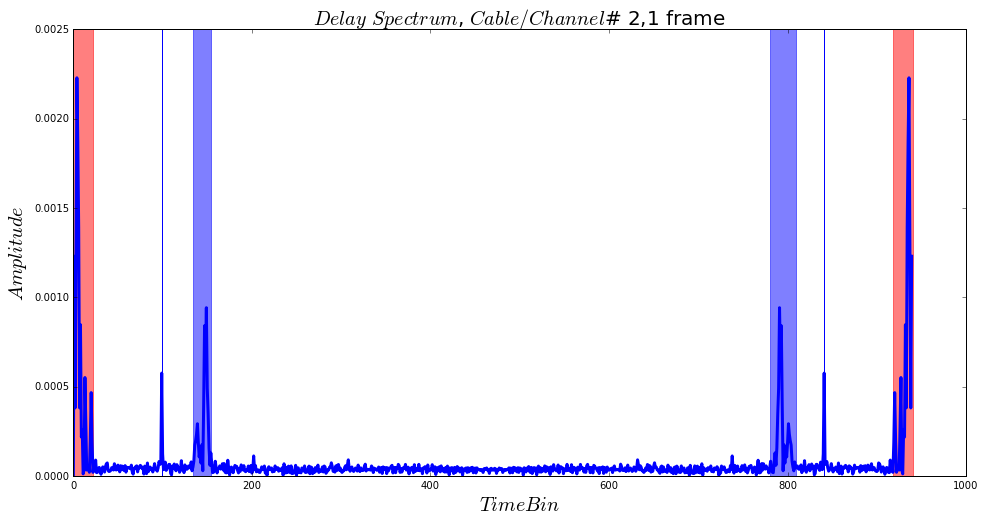

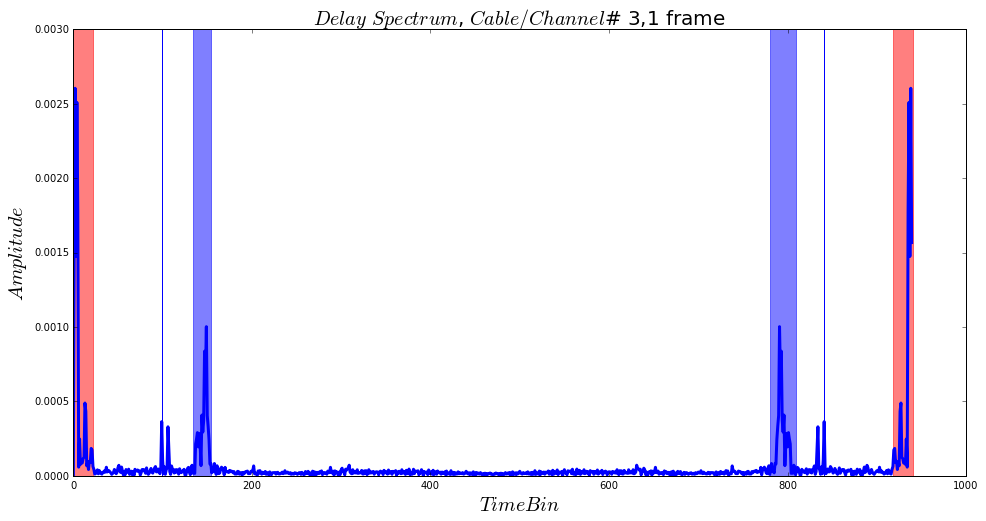

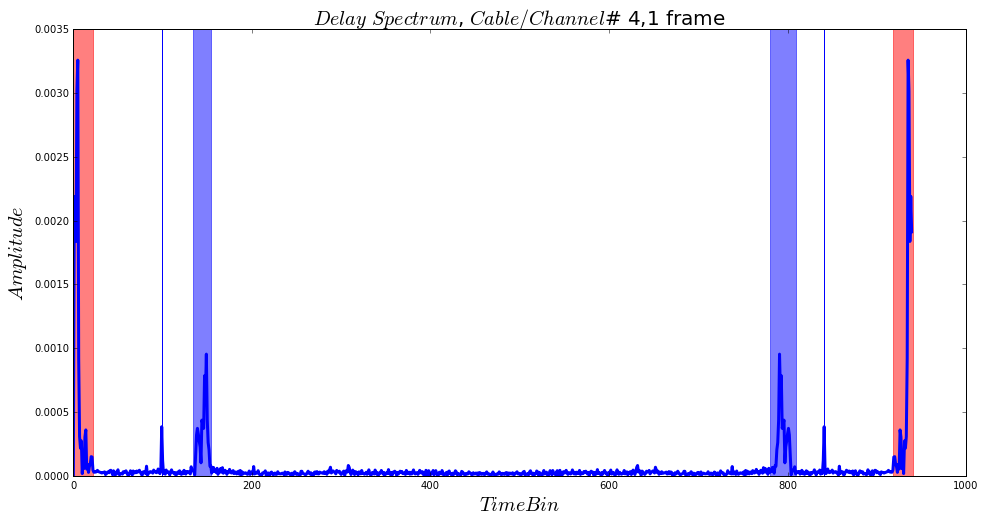

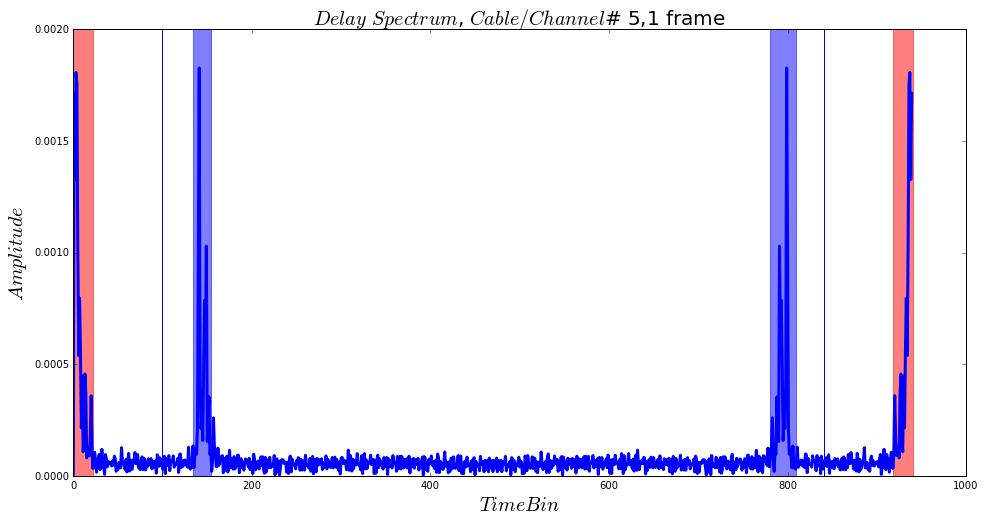

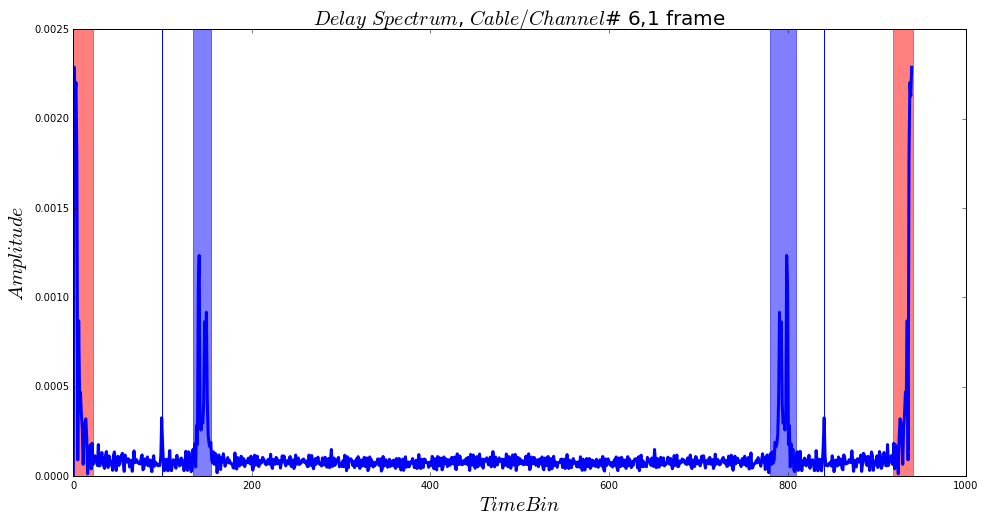

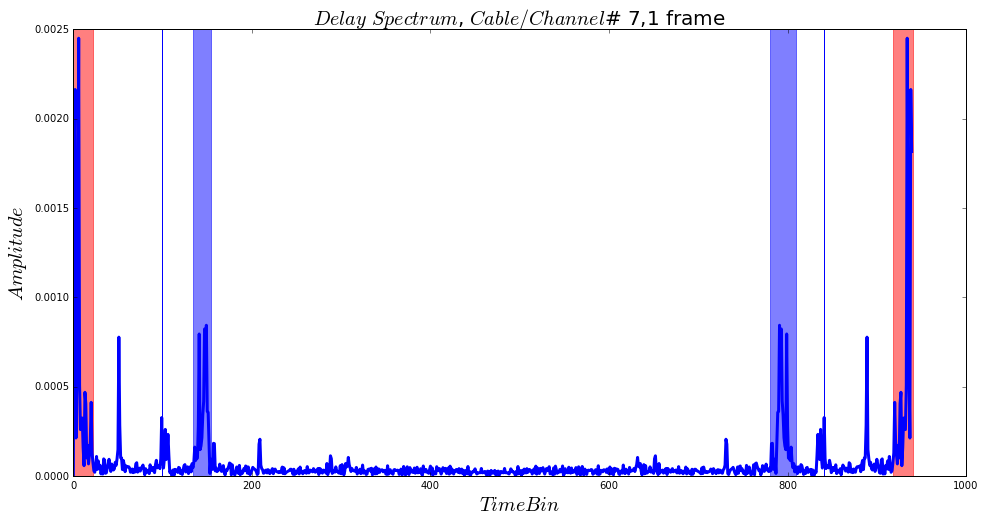

In [17]:
components_all_cables=[]
amplitude_all_cables=[]
gain_all_line_sub=[]

kk=1
for k in range(len(corr_list)):
 
    components=[]
    amplitude =[]

    z=np.polyfit(freq_phase[50:990], gain_all[800,k,:],1)
    p=np.poly1d(z)
    gain_line_sub = gain_all[800,k,:] - p(freq_phase[50:990])
    gain_all_line_sub.append(gain_line_sub)

    ifft_component = np.fft.ifft(gain_line_sub)  
    ifft_component0 = np.fft.ifft(gain_line_sub) 
    end = len(ifft_component)
    '''
    for i in range(end):
        if np.abs(ifft_component[i]) > 18*np.mean(np.abs(ifft_component)):#-np.mean(np.abs(ifft_component))/2:
            components.append(i)
            amplitude.append(np.abs(ifft_component[i]))
    '''
    for i in range(end):
        if (i<22) or (i>928):
            components.append(i)
            amplitude.append(np.abs(ifft_component[i]))
    
    end_components = len(components)

    for i in range(len(ifft_component)):
        if i  not in components: 
            ifft_component0[i] = 0

    plt.figure(k+kk)

    plt.plot(np.abs(ifft_component),'b',linewidth=3,label='IFFT after removal of linear fit from gain')
    #plt.plot(np.abs(ifft_component0), 'r',linewidth=3, label='IFFT after removal of linear fit from gain and keeping reflection components and zeroing the white noise')
    plt.title('$Delay$ $Spectrum$, $Cable/Channel$# %i,1 frame' %(k+1), size =20)
    plt.ylabel('$Amplitude$', size=20)
    plt.xlabel('$Time Bin$',size=20)
    #plt.xlim(830,850)
    #plt.xlim(135,155)
    #plt.axhline(y=18*np.mean(np.abs(ifft_component)))
    plt.axvline(x=841)
    plt.axvline(x=99)
    #plt.axvline(x=149)
    #plt.xlim(900,len(ifft_component0))
    #plt.xlim(900)
    plt.axvspan(0, 22, alpha=0.5, color='red')
    plt.axvspan(918, 941, alpha=0.5, color='red')
                         
    plt.axvspan(134, 154, alpha=0.5, color='blue')
    plt.axvspan(780, 810, alpha=0.5, color='blue')
    #plt.legend()
    
    components_all_cables.append(components)
    amplitude_all_cables.append(amplitude)
    

In [27]:
def my_sin(term2,amp,phase,n):
    return amp*np.sin(n*term2 + phase)

In [19]:
parameters_all_cables=[]

for k in range(len(corr_list)):
    parameters = np.zeros(shape=(np.int(len(components_all_cables[k])),3))
    
    for i in range(np.int(len(components_all_cables[k]))):
        ifft_component = np.fft.ifft(gain_all_line_sub[k])
        ifft_reflection = np.fft.ifft(gain_all_line_sub[k])

        for kk in range(len(ifft_component)):
            if kk != components_all_cables[k][i]:
                ifft_reflection[kk]=0

        ifft_reflections_half = np.real(np.fft.fft(ifft_reflection))
        
        N= len(freq_phase[50:990])
        term2 = np.arange(N) 

        guess_amplitude = np.max(ifft_reflections_half)
        guess_phase = 0.75 #1.5 
        n=2*np.pi*components_all_cables[k][i]/940
        
        if i==2:
            guess_phase = 1.5
        if i==9:
            guess_phase = np.pi

        guess_offset = np.mean(ifft_reflections_half) 
        p0=[ guess_amplitude, guess_phase, n]

        fit = curve_fit(my_sin, term2, ifft_reflections_half, p0=p0)
        data_fit = my_sin(term2, *fit[0])

        fit_leastsq = leastsq(lambda p: my_sin(term2, *p) - ifft_reflections_half, p0)
        parameters[i,:]= fit[0]
        
    parameters_all_cables.append(parameters)

C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\scipy\optimize\minpack.py:690: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


RuntimeError: Optimal parameters not found: Number of calls to function has reached maxfev = 800.

IndexError: list index out of range

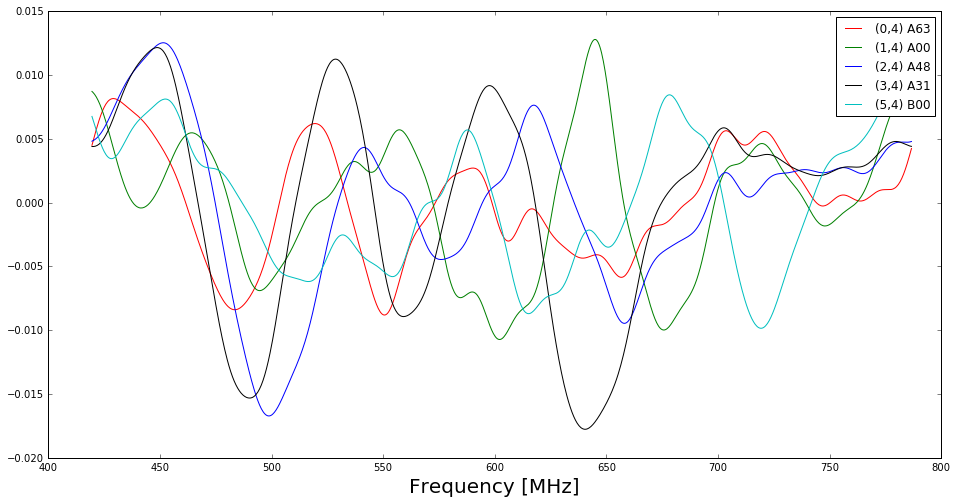

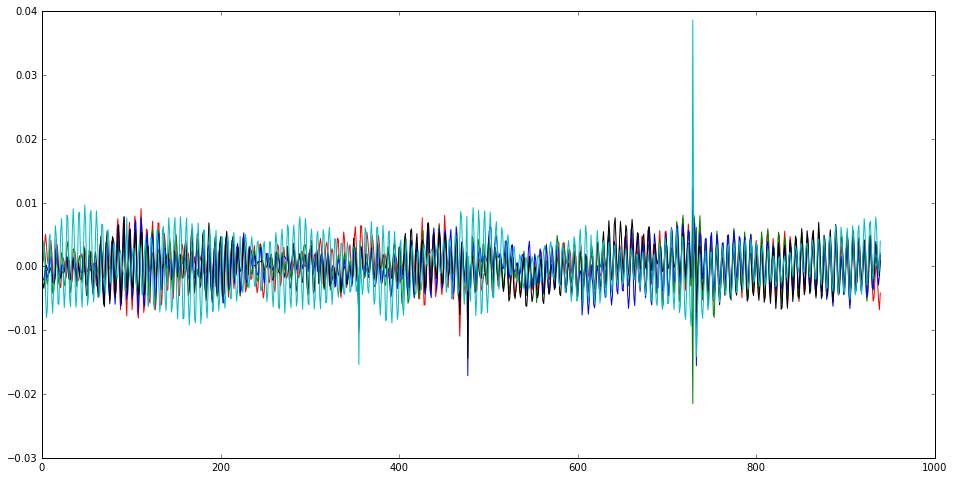

In [20]:
figure(figsize(16,8))

reflections_generate_all_cable=[]
reflections_generate_one_cable = np.zeros(len(gain_all[0,1,:]))


for k in range(len(corr_list)):
    
    z=np.polyfit(freq_phase[50:990], gain_all[0,k,:],1)
    p=np.poly1d(z)
    gain_line_sub = gain_all[0,k,:] - p(freq_phase[50:990])
    
    
    reflections_generate_one_cable = np.zeros(len(gain_all[0,1,:]))
    #print(np.int(len(parameters_all_cables[k][i])))
    for i in range(np.int(len(parameters_all_cables[k]))):
        reflections_generate_one_cable = reflections_generate_one_cable + my_sin(term2, *parameters_all_cables[k][i][:])
    
    reflections_generate_all_cable.append(reflections_generate_one_cable)
    plt.figure(1)
    plt.plot(freq_phase[50:990],reflections_generate_one_cable, color=colors[k], label = legend_crosscorr[k])
    plt.title('')
    plt.xlabel('Frequency [MHz]', size=20)
    plt.legend()
    
    plt.figure(2)
    plt.plot(gain_line_sub-reflections_generate_one_cable, color=colors[k])
    #plt.ylim(-0.005,0.005)

# Reflections due to short cables only

0


NameError: name 'gain_all_line_sub' is not defined

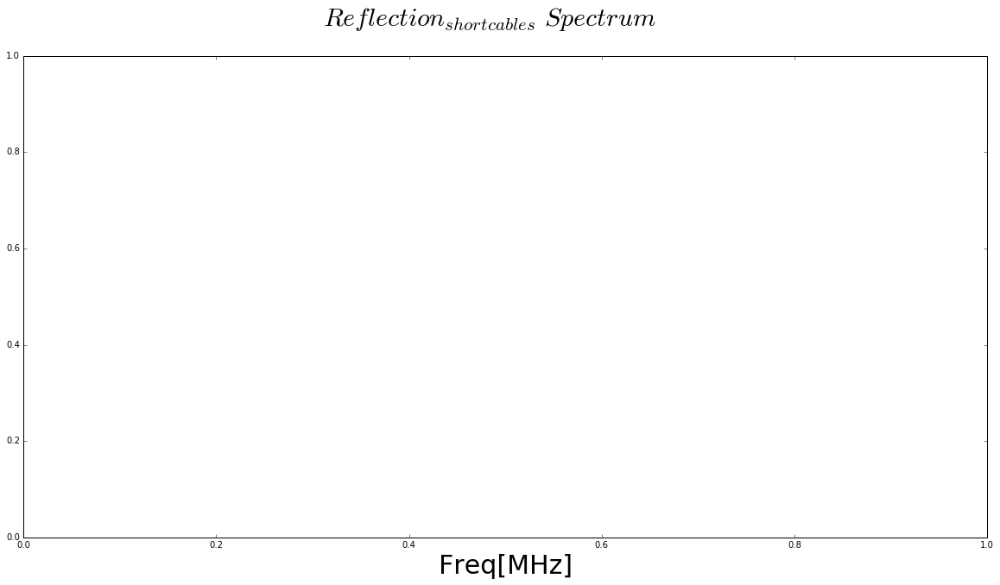

In [29]:
value_all_600 =[]
reflections_ref_val_600 = []

for i in range(len(corr_list)):
    value_all_600.append([])
    reflections_ref_val_600.append([])

figure(figsize(20,10))    
plt.suptitle('$Reflection_{short cables}$ $Spectrum$', size=30)
plt.xlabel('Freq[MHz]', size=30)

for k in range(len(corr_list)):
    print(k)
    value_all_600[k] = np.zeros((800,len(freq_phase[50:990])))
    fft_reflections_ref=[]
    
    for ii in range(800):
        components=[]
        amplitude =[]
        z=np.polyfit(freq_phase[50:990], gain_all[ii,k,:],1)
        p=np.poly1d(z)
        gain_line_sub = gain_all[ii,k,:] - p(freq_phase[50:990])
        gain_all_line_sub.append(gain_line_sub)

        ifft_component = (np.fft.ifft(gain_line_sub))  
        ifft_component0 = (np.fft.ifft(gain_line_sub) )
        end = len(ifft_component)
      
        for i in range(end):
            if (i<9) or (i>931):
                components.append(i)
                amplitude.append(np.abs(ifft_component[i]))
        
        for i in range(len(ifft_component)):
            if i not in components: 
                ifft_component0[i] = 0
        
        fft_reflections = np.fft.fft(ifft_component0) 
        if ii==0:
            fft_reflections_ref = fft_reflections
        
        for kk in range(len(freq_phase[50:990])):
            value_all_600[k][ii][kk] = abs(fft_reflections[kk]) - abs(fft_reflections_ref[kk])
            if kk == freq:
                reflections_ref_val_600[k] = fft_reflections_ref[kk]
    
        #plt.figure(k+1)
        plt.subplot(4,2,k+1)
        plt.plot(freq_phase[50:990],(fft_reflections), color=colors[k])
        #plt.title('Reflection Spectrum [Short cables] %s' %(legend_crosscorr[k]), size=20)
        #lt.xlabel('Freq [MHz]', size=20)


0


C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\ipykernel\__main__.py:45: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\numpy\core\numeric.py:482: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


1
2
3
4
5
6


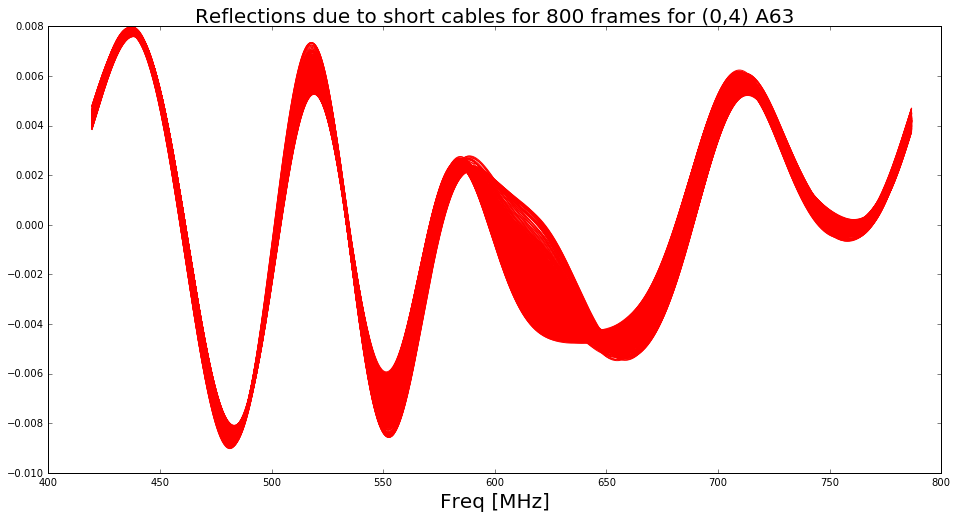

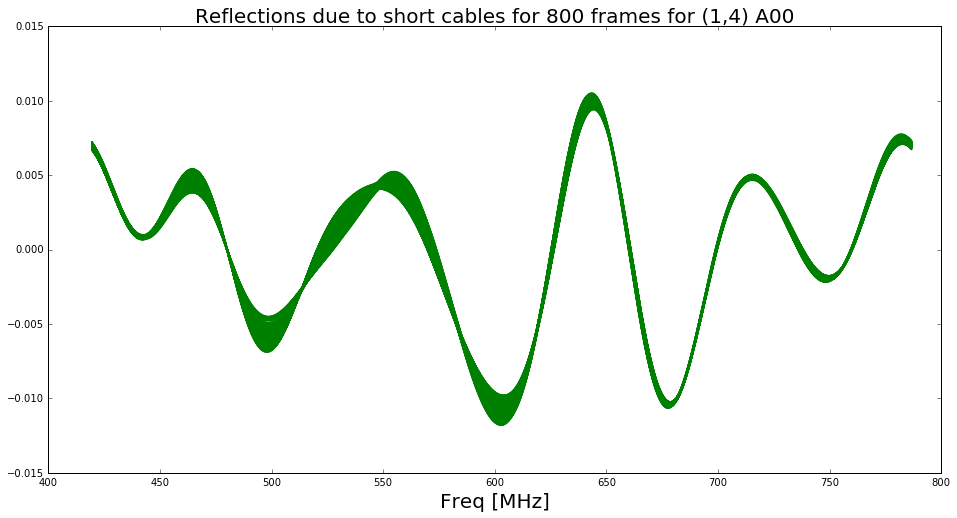

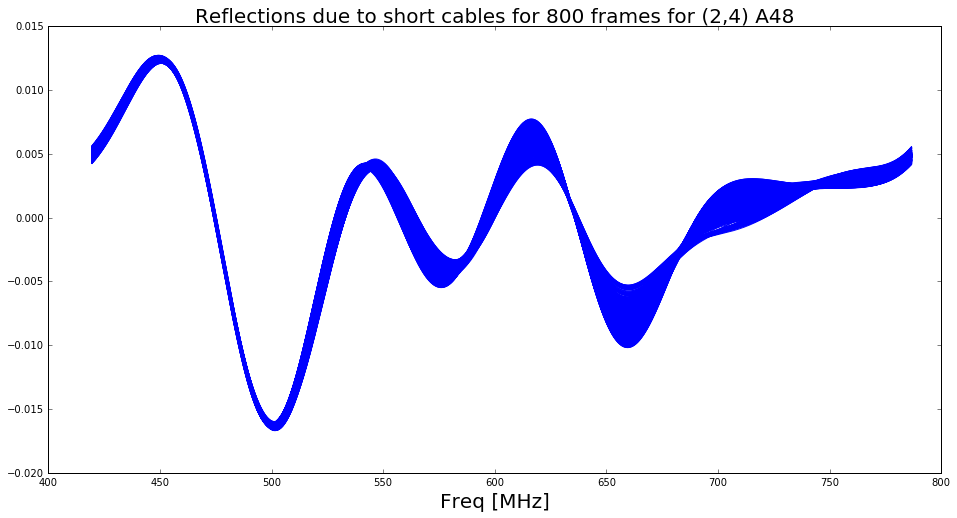

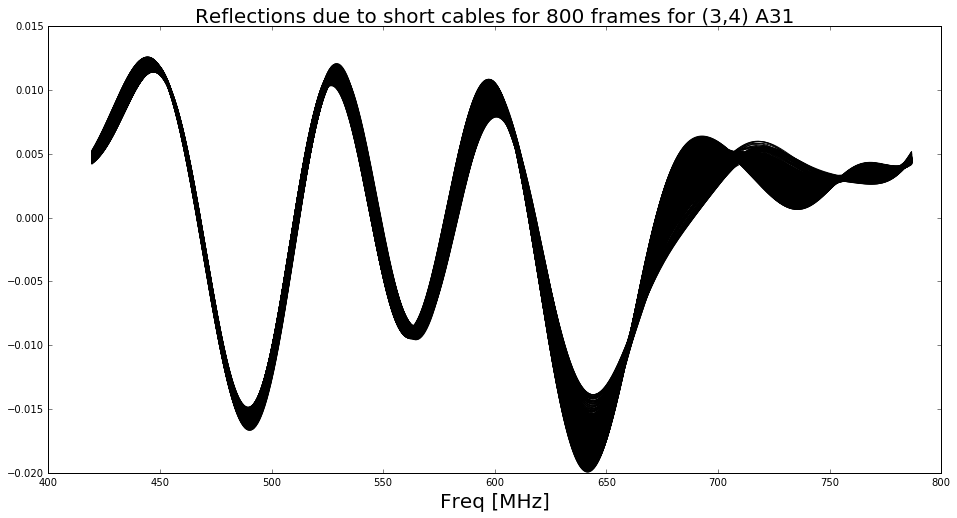

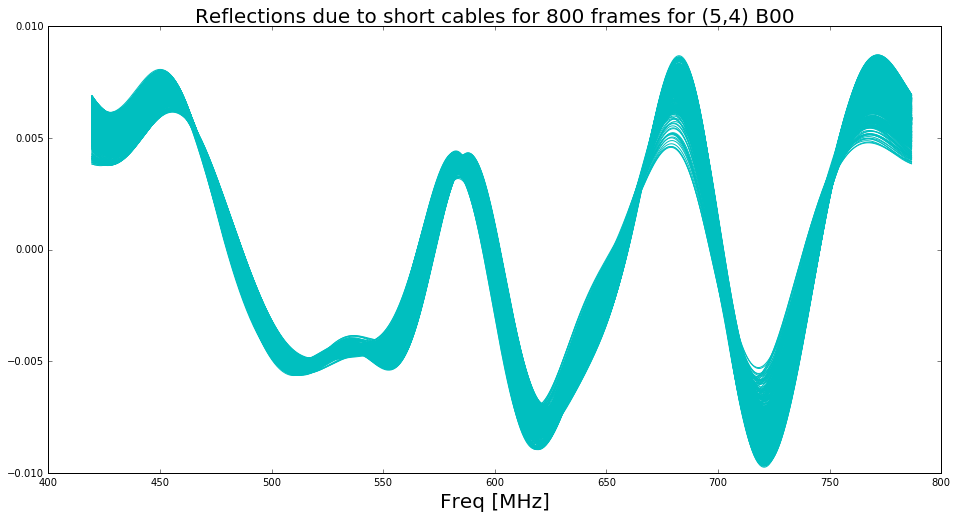

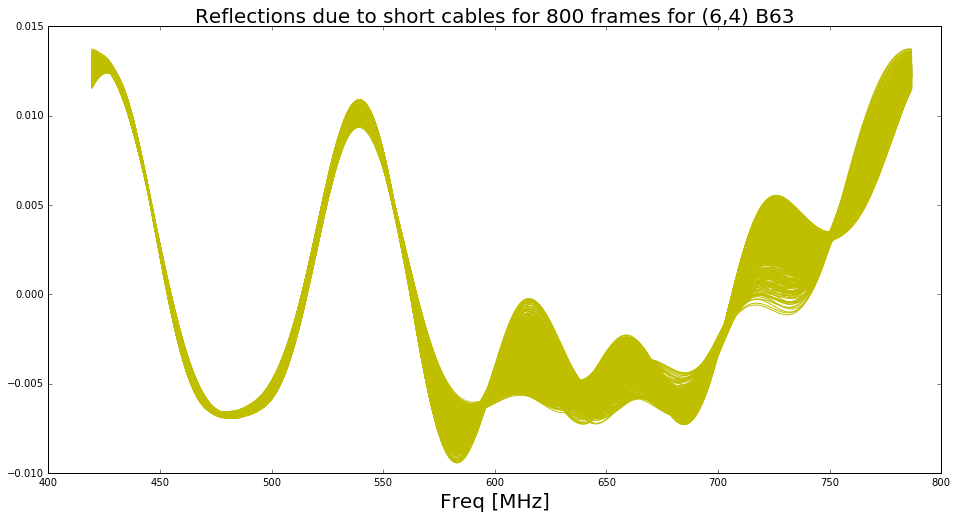

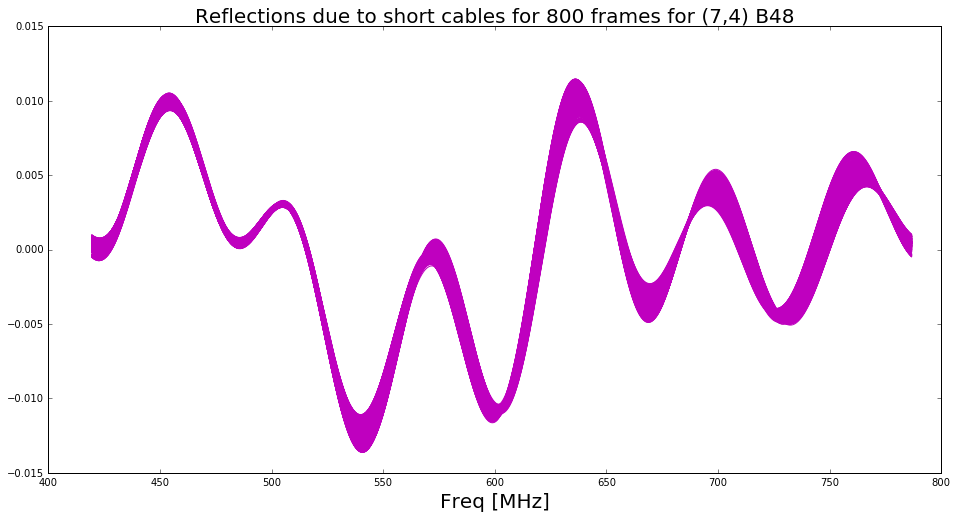

In [21]:
value_all_600 =[]
reflections_ref_val_600 = []

for i in range(len(corr_list)):
    value_all_600.append([])
    reflections_ref_val_600.append([])

for k in range(len(corr_list)):
    print(k)
    value_all_600[k] = np.zeros((800,len(freq_phase[50:990])))
    fft_reflections_ref=[]
    
    for ii in range(800):
        components=[]
        amplitude =[]
        z=np.polyfit(freq_phase[50:990], gain_all[ii,k,:],1)
        p=np.poly1d(z)
        gain_line_sub = gain_all[ii,k,:] - p(freq_phase[50:990])
        gain_all_line_sub.append(gain_line_sub)

        ifft_component = np.fft.ifft(gain_line_sub)  
        ifft_component0 = np.fft.ifft(gain_line_sub) 
        end = len(ifft_component)
        '''
        for i in range(end):
            if np.abs(ifft_component[i]) > 18*np.mean(np.abs(ifft_component)):#-np.mean(np.abs(ifft_component))/2:
                components.append(i)
                amplitude.append(np.abs(ifft_component[i]))
        '''        
        for i in range(end):
            if (i<7) or (i>931):
            #if (i<21) or (i>917):
                components.append(i)
                amplitude.append(np.abs(ifft_component[i]))
        
        for i in range(len(ifft_component)):
            if i not in components: 
                ifft_component0[i] = 0
        
        fft_reflections = np.fft.fft(ifft_component0) 
        if ii==0:
            fft_reflections_ref = fft_reflections
        
        for kk in range(len(freq_phase[50:990])):
            value_all_600[k][ii][kk] = fft_reflections[kk] - fft_reflections_ref[kk]
            if kk == freq:
                reflections_ref_val_600[k] = fft_reflections_ref[kk]
    
        plt.figure(k+1)
        plt.plot(freq_phase[50:990],fft_reflections, color=colors[k])
        plt.title('Reflections due to short cables for 800 frames for %s' %(legend_crosscorr[k]), size=20)
        plt.xlabel('Freq [MHz]', size=20)
    #plt.savefig('reflection_short cables %s.png' %(legend_crosscorr[k]))
    

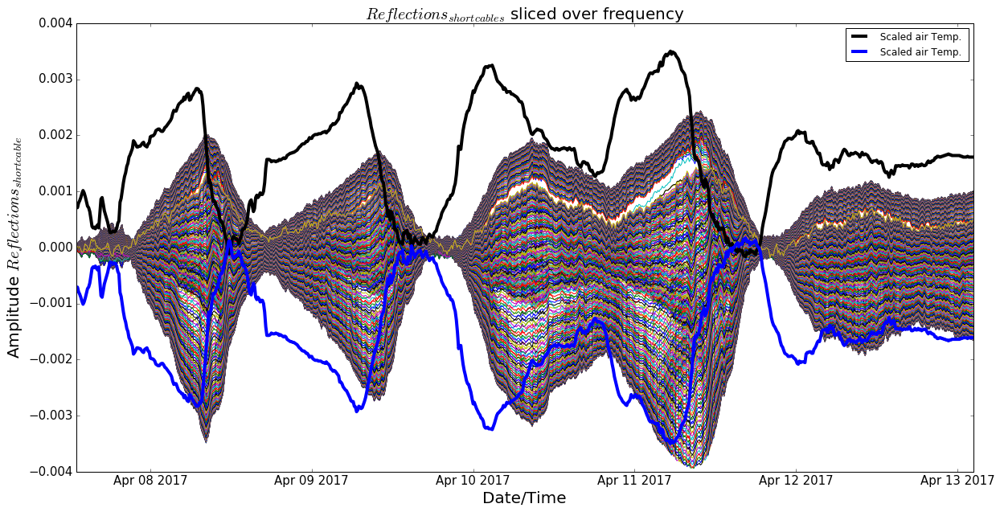

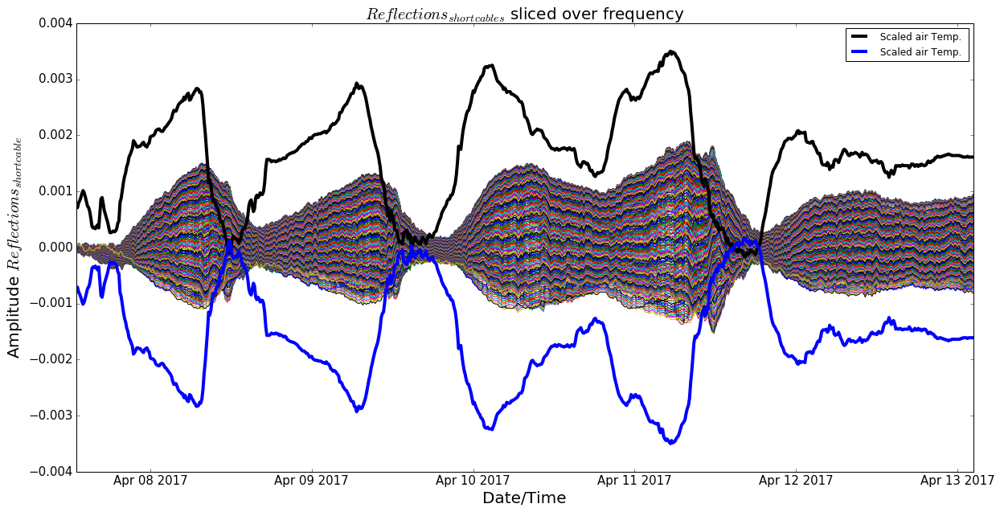

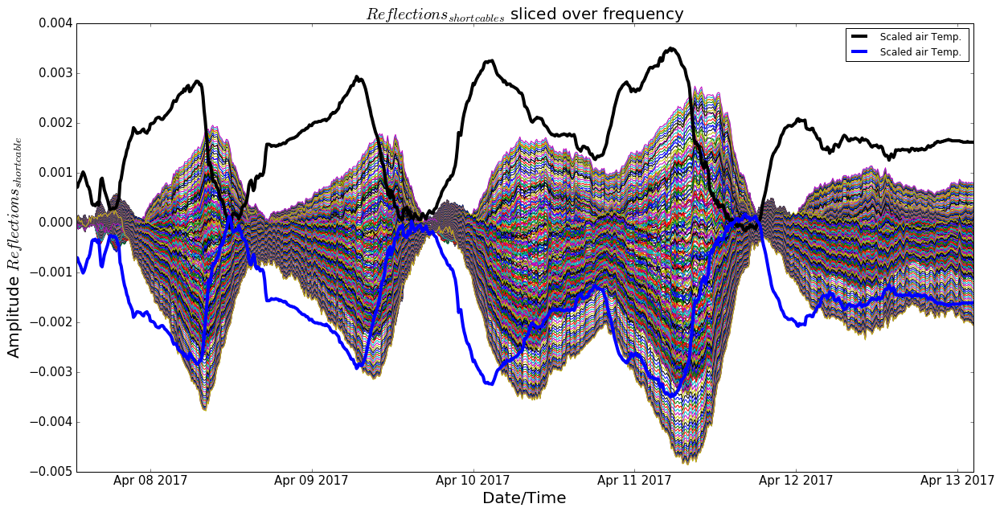

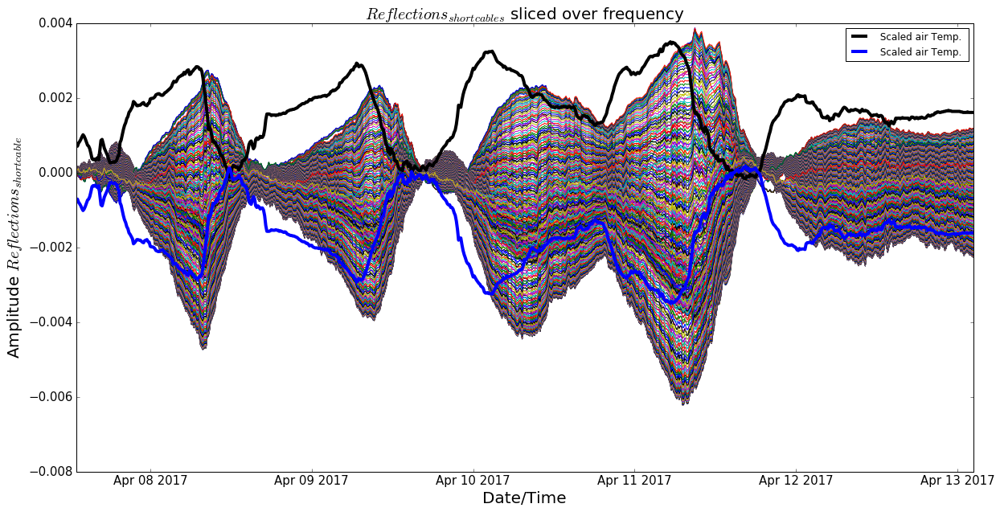

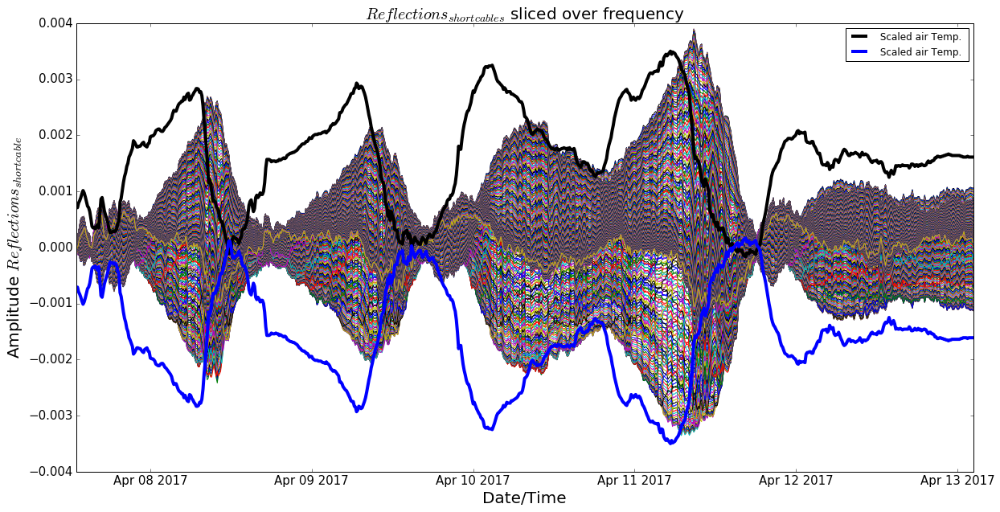

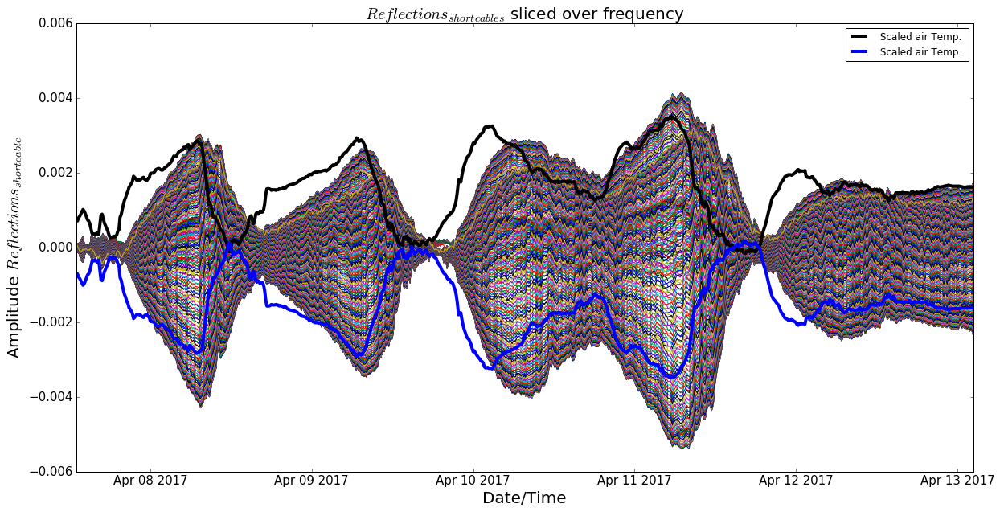

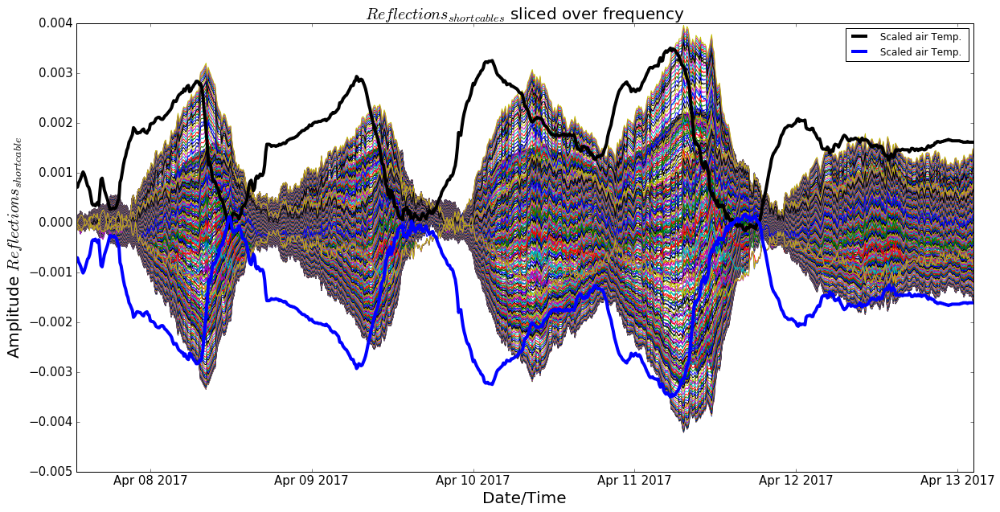

In [91]:
for k in range(len(corr_list)):
    for i in range(len(freq_phase[690:990])):
        plt.figure(k+1)
        plt.plot(date_stamp[0:800],(value_all_600[k][:,freq-150+i]))
    plt.plot(time_intercept_model[0:800],-(2*((temp_intercept_model[0:800]+273)/8000 -0.057)+0.006+0.04)+0.003, 'k',linewidth =4,label= ' Scaled air Temp.')   
    plt.plot(time_intercept_model[0:800],-(-(2*((temp_intercept_model[0:800]+273)/8000 -0.057)+0.006+0.04)+0.003), 'b',linewidth =4,label= ' Scaled air Temp. ')
    #plt.title('Reflections: Short Cables sliced over frequency: Reflection(t)- Reflection(ref) %s' %(legend_crosscorr[k]), size=20) 
    plt.title('$Reflections_{short cables}$ sliced over frequency', size=20)
    plt.ylabel('Amplitude $Reflections_{short cable}$',size=20)
    plt.xlabel('Date/Time', size=20)
    plt.yticks( fontsize = 15)
    plt.xticks( fontsize = 15)
    plt.legend()
    #plt.savefig('diff_reflection_short cables %s.png' %(legend_crosscorr[k]))

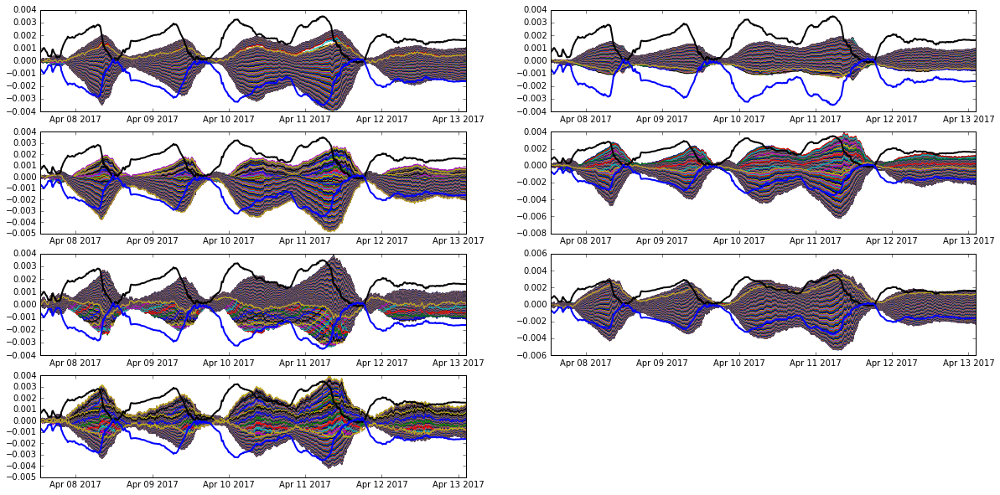

In [94]:
figure(figsize(20,10))    
plt.title('$Reflections_{short cables}$ sliced over frequency', size=30)
for k in range(len(corr_list)):
    plt.subplot(4,2,k+1)
    for i in range(len(freq_phase[690:990])):
        plt.plot(date_stamp[0:800],(value_all_600[k][:,freq-150+i]))
    plt.plot(time_intercept_model[0:800],-(2*((temp_intercept_model[0:800]+273)/8000 -0.057)+0.006+0.04)+0.003, 'k',linewidth =2,label= ' Scaled air Temp.')   
    plt.plot(time_intercept_model[0:800],-(-(2*((temp_intercept_model[0:800]+273)/8000 -0.057)+0.006+0.04)+0.003), 'b',linewidth =2,label= ' Scaled air Temp. ')
    #plt.legend()

# Reflections due to long cables

0


C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\numpy\core\numeric.py:482: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


1
2
3
4
5
6


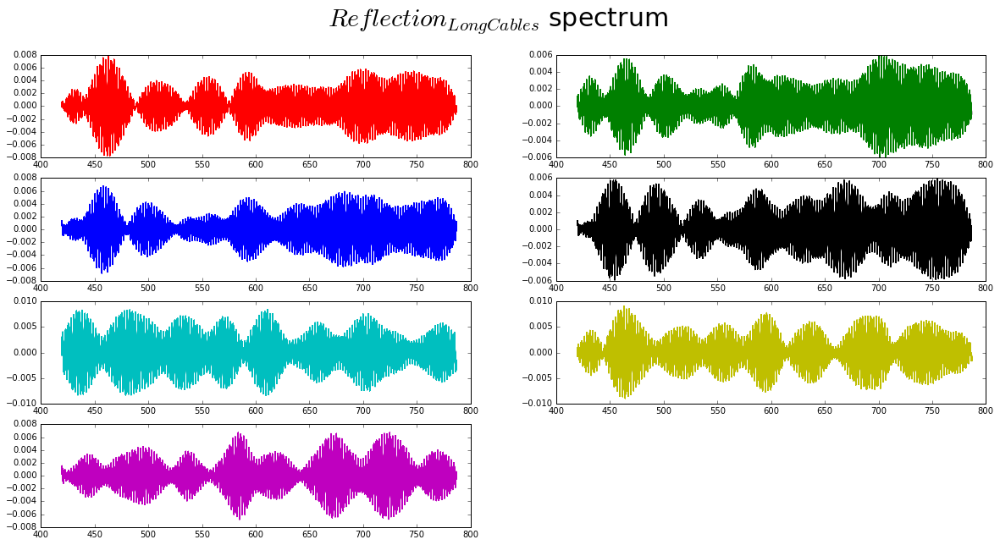

In [97]:
value_all_long_600 =[]
reflections_ref_long_val_600 = []

for i in range(len(corr_list)):
    value_all_long_600.append([])
    reflections_ref_long_val_600.append([])

figure(figsize(20,10))    
plt.suptitle('$Reflection_{Long Cables}$ spectrum', size=30)
plt.xlabel('Freq[MHz]', size=30)
for k in range(len(corr_list)):
    print(k)
    value_all_long_600[k] = np.zeros((800,len(freq_phase[50:990])))
    
    fft_reflections_ref=[]
    
    for ii in range(800):
        components=[]
        amplitude =[]
        z=np.polyfit(freq_phase[50:990], gain_all[ii,k,:],1)
        p=np.poly1d(z)
        gain_line_sub = gain_all[ii,k,:] - p(freq_phase[50:990])
        gain_all_line_sub.append(gain_line_sub)

        ifft_component = np.fft.ifft(gain_line_sub)  
        ifft_component0 = np.fft.ifft(gain_line_sub) 
        end = len(ifft_component)
      
        for i in range(end):
            if (i>134 and i<154) or (i>780 and i<810):
                components.append(i)
                amplitude.append(np.abs(ifft_component[i]))
        
        for i in range(len(ifft_component)):
            if i not in components: 
                ifft_component0[i] = 0
        
        fft_reflections = np.fft.fft(ifft_component0) 
        if ii==0:
            fft_reflections_ref = fft_reflections
        
        for kk in range(len(freq_phase[50:990])):
            value_all_long_600[k][ii][kk] = abs(fft_reflections[kk]) - abs(fft_reflections_ref[kk])
            if kk == freq:
                reflections_ref_long_val_600[k] = fft_reflections_ref[kk]
    
        #plt.figure(k+1)
        plt.subplot(4,2,k+1)
        plt.plot(freq_phase[50:990],fft_reflections, color=colors[k])
        #plt.title('$Reflections_{Long Cables}$, 800 frames %s' %(legend_crosscorr[k]), size=20)
        #plt.xlabel('$Freq [MHz]$', size=20)

    

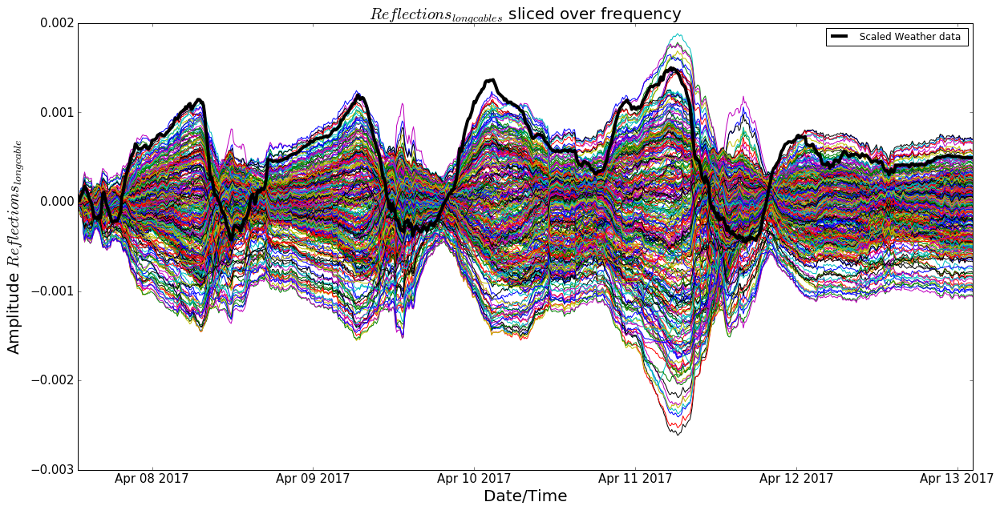

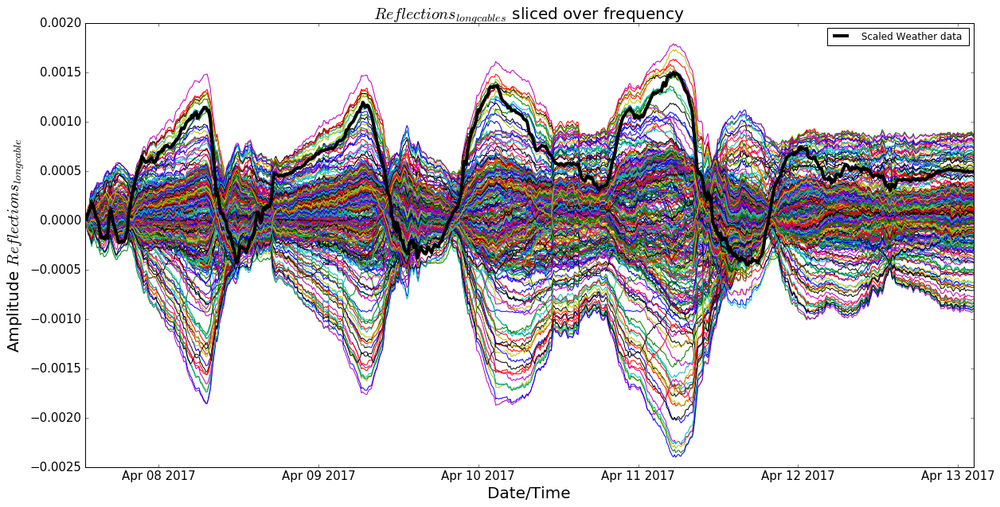

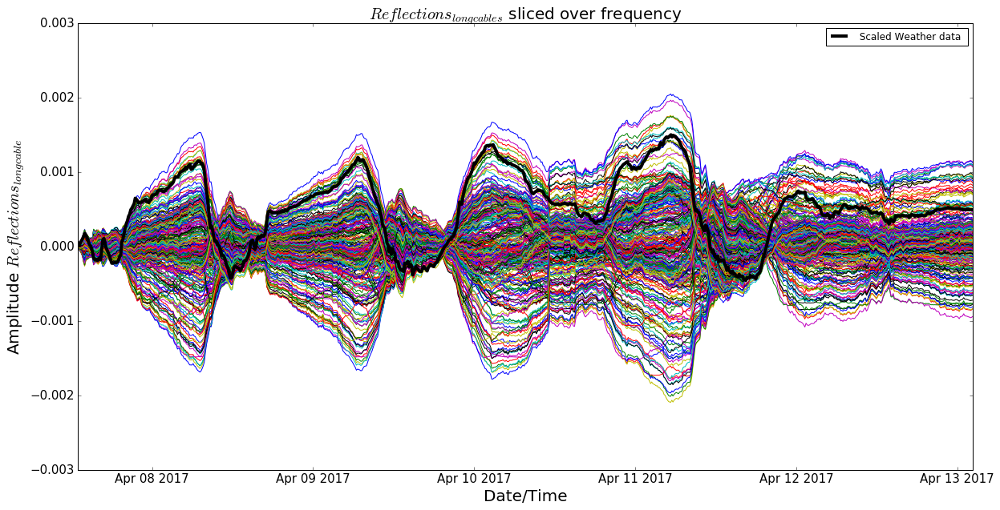

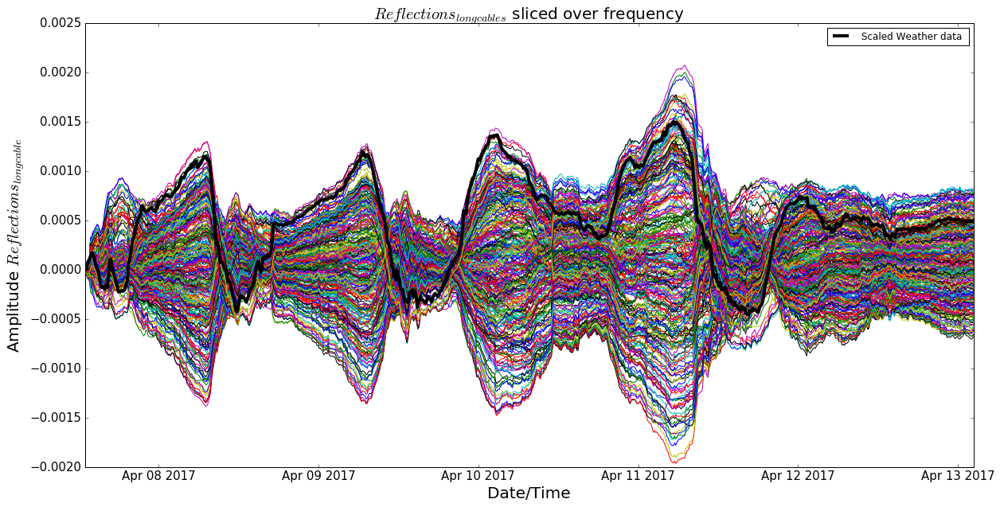

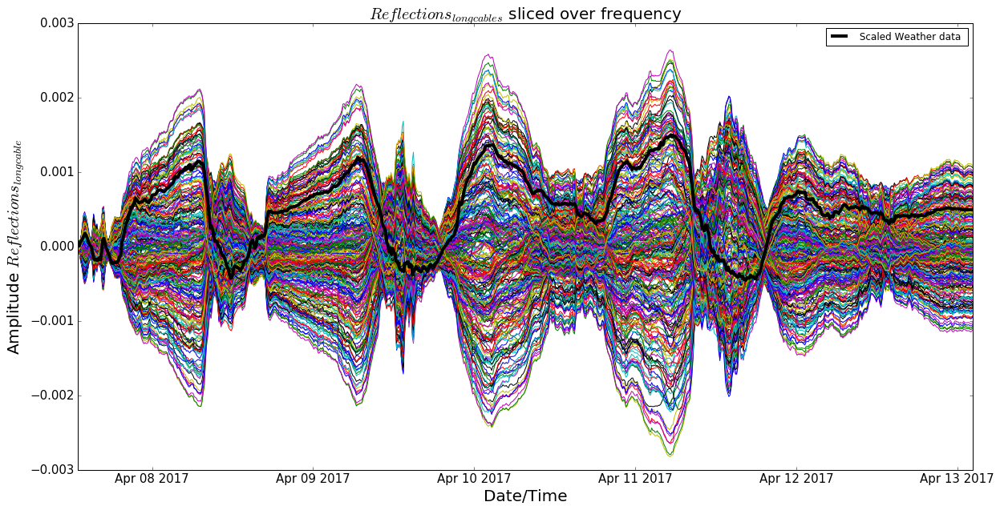

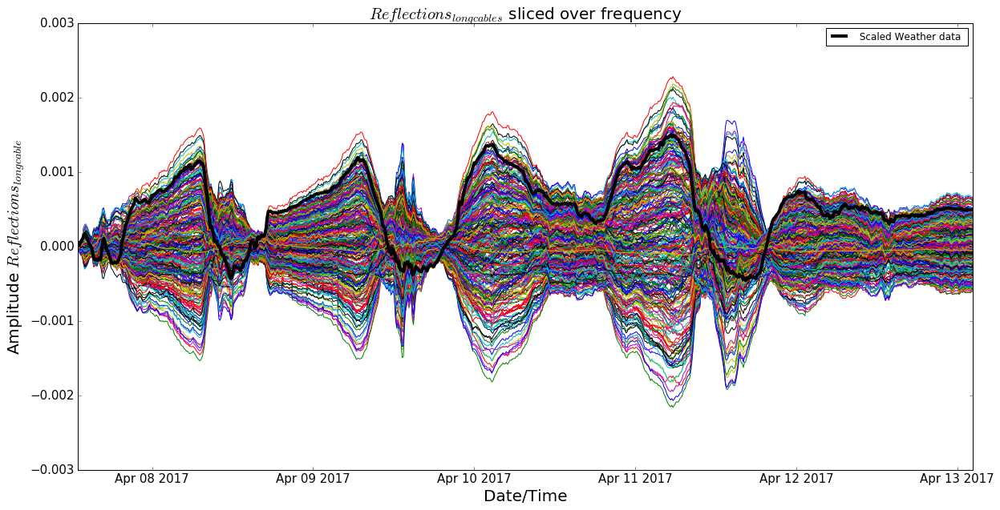

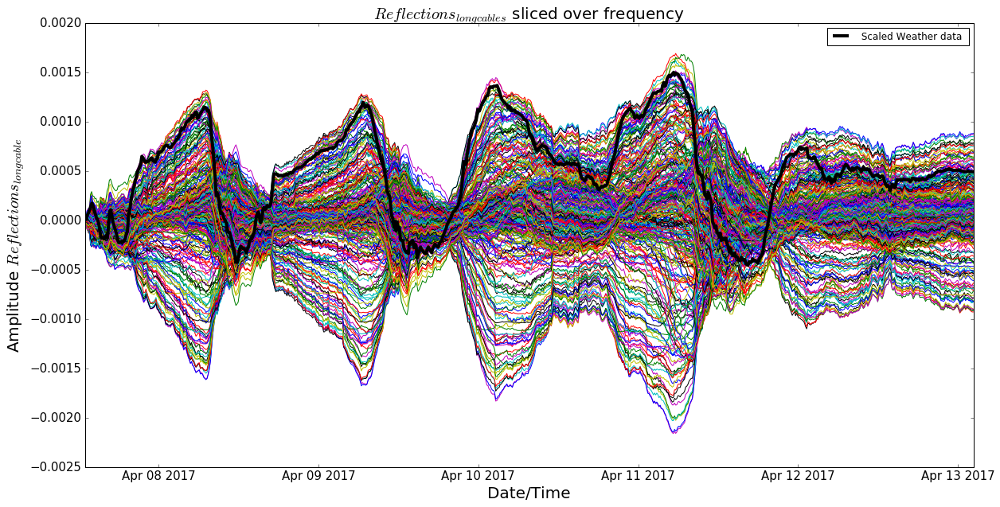

In [99]:
for k in range(len(corr_list)):
    for i in range(len(freq_phase[690:990])):
        plt.figure(k+1)
        plt.plot(date_stamp[0:800],value_all_long_600[k][:,freq-150+i])
    plt.plot(time_intercept_model[0:800],(-2*(temp_intercept_model[0:800]+273)/15000 +0.0375), 'k',linewidth =4,label= ' Scaled Weather data ')   
    #plt.plot(time_intercept_model[0:800],(-(2*((temp_intercept_model[0:800]+273)/15000 -0.057)+0.006+0.04)+0.003)-0.015-0.02, 'k',linewidth =4,label= ' Scaled Weather data ')   
    #plt.plot(time_intercept_model[0:800],-((-(2*((temp_intercept_model[0:800]+273)/15000 -0.057)+0.006+0.04)+0.003)-0.015-0.02), 'b',linewidth =4,label= ' Scaled Weather data ')
    plt.title('$Reflections_{long cables}$ sliced over frequency', size=20)
    plt.ylabel('Amplitude $Reflections_{long cable}$',size=20)
    plt.xlabel('Date/Time', size=20)
    plt.yticks( fontsize = 15)
    plt.xticks( fontsize = 15)
    plt.legend()

In [26]:
print(time_intercept_model[0])
print(date_stamp[0])
print(freq_phase[freq+42])
print(len(value_all_long_600[k][:,freq]))

2017-04-07 13:00:00
2017-04-07 12:57:21
597.06744868
800


0
1
2
3
4
5
6


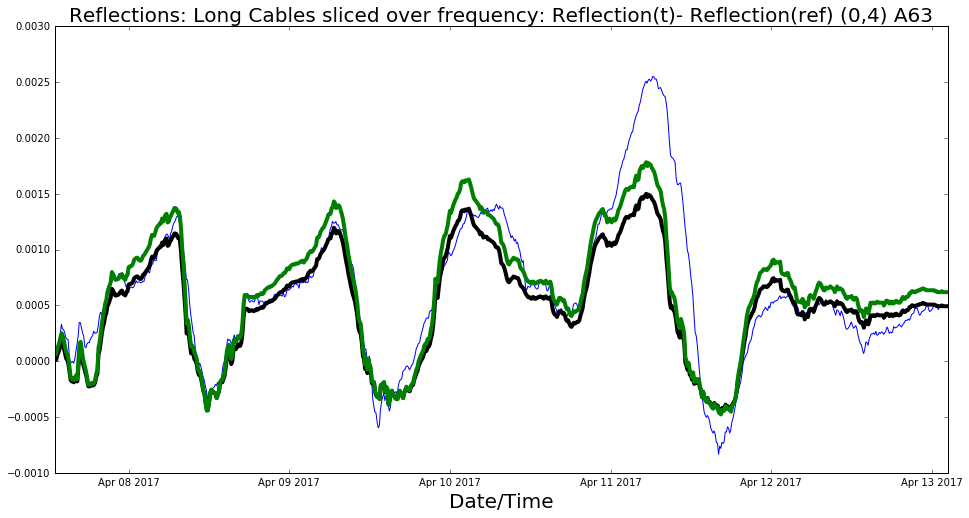

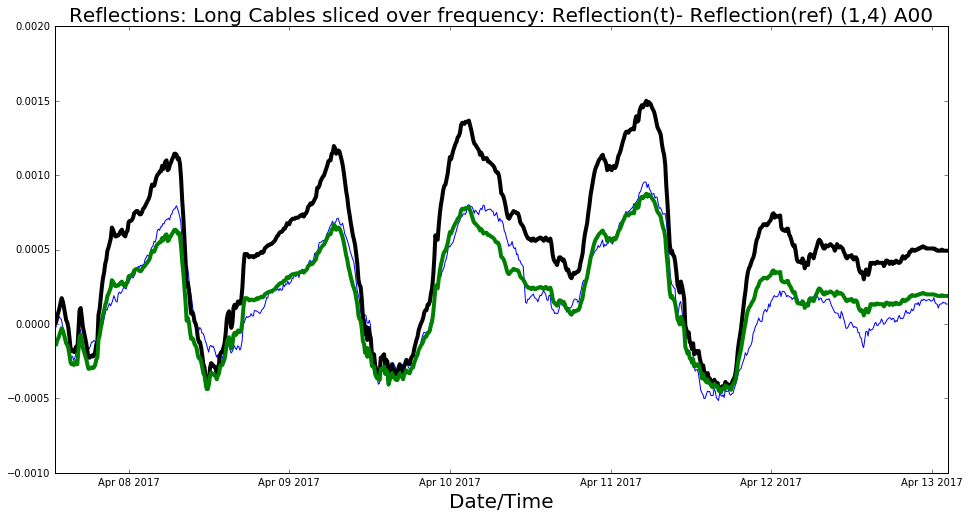

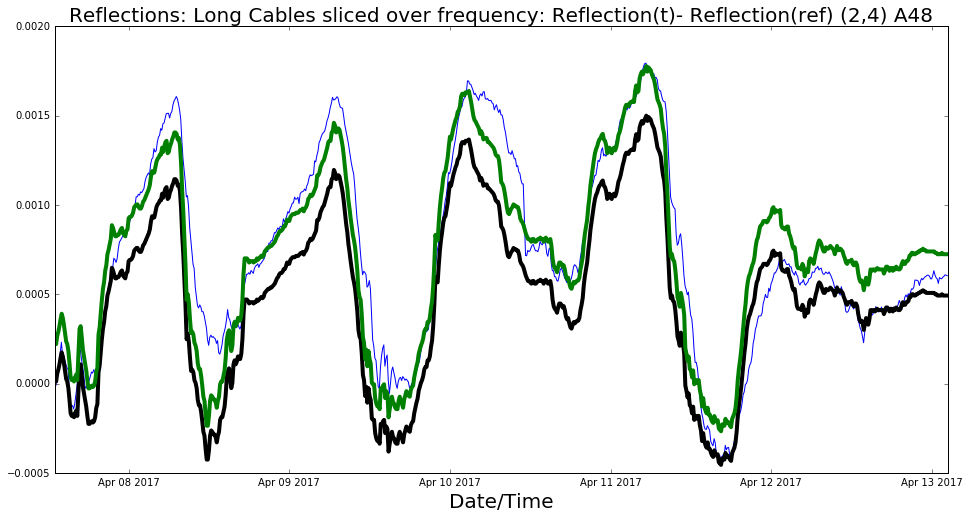

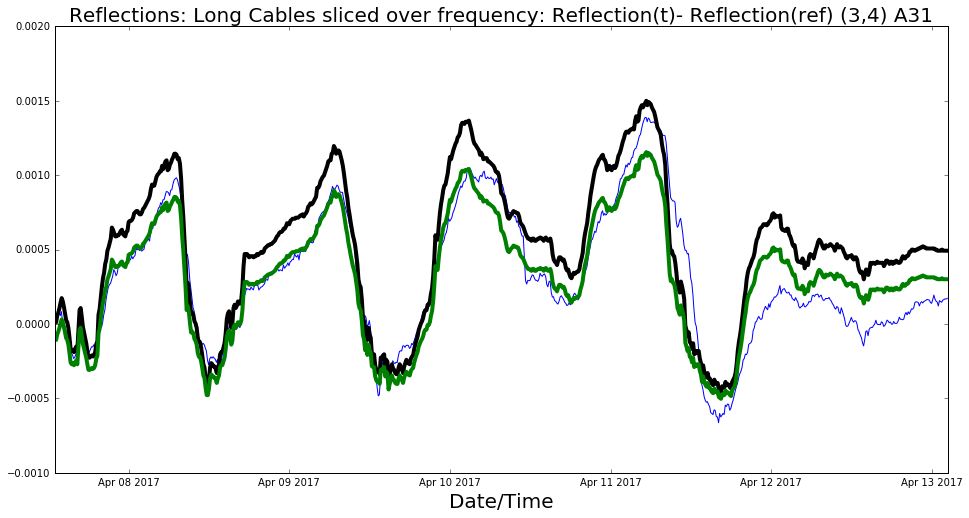

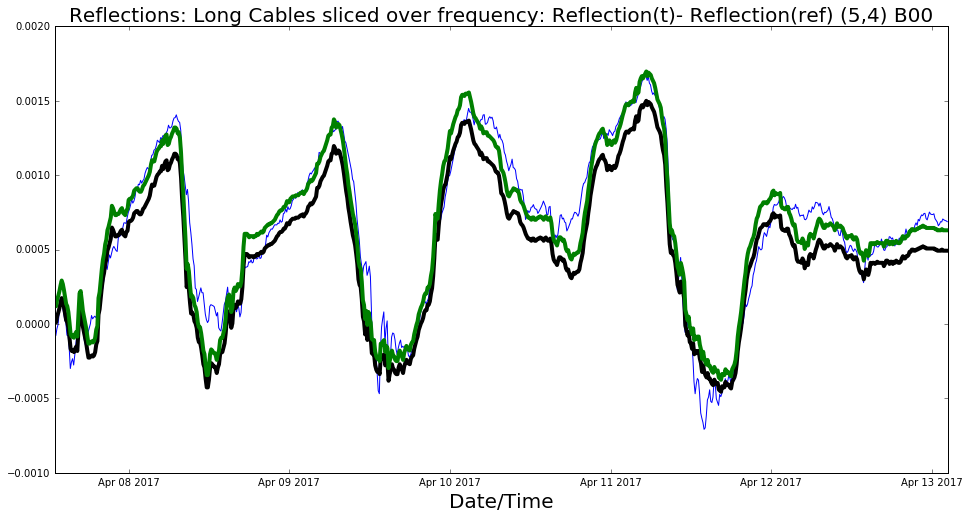

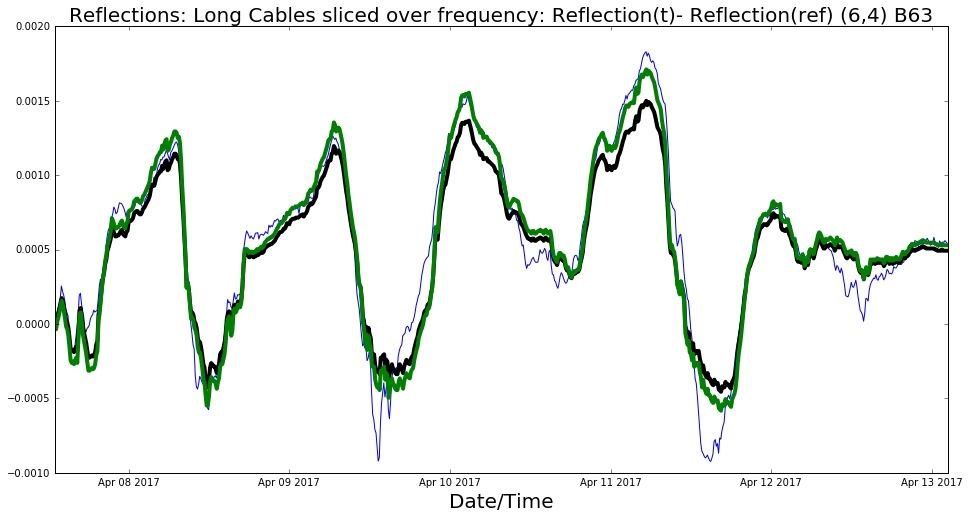

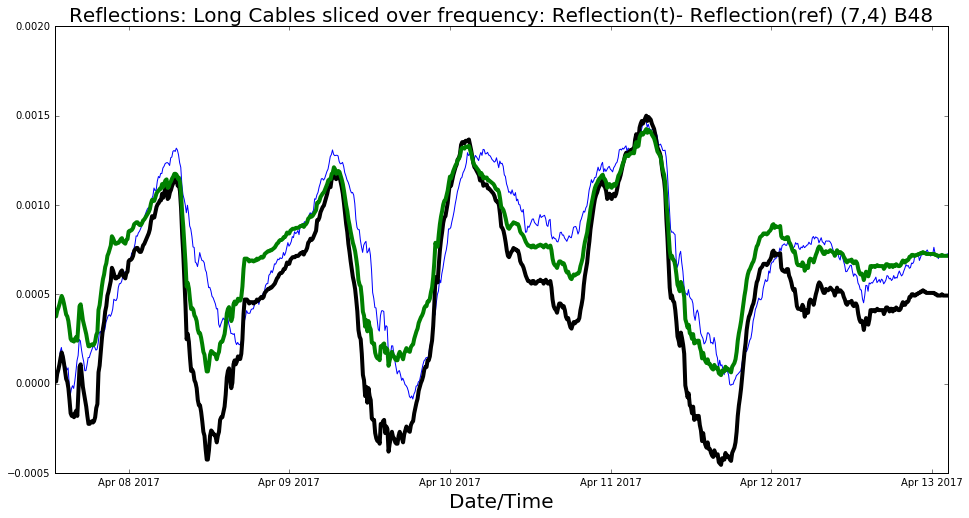

In [27]:
import scipy.optimize as optimization
from scipy.optimize import curve_fit
def func(T,a,b,c):
    return a*(T/b) + c

for k in range(len(corr_list)):
    print(k)
    
    plt.figure(k+1)
    plt.plot(date_stamp[0:800],value_all_long_600[k][:,freq])
    x0 = [-2,15000,0.0375]
    best_vals, covar = curve_fit(func, (temp_intercept_model[0:800]+273), value_all_long_600[k][:,freq], p0 = x0)
    plt.plot(time_intercept_model[0:800],(-2*(temp_intercept_model[0:800]+273)/15000 +0.0375), 'k',linewidth =4) 
    plt.plot(time_intercept_model[0:800],func(temp_intercept_model[0:800]+273,best_vals[0],best_vals[1],best_vals[2]),'g',linewidth =4)
    plt.title('Reflections: Long Cables sliced over frequency: Reflection(t)- Reflection(ref) %s' %(legend_crosscorr[k]), size=20) 
    plt.xlabel('Date/Time', size=20)              

In [29]:
import scipy.optimize as optimization
from scipy.optimize import curve_fit
def func(T,a,b,c):
    return a*(T/b) + c

C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\matplotlib\axes\_axes.py:519: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


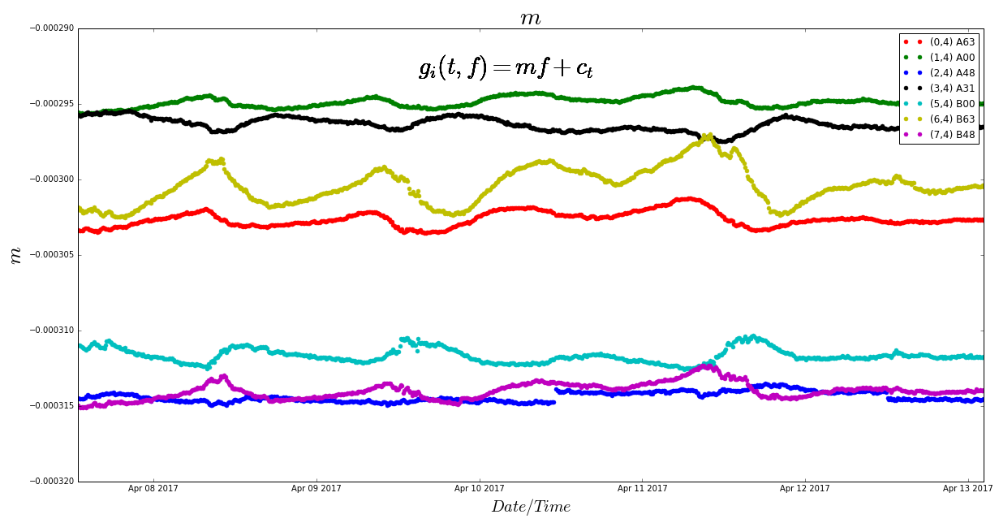

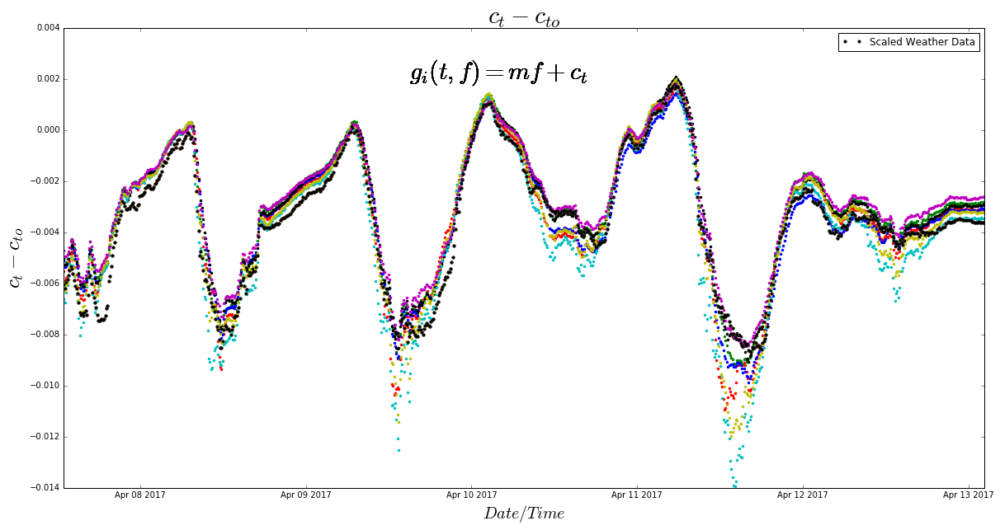

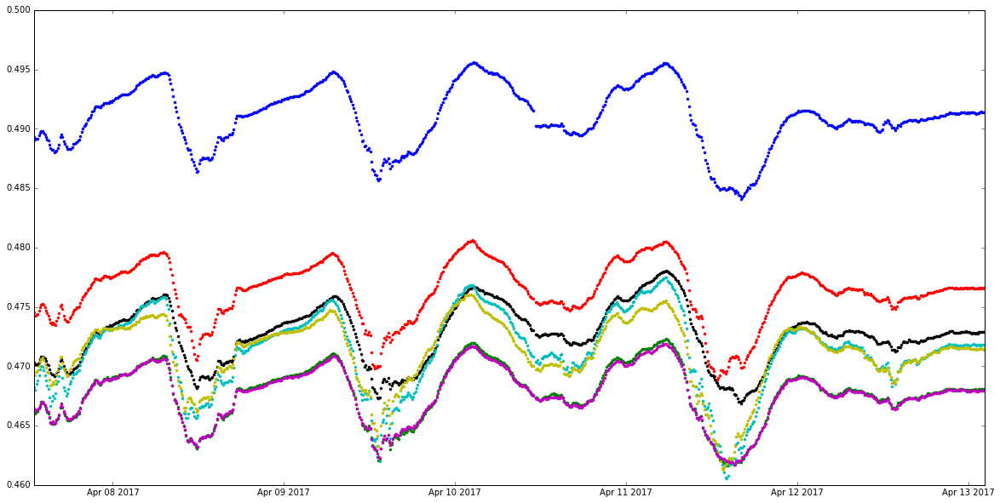

In [116]:
# not doing any curve fit
size=800 

for i in range(len(corr_list)):
    
    slope_all =np.zeros(len(gain_all[0:size,1,freq]))
    slope_all_wo_ref =np.zeros(len(gain_all[0:size,1,freq]))
    intercept_all_wo_ref =np.zeros(len(gain_all[0:size,1,freq]))
    intercept_all =np.zeros(len(gain_all[0:size,1,freq]))
    
    for j in range(size):
        slope,intercept=np.polyfit(freq_phase[50:990]-freq_phase[freq], gain_all[j,i,:],1)
        slope_all[j] = slope
        intercept_all[j] = intercept
        
        slope,intercept=np.polyfit(freq_phase[50:990], gain_all[j,i,:],1)
        slope_all_wo_ref[j] = slope
        intercept_all_wo_ref[j] = intercept
        
    
    plt.figure(1)
    #plt.title('Slope of linear fit to Raw Gain(Linear Scale) multiplied by 450', size=20)
    plt.title(r'$m$ ', size=30)
    plt.text(date_stamp[300], -0.000293, r'$g_i(t,f) = m f+c_t $ ' , fontsize=30)
    plt.ylabel(r'$m$ ', size=25)
    plt.xlabel('$Date/Time$', size=20)
    #plt.ylabel('Scaled Slope', size=20)
    plt.plot(date_stamp[0:800],slope_all, '.', markersize =10, color=colors[i], label = legend_crosscorr[i])
    #plt.ylim(-0.145,-0.125)
    plt.legend()
    #plt.axvline(x=580+30)
    #plt.axvline(x=580-20)
    
    plt.figure(2)
    if i==1: 
        plt.plot(date_stamp[0:800],-(temp_intercept_model[0:size]+235)/1400 +0.235-0.019-0.0205-0.015-0.013,'.k',markersize=7, label ='Scaled Weather Data')
    plt.title('$c_t - c_{to}$', size=30)
    plt.text(date_stamp[300], 0.002, r'$g_i(t,f) = m f+c_t $ ' , fontsize=30)
    #plt.title('Scaled Intercept - Intercept [frame=100] of linear fit to raw Gain (Linear scale) & Weather Data', size=15)
    plt.plot(date_stamp[0:800],intercept_all-intercept_all[100], '.', color=colors[i])
    plt.plot(date_stamp[0:800],-(temp_intercept_model[0:size]+235)/1400 +0.235-0.019-0.0205-0.015-0.013,'.')
    plt.xlabel('$Date/Time$', size=20)
    plt.ylabel('$c_t - c_{to}$', size=25)
    plt.legend()
    #plt.plot(-temp_weather_data/1400-.001, '.')

    plt.figure(3)
    plt.plot(date_stamp[0:800],intercept_all_wo_ref, '.', color=colors[i])

In [31]:
'''
# not working on model for slope because the change in value of slope is very small

size=800 #len(gain_all[:,1,freq])#1250#421
slope_parameters=[]
intercept_parameters=[]

slope_all_wo_ref=[]
intercept_all_wo_ref=[]

slope_all_wo_ref=[] # I might use them
intercept_all_wo_ref=[] # i might use them

for i in range(len(corr_list)):
    slope_parameters.append([])
    intercept_parameters.append([])
    slope_all_wo_ref.append([])
    intercept_all_wo_ref.append([])
    
for i in range(len(corr_list)):
    slope_all_wo_ref[i] =np.zeros(len(gain_all[0:size,1,freq]))
    intercept_all_wo_ref[i] =np.zeros(len(gain_all[0:size,1,freq]))
    
    for j in range(size):
        slope,intercept=np.polyfit(freq_phase[50:990], gain_all[j,i,:],1)
        slope_all_wo_ref[i][j] = slope
        intercept_all_wo_ref[i][j] = intercept
        
    x0 = [-2,15000,0.0375]
    best_vals_intercept, covar = curve_fit(func, (temp_intercept_model[0:800]+273), intercept_all_wo_ref[i], p0 = x0)
    best_vals_slope, covar_slope = curve_fit(func, (temp_intercept_model[0:800]+273), slope_all_wo_ref[i], p0 = x0)
    intercept_parameters[i] = best_vals_intercept
    
    slope_parameters[i] =  best_vals_slope#np.mean(slope_all_wo_ref)
'''
# Curve fit for linear fit model

size=800 
slope_parameters=[]
intercept_parameters=[]
slope_all_wo_ref=[]
intercept_all_wo_ref=[]

for i in range(len(corr_list)):
    slope_parameters.append([])
    intercept_parameters.append([])
    slope_all_wo_ref.append([])
    intercept_all_wo_ref.append([])
    
for i in range(len(corr_list)):
    slope_all_wo_ref[i] =np.zeros(len(gain_all[0:size,1,freq]))
    intercept_all_wo_ref[i] =np.zeros(len(gain_all[0:size,1,freq]))
    intercept_all =np.zeros(len(gain_all[0:size,1,freq]))
    
    for j in range(size):
        slope,intercept=np.polyfit(freq_phase[50:990], gain_all[j,i,:],1)
        slope_all_wo_ref[i][j] = slope
        intercept_all_wo_ref[i][j] = intercept
        
    x0 = [-2,15000,0.0375]
    best_vals, covar = curve_fit(func, (temp_intercept_model[0:800]+273), intercept_all_wo_ref[i], p0 = x0)
    best_vals_slope, covar_slope = curve_fit(func, (temp_intercept_model[0:800]+273), slope_all_wo_ref[i], p0 = x0)
    intercept_parameters[i] = best_vals
    
    slope_parameters[i] =  best_vals_slope#np.mean(slope_all_wo_ref)


In [32]:
freq_phase_model = freq_phase[50:990]

gain_linear_model_600=[]
gain_linear_raw_600=[]

for i in range(len(corr_list)):
    gain_linear_model_600.append([])
    gain_linear_raw_600.append([])
    
for i in range(len(corr_list)):
    gain_linear_model_600[i]= np.zeros(size)
    gain_linear_raw_600[i]= np.zeros(size)
    
    for k in range(size):
        #gain_linear_model_600[i][k] = slope_parameters[i]*freq_phase_model[freq] + func(temp_intercept_model[k]+273,intercept_parameters[i][0], intercept_parameters[i][1], intercept_parameters[i][2])
        gain_linear_model_600[i][k] = func(temp_intercept_model[k]+273,slope_parameters[i][0], slope_parameters[i][1], slope_parameters[i][2])*freq_phase_model[freq] + func(temp_intercept_model[k]+273,intercept_parameters[i][0], intercept_parameters[i][1], intercept_parameters[i][2])
        gain_raw = gain_all[k,i,:]
        z=np.polyfit(freq_phase[50:990], gain_raw,1)
        p=np.poly1d(z)
        gain_raw_all = p(freq_phase[50:990])
        gain_linear_raw_600[i][k] = gain_raw_all[freq]

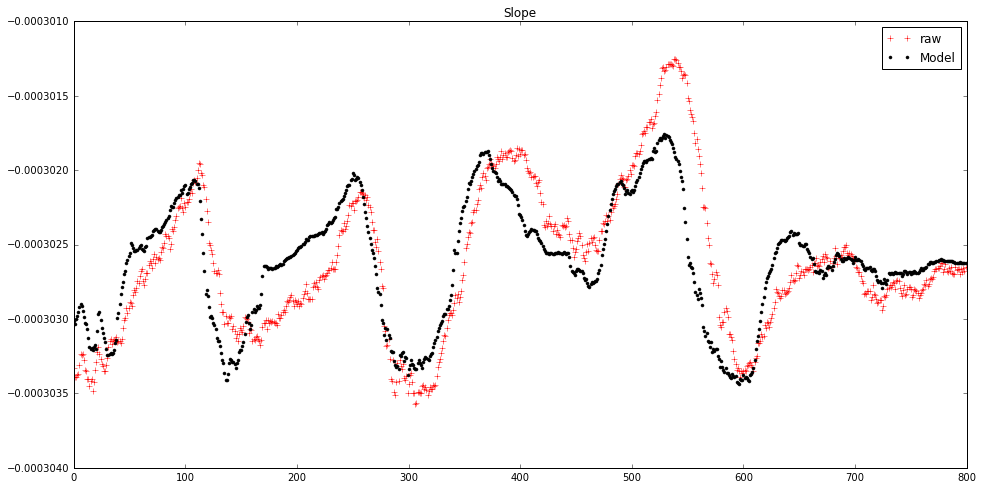

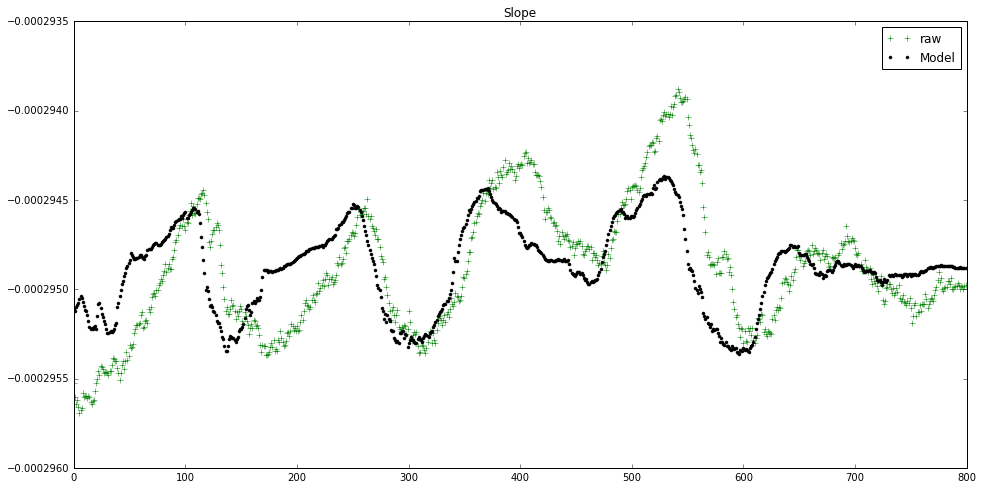

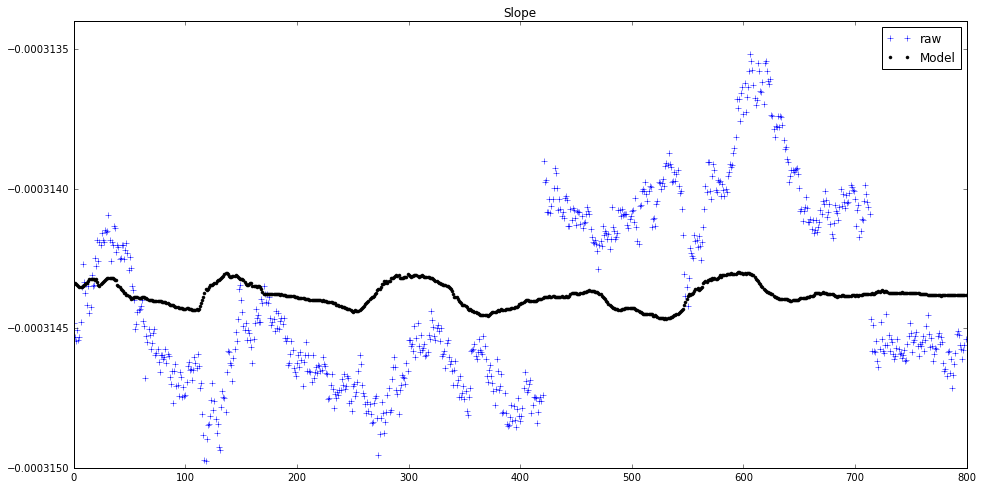

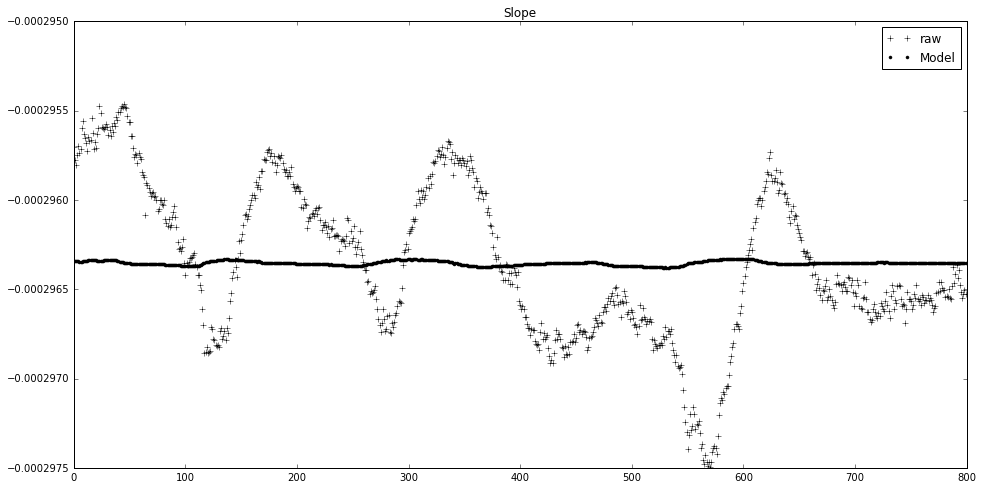

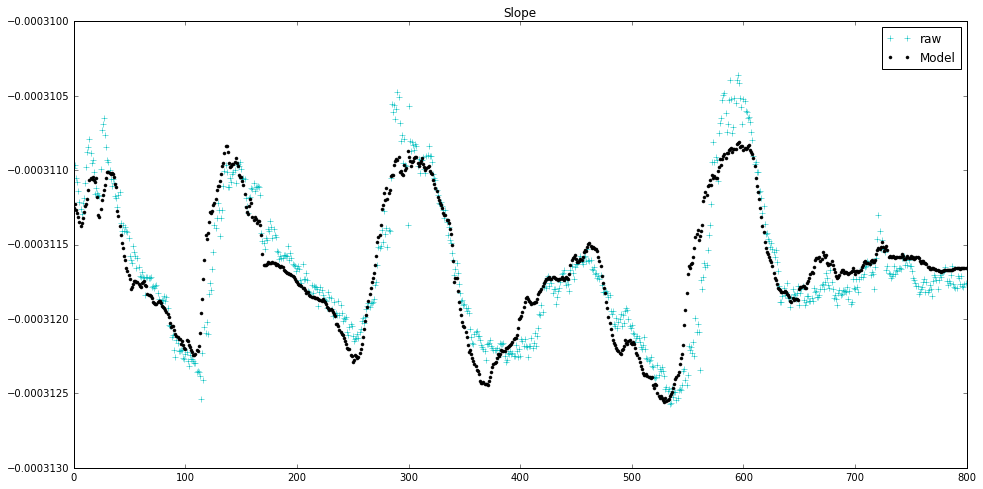

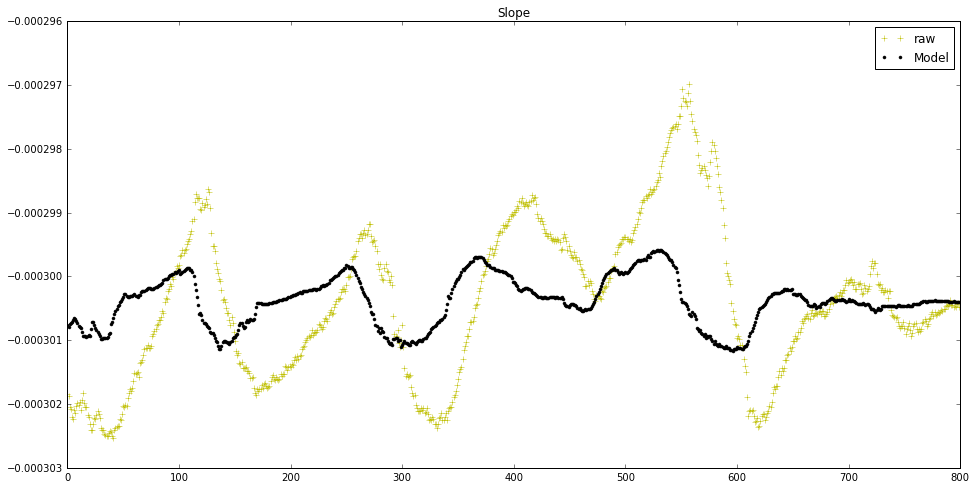

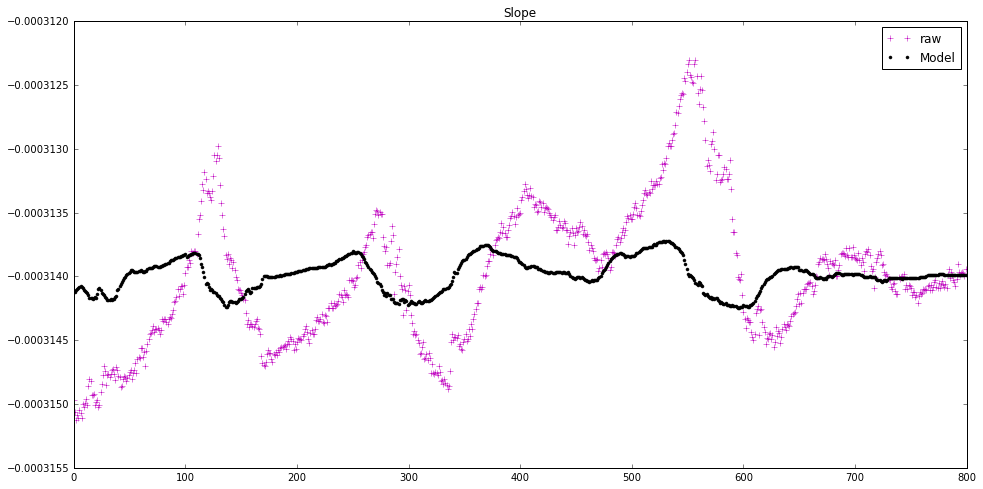

In [33]:
slope_model=[]

for i in range(len(corr_list)):
    slope_model.append([])
    
for i in range(len(corr_list)):
    slope_model[i] = func(temp_intercept_model[0:size]+273,slope_parameters[i][0], slope_parameters[i][1], slope_parameters[i][2])
    plt.figure(i+1)
    plt.title('Slope')
    plt.plot(slope_all_wo_ref[i],'+', color=colors[i],label='raw')
    plt.plot(slope_model[i],'.k', label='Model')
    plt.legend()

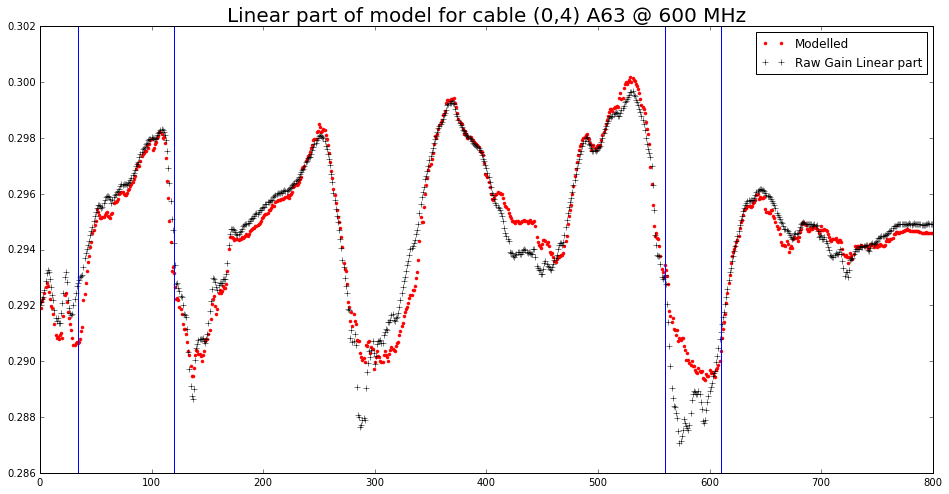

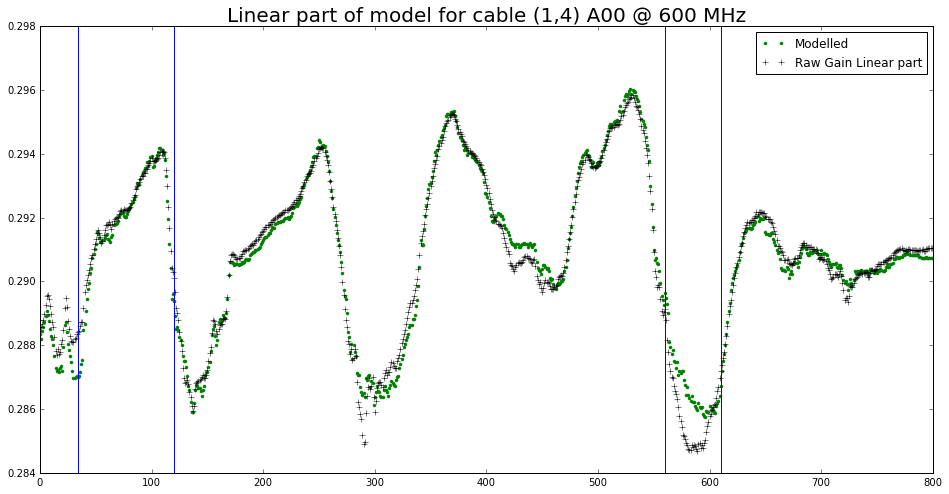

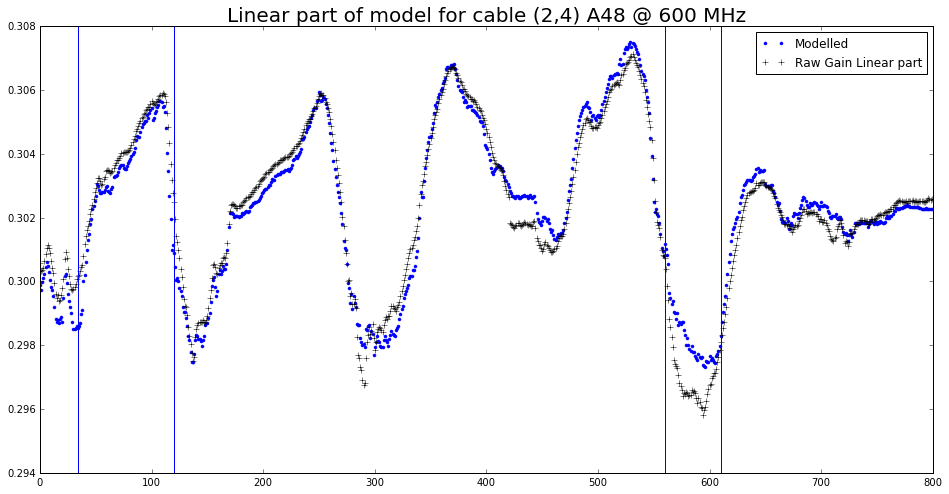

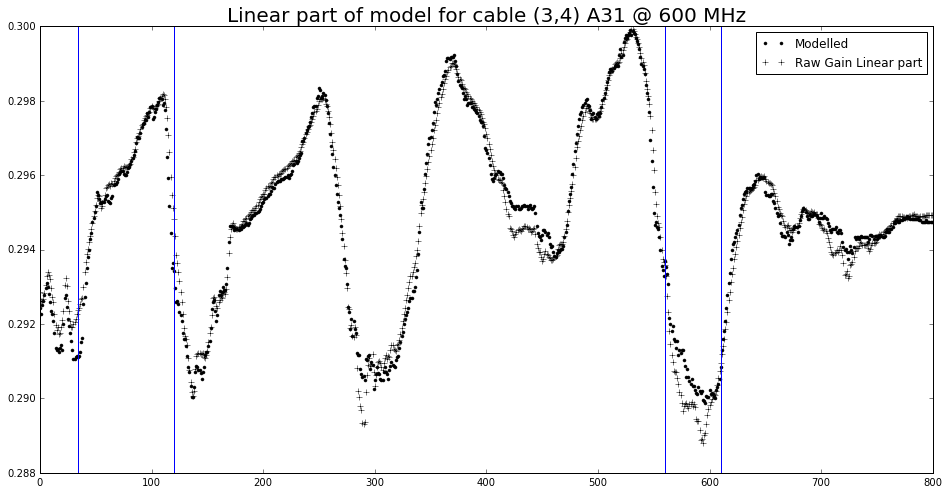

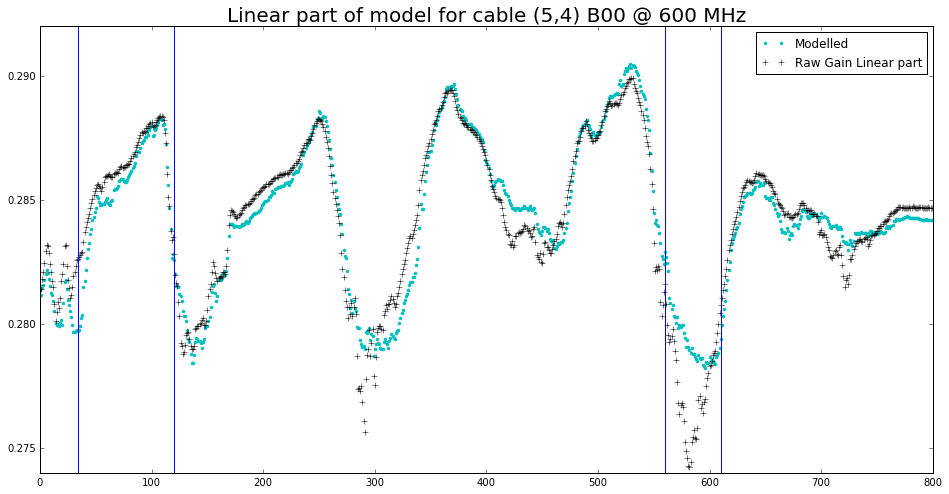

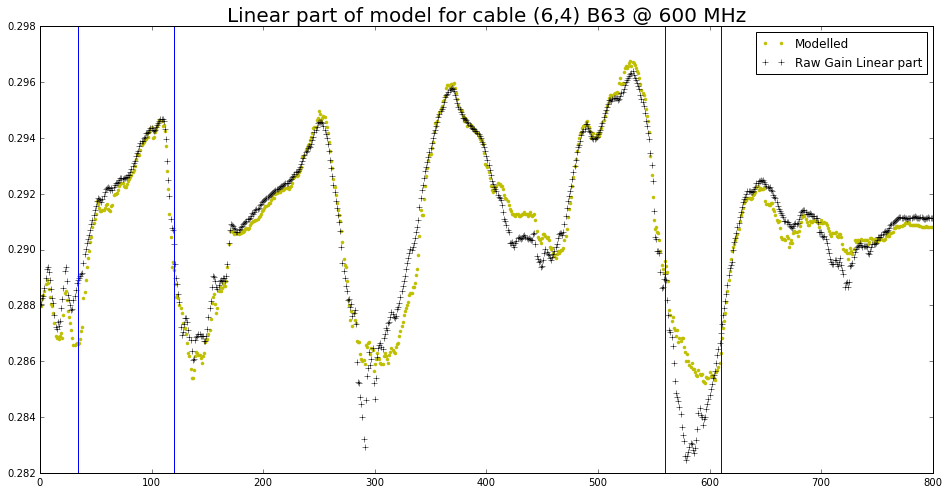

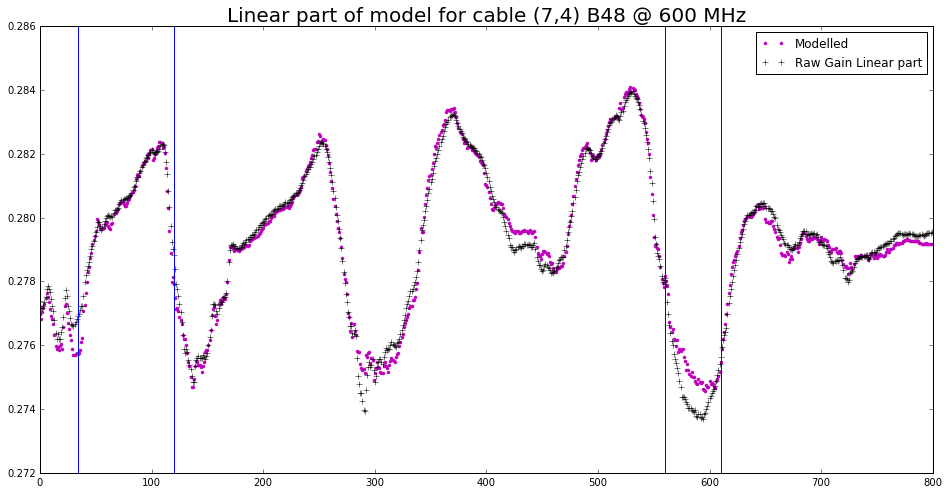

In [34]:
for i in range(len(corr_list)):
    plt.figure(i+1)
    plt.title('Linear part of model for cable %s @ 600 MHz' %(legend_crosscorr[i]), size=20)
    plt.plot(gain_linear_model_600[i], '.', color=colors[i], label='Modelled')
    plt.plot(gain_linear_raw_600[i], '+k', label='Raw Gain Linear part')
    plt.legend()
    plt.axvline(x=[580+30])
    plt.axvline(x=[580-20])
    plt.axvline(x=[120])
    plt.axvline(x=[34])

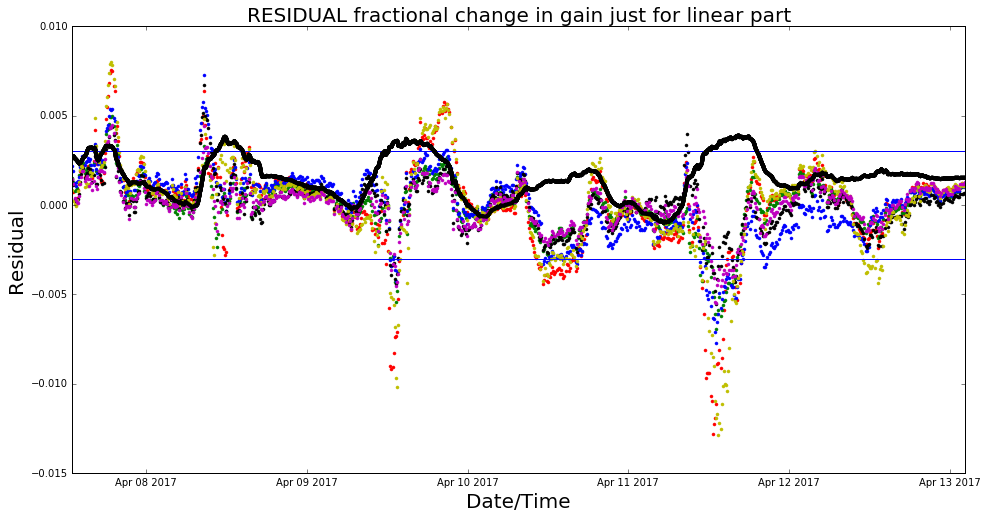

In [35]:
for i in range(len(corr_list)):

    if i!= 4:
        plt.figure(1)
        plt.title('RESIDUAL fractional change in gain just for linear part',size=20)
        plt.xlabel('Date/Time',size=20)
        plt.ylabel('Residual',size=20)
        gain_linear_model_600_frac = (gain_linear_model_600[i]-np.mean(gain_linear_model_600[i]))/np.mean(gain_linear_model_600[i])
        gain_linear_raw_600_frac = (gain_linear_raw_600[i]-np.mean(gain_linear_raw_600[i]))/np.mean(gain_linear_raw_600[i])
        plt.plot(date_stamp[0:size],gain_linear_raw_600_frac-gain_linear_model_600_frac,'.', color=colors[i])
        
        plt.axhline(y=-0.003)
        plt.axhline(y=0.003)
        #plt.legend()

    plt.plot(time_intercept_model[0:800],(temp_intercept_model[0:size])/3000,'k',linewidth =4)

In [36]:
def func_reflection(T,a,b,c):
    return a*(T/b) + c 

In [37]:
gain_reflection_raw = []
gain_reflection_model_600=[]
reflection_parameters=[]

for i in range(len(corr_list)):
    gain_reflection_raw.append([])
    reflection_parameters.append([])
    gain_reflection_model_600.append([])
        
for i in range(len(corr_list)):
    gain_reflection_raw[i] =np.zeros(800)
    gain_reflection_model_600[i]= np.zeros(size)
    
    for j in range(size):
        gain_raw = gain_all[j,i,:] # for cable 2
        z=np.polyfit(freq_phase[50:990], gain_raw,1)
        p=np.poly1d(z)
        gain_raw_all = gain_raw - p(freq_phase[50:990])
        gain_reflection_raw[i][j] = gain_raw_all[freq]
        
    x0 = [-1,3000,0.018]
    best_vals, covar = curve_fit(func_reflection, (temp_intercept_model[0:800]+273), gain_reflection_raw[i], p0 = x0)
    reflection_parameters[i] = best_vals
    
    for k in range(size):
        gain_reflection_model_600[i][k] = func_reflection((temp_intercept_model[k]+273), reflection_parameters[i][0], reflection_parameters[i][1], reflection_parameters[i][2])

In [38]:
print(gain_reflection_model_600[4][0:10])
print(gain_reflection_raw[4][0:10])
print(gain_reflection_model_600[4][0:10]-gain_reflection_raw[4][0:10])

[ 0.00192581  0.00190738  0.00193502  0.00194884  0.00196727  0.0019903
  0.00200873  0.00199491  0.00197187  0.00194423]
[ 0.00240631  0.00229818  0.00245867  0.00257377  0.00274987  0.00290579
  0.00291619  0.00295405  0.00289991  0.00278642]
[-0.0004805  -0.0003908  -0.00052365 -0.00062493 -0.0007826  -0.00091549
 -0.00090746 -0.00095914 -0.00092803 -0.00084218]


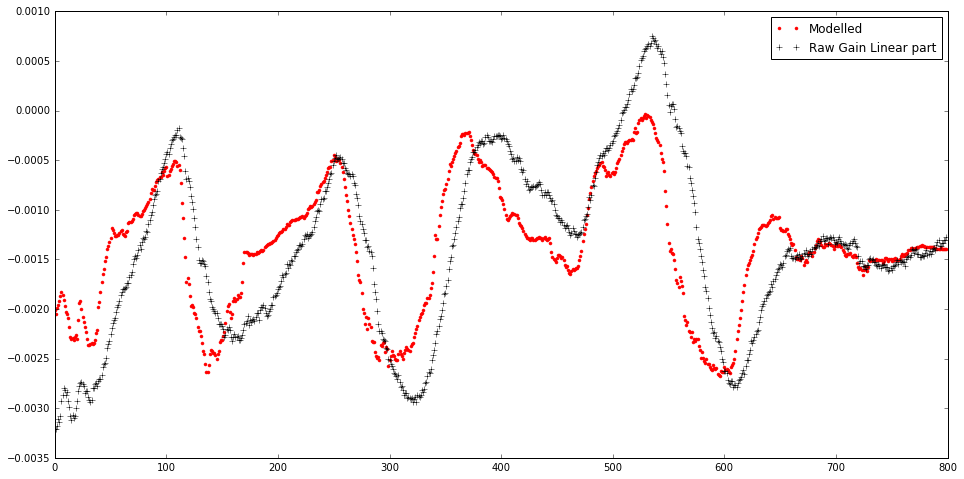

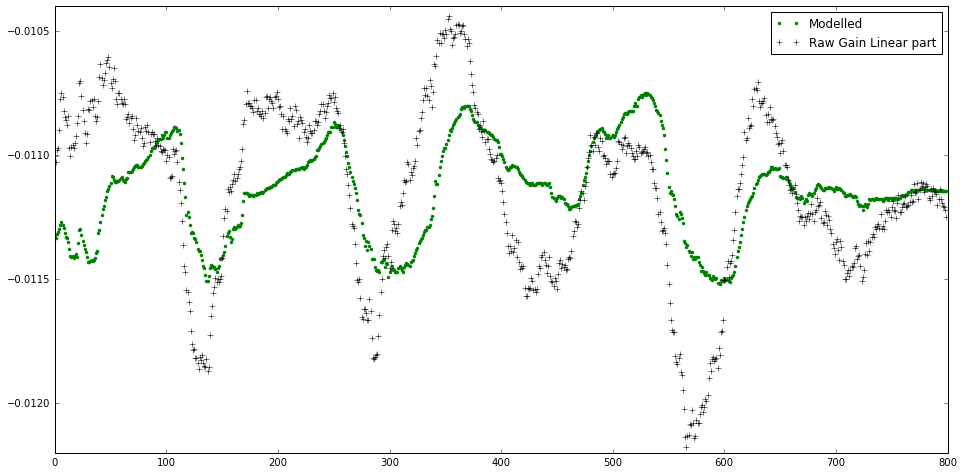

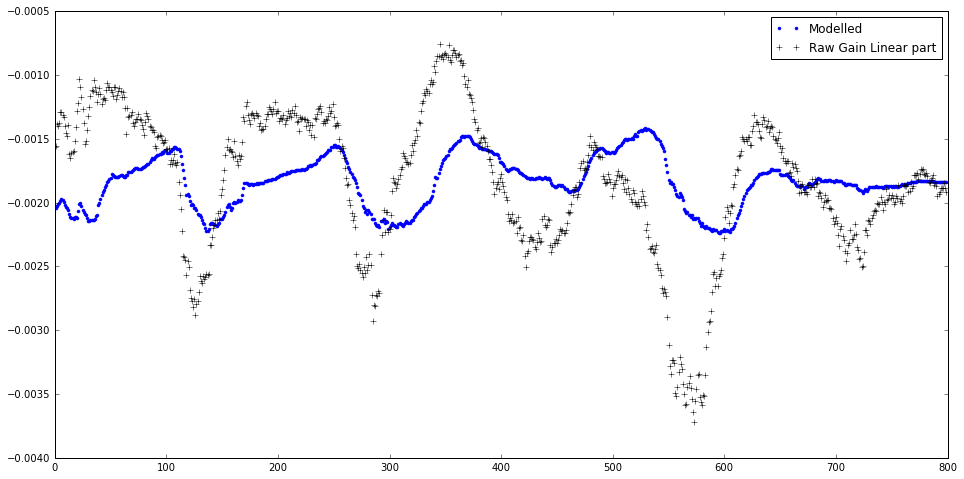

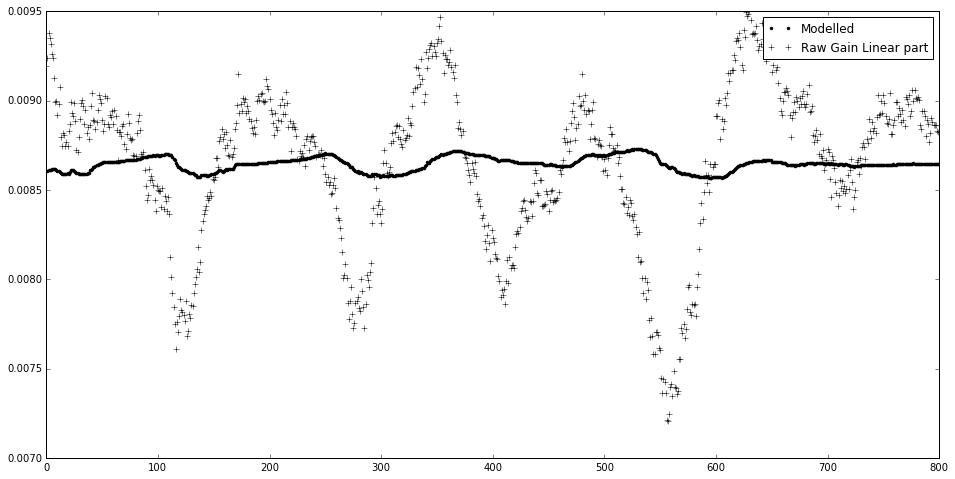

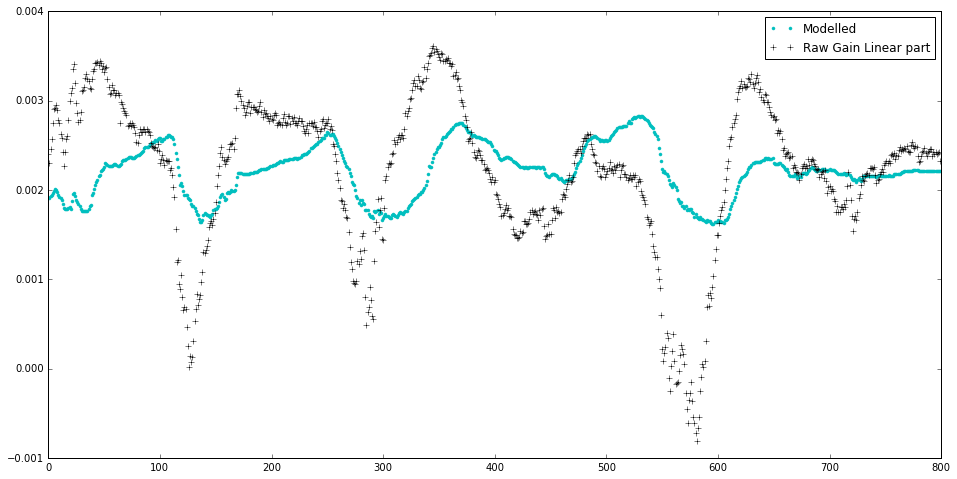

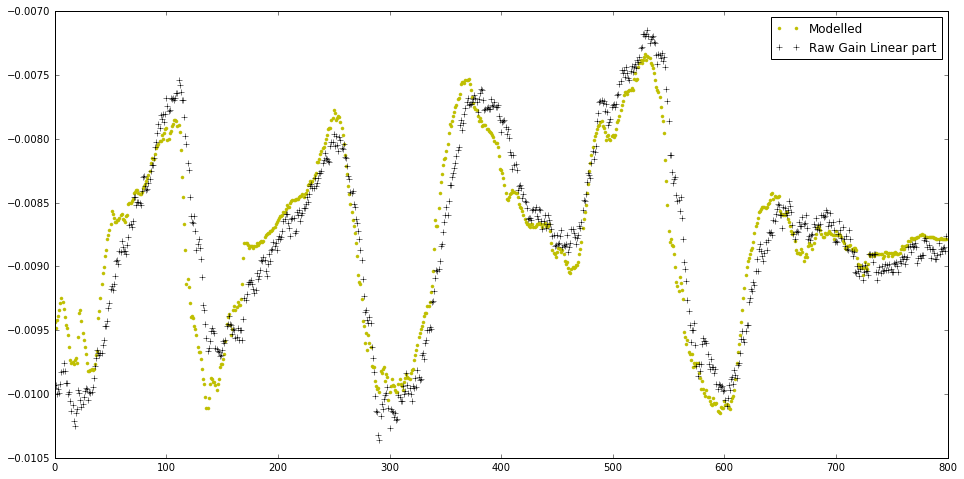

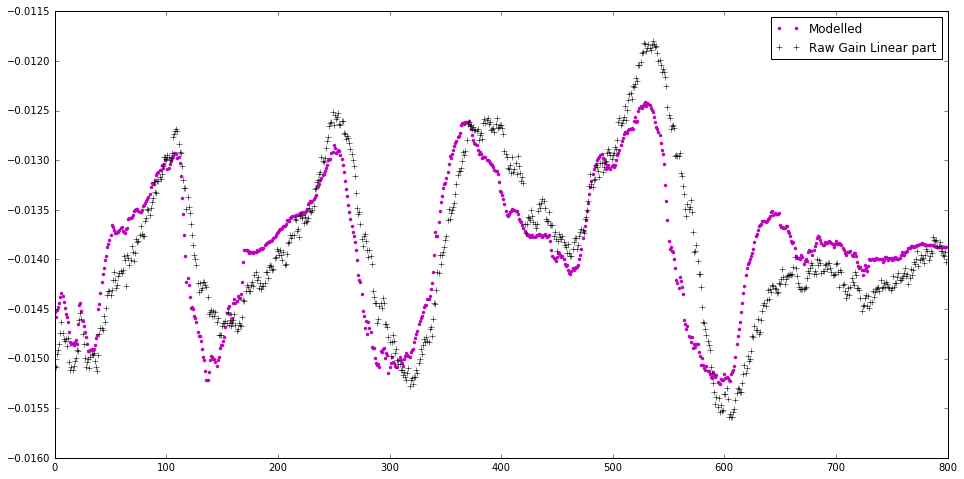

In [39]:
for i in range(len(corr_list)):
    plt.figure(i+1)
    #plt.title('Reflection part of model for cable %s @ 600 MHz' %(legend_crosscorr[i]), size=20)
    plt.plot(gain_reflection_model_600[i], '.', color=colors[i], label='Modelled')
    plt.plot(gain_reflection_raw[i], '+k', label='Raw Gain Linear part')
    plt.legend()

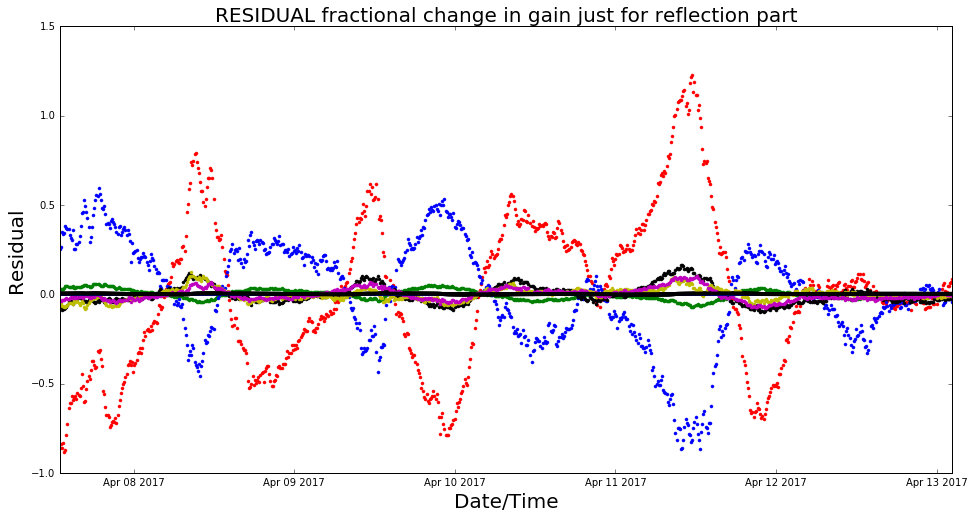

In [40]:
for i in range(len(corr_list)):

    if i!= 4:
        plt.figure(1)
        plt.title('RESIDUAL fractional change in gain just for reflection part',size=20)
        plt.xlabel('Date/Time',size=20)
        plt.ylabel('Residual',size=20)
        gain_reflection_model_600_frac = (gain_reflection_model_600[i]-np.mean(gain_reflection_model_600[i]))/np.mean(gain_reflection_model_600[i])
        gain_reflection_raw_600_frac = (gain_reflection_raw[i]-np.mean(gain_reflection_raw[i]))/np.mean(gain_reflection_raw[i])
        plt.plot(date_stamp[0:size],gain_reflection_model_600_frac-gain_reflection_raw_600_frac,'.', color=colors[i])
        
        plt.axhline(y=-0.003)
        plt.axhline(y=0.003)
        #plt.legend()

    plt.plot(time_intercept_model[0:800],(temp_intercept_model[0:size])/3000,'k',linewidth =4)

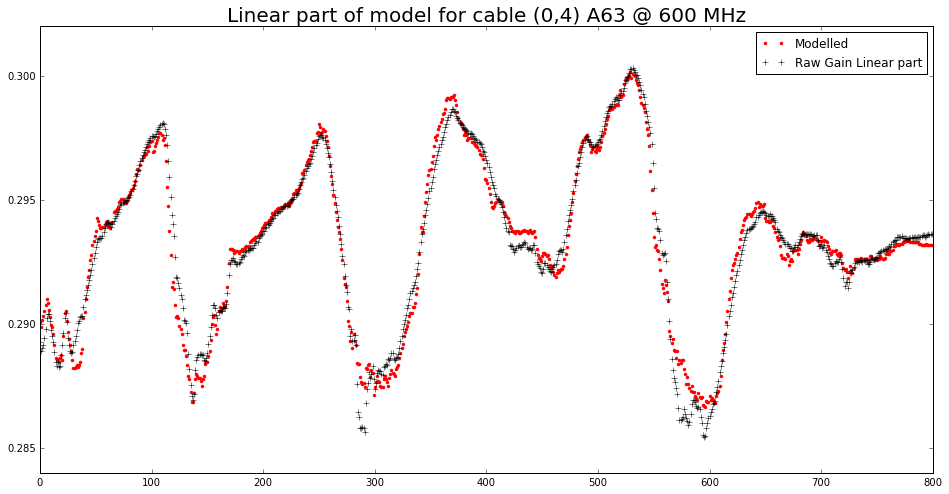

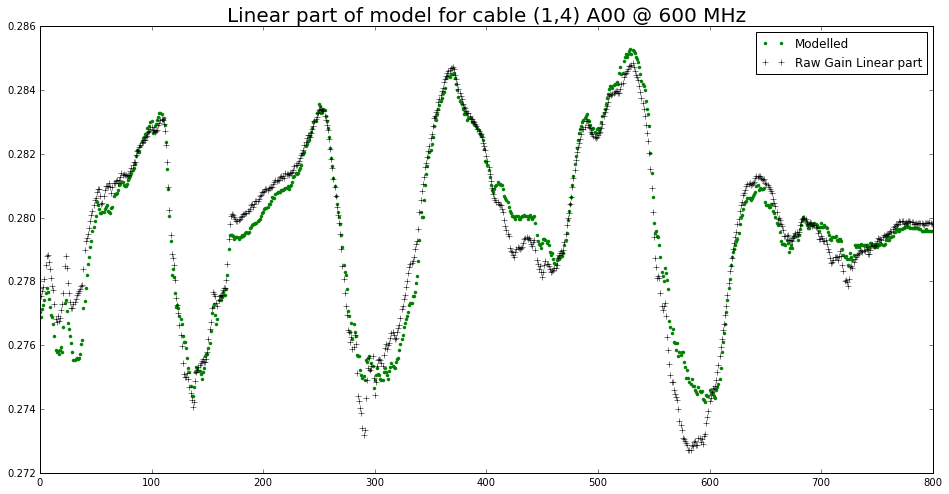

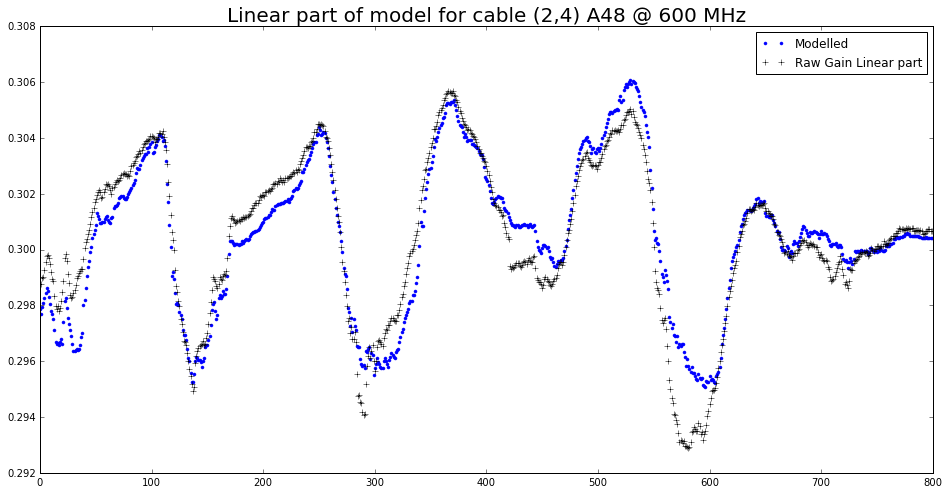

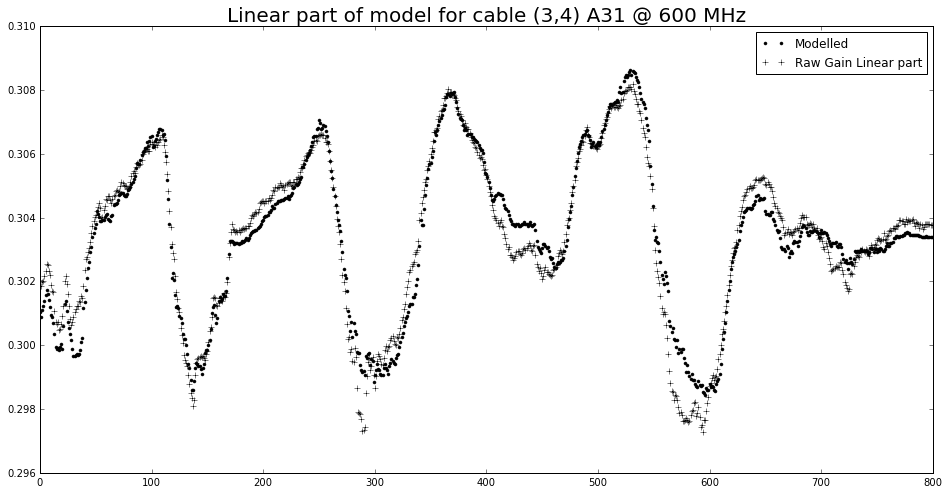

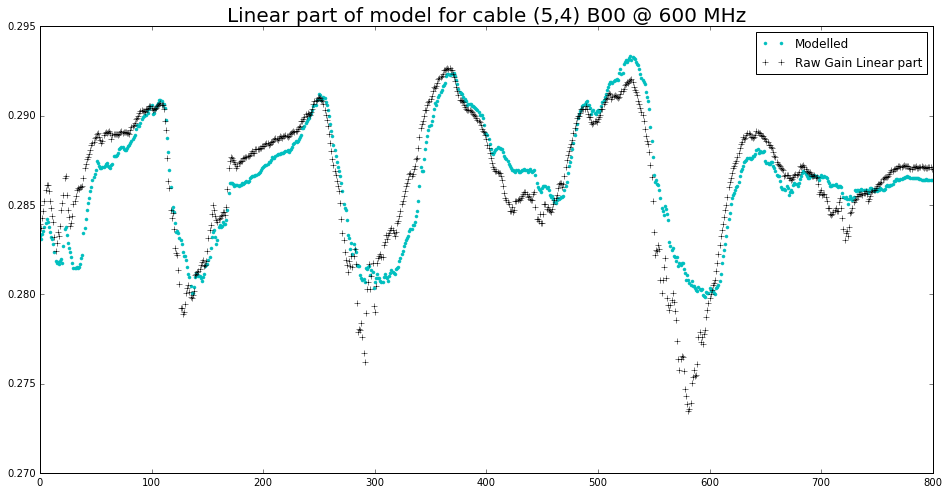

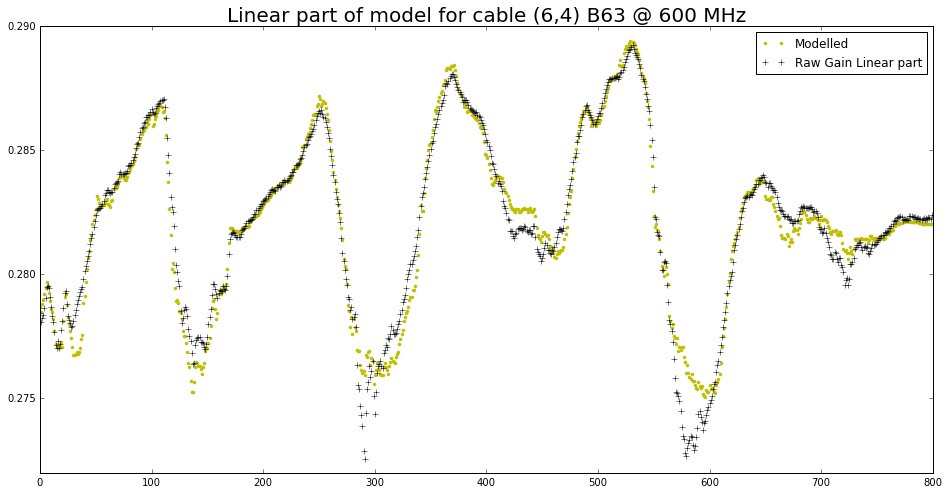

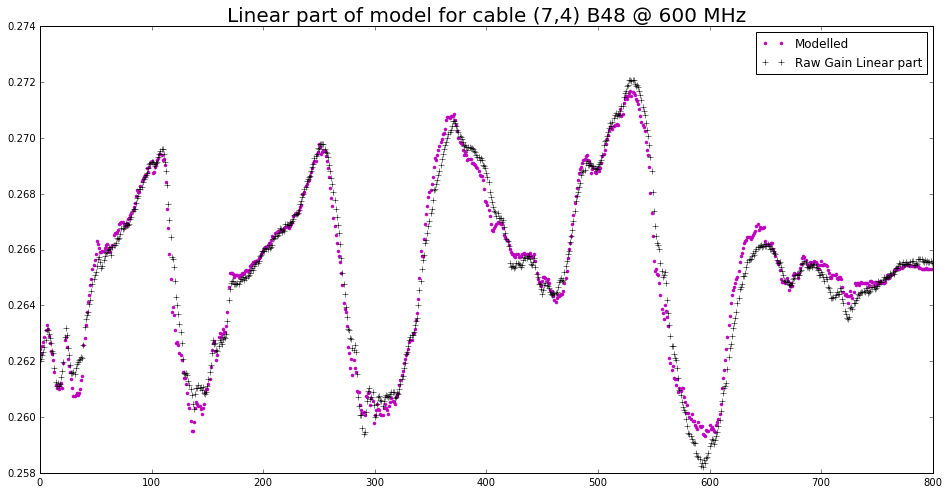

In [41]:
for i in range(len(corr_list)):
    plt.figure(i+1)
    plt.title('Linear part of model for cable %s @ 600 MHz' %(legend_crosscorr[i]), size=20)
    plt.plot(gain_reflection_model_600[i] + gain_linear_model_600[i], '.', color=colors[i], label='Modelled')
    plt.plot(gain_reflection_raw[i] + gain_linear_raw_600[i], '+k', label='Raw Gain Linear part')
    plt.legend()

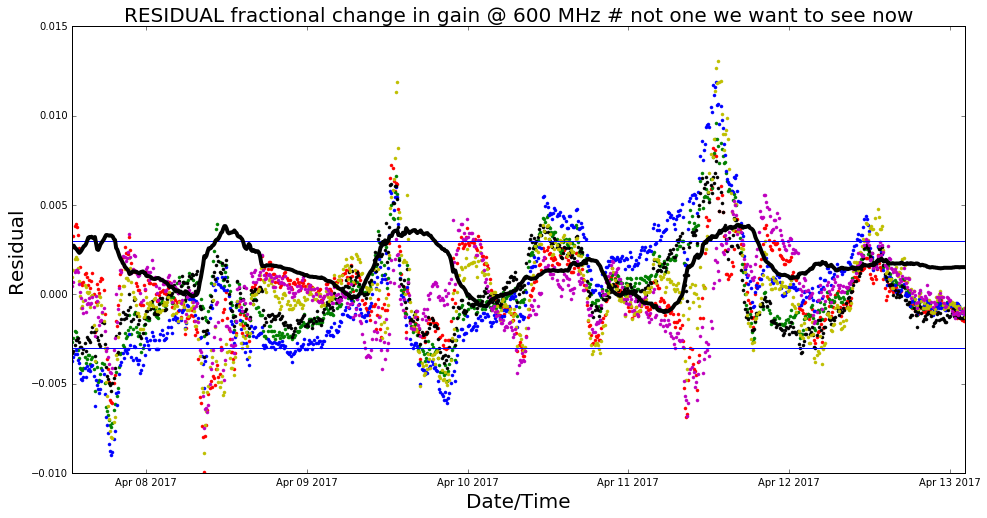

In [42]:
for i in range(len(corr_list)):
    if i!=4:
        plt.figure(1)
        plt.title('RESIDUAL fractional change in gain @ 600 MHz # not one we want to see now',size=20)
        plt.xlabel('Date/Time',size=20)
        plt.ylabel('Residual',size=20)
        gain_modelled_total = gain_reflection_model_600[i] + gain_linear_model_600[i]
        gain_raw_total = gain_reflection_raw[i] + gain_linear_raw_600[i]
        gain_model_600_frac = (gain_modelled_total-np.mean(gain_modelled_total))/np.mean(gain_modelled_total)
        gain_raw_600_frac = (gain_raw_total-np.mean(gain_raw_total))/np.mean(gain_raw_total)
        plt.plot(date_stamp[0:size],gain_model_600_frac-gain_raw_600_frac,'.', color=colors[i])

        plt.axhline(y=-0.003)
        plt.axhline(y=0.003)

    #plt.legend()
plt.plot(time_intercept_model[0:800],(temp_intercept_model[0:size])/3000,'k',linewidth =4)



# value_all_600[cable#][days,freq] : short cables
# value_all_long_600[cable#][days,freq] : longt cables

In [43]:
print(freq_phase[500])
print(freq_phase[freq+50])
print(freq)

595.50342131
600.195503421
462


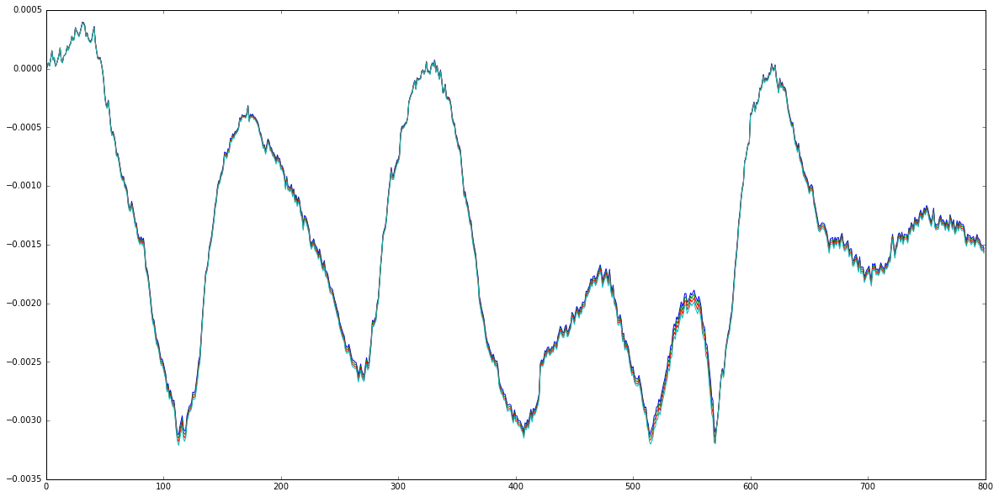

In [117]:
plt.plot(value_all_600[0][:,500])
plt.plot(value_all_600[0][:,501])
plt.plot(value_all_600[0][:,502])
plt.plot(value_all_600[0][:,503])

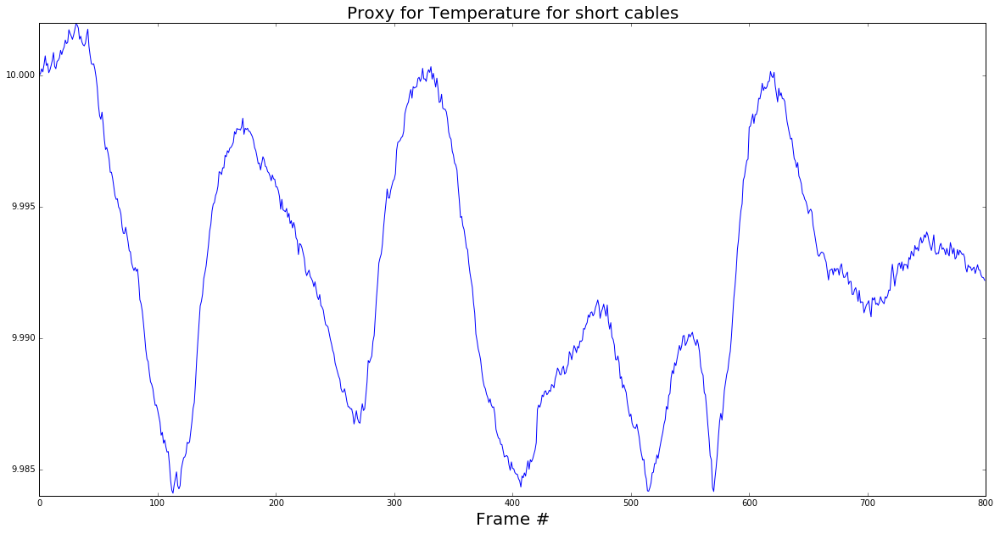

In [121]:
# temperature for shorter cables
freq_selected = [500,501,502,503,504]
k=0
temp_short_cables = np.zeros(size)
for i in range(len(freq_selected)):
    temp_short_cables[:] = temp_short_cables[:] + value_all_600[k][:,freq_selected[i]]+2
plt.plot(temp_short_cables)
plt.title('Proxy for Temperature for short cables', size=20)
plt.xlabel('Frame #', size=20)


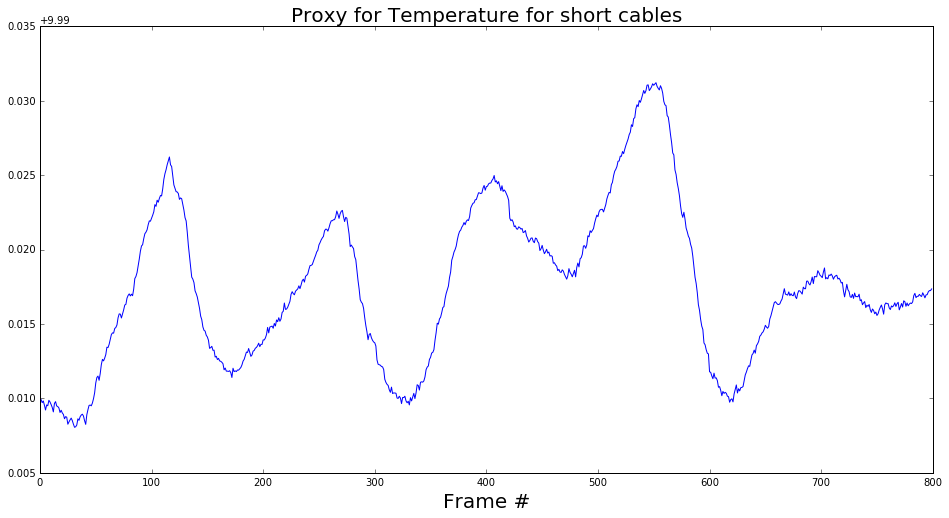

In [44]:
# temperature for shorter cables
freq_selected = [500,501,502,503,504]
k=0
temp_short_cables = np.zeros(size)
for i in range(len(freq_selected)):
    temp_short_cables[:] = temp_short_cables[:] + value_all_600[k][:,freq_selected[i]]+2
plt.plot(temp_short_cables)
plt.title('Proxy for Temperature for short cables', size=20)
plt.xlabel('Frame #', size=20)




2017-04-07 13:00:00


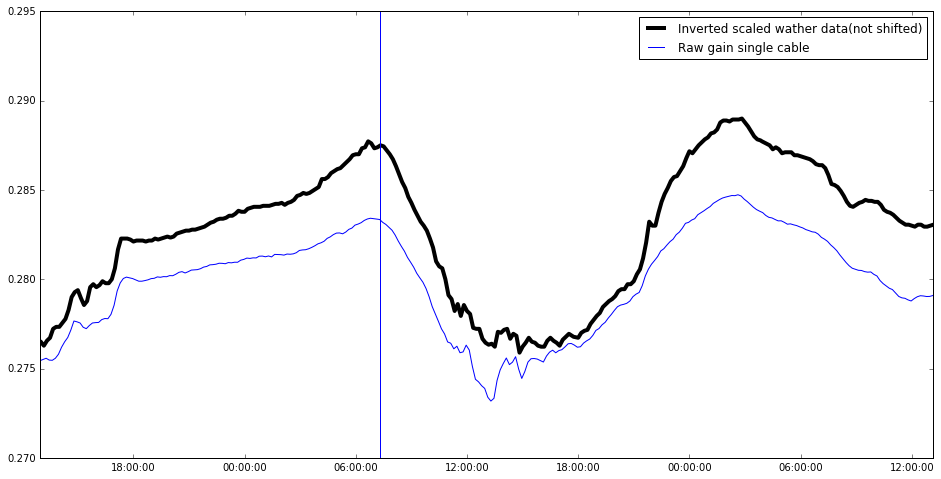

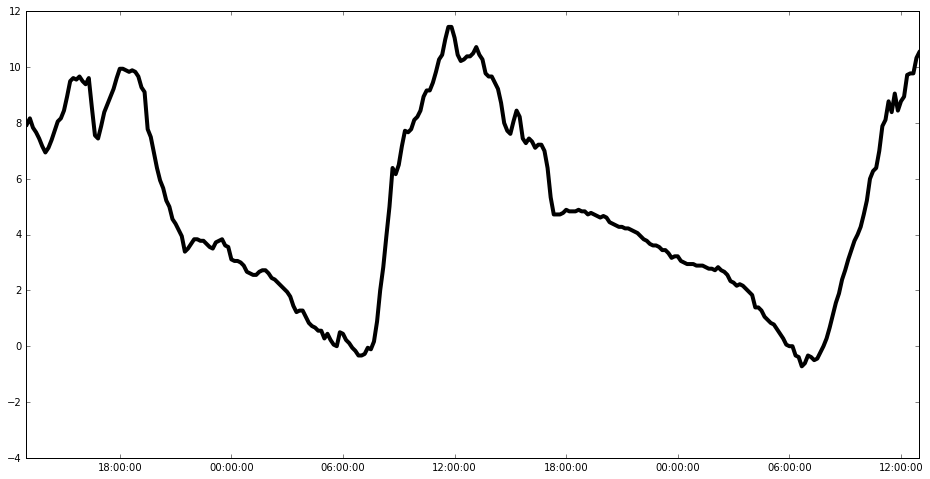

In [45]:
plt.figure(1)
plt.plot(time_intercept_model[0:size],-(temp_intercept_model[0:size]+273)/1000+0.56,'k',linewidth =4,label='Inverted scaled wather data(not shifted)')
plt.plot(date_stamp[0:size], gain_all[0:size,1,freq], label='Raw gain single cable')
plt.axvline(x = date_stamp[110])
plt.axvline(x = date_stamp[254])
plt.legend()
plt.xlim(date_stamp[144*1], date_stamp[144*3])

plt.figure(2)
plt.plot(time_intercept_model[0:size],temp_intercept_model[0:size],'k',linewidth =4,label='scaled wather data(not shifted)')
plt.xlim(date_stamp[0], date_stamp[144*2])
print(time_intercept_model[0])

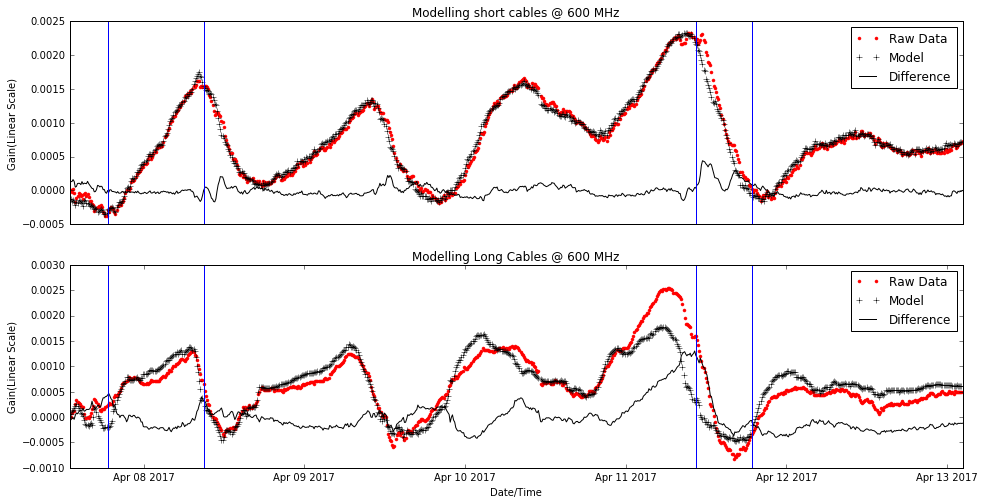

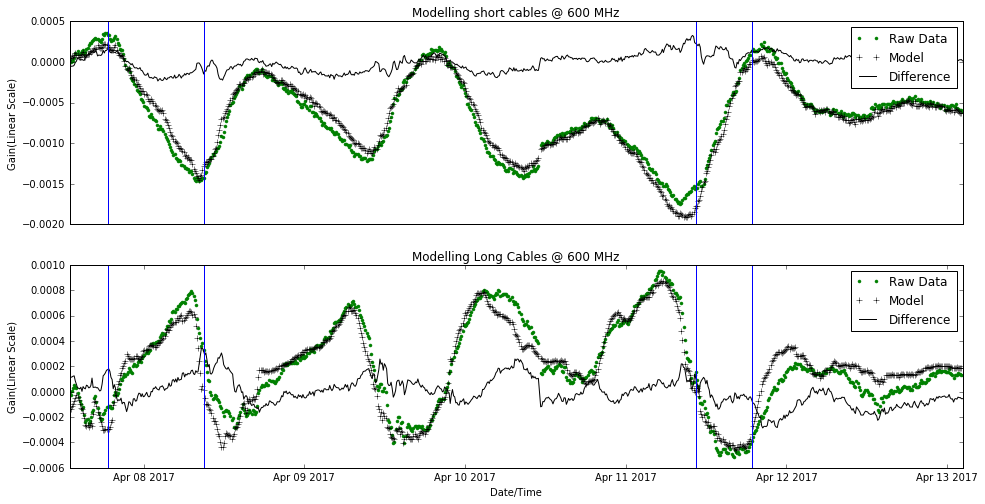

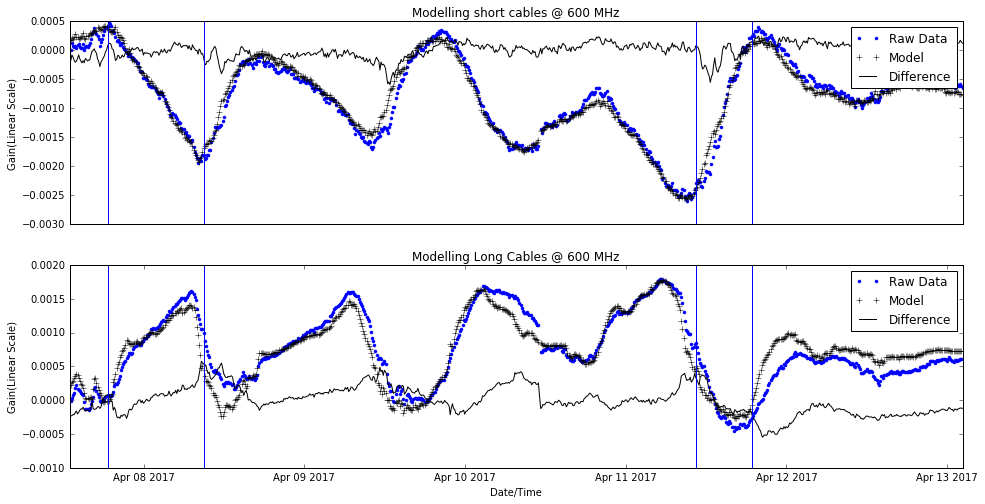

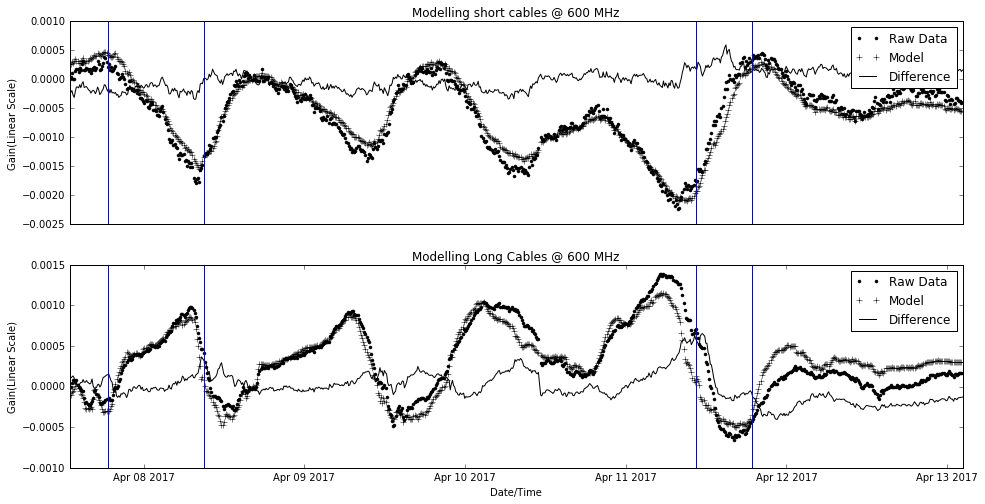

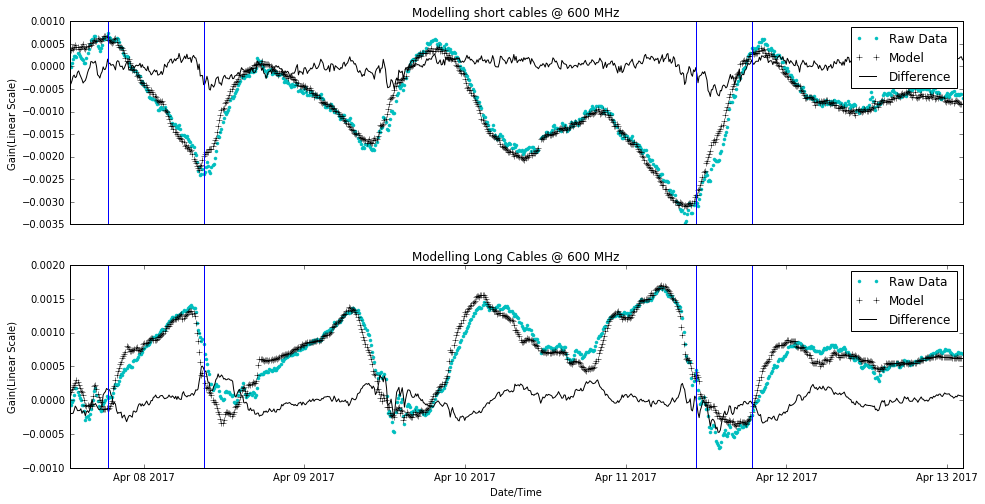

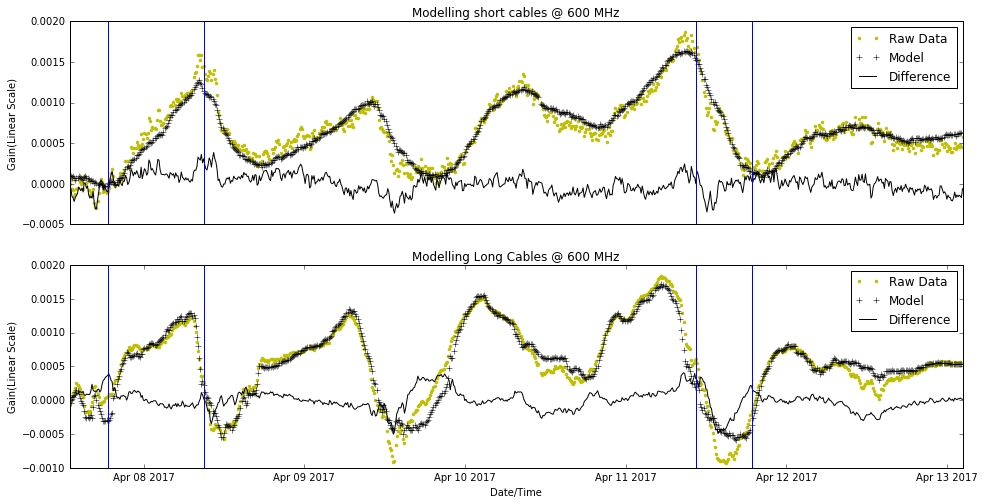

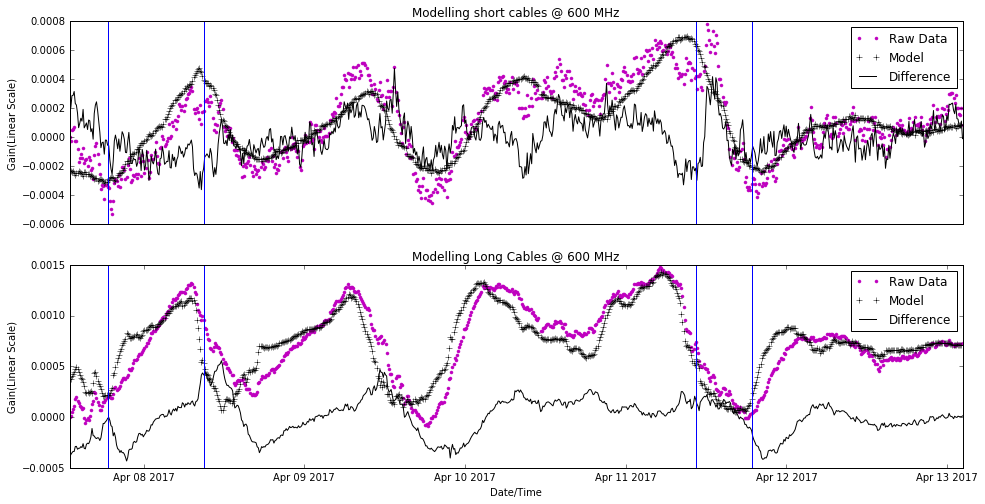

In [46]:
# Modelling short and long reflections @ 600MHz
size =800
gain_reflection_short_cable_model_600=[]
gain_reflection_long_cable_model_600=[]
short_reflection_parameters=[]
long_reflection_parameters =[]

for i in range(len(corr_list)):
    short_reflection_parameters.append([])
    long_reflection_parameters.append([])
    gain_reflection_short_cable_model_600.append([])
    gain_reflection_long_cable_model_600.append([])
        
for i in range(len(corr_list)):
    gain_reflection_short_cable_model_600[i]= np.zeros(size)
    gain_reflection_long_cable_model_600[i]= np.zeros(size)
    
    x0 = [1,1,1]
    best_vals_short, covar_short = curve_fit(func_reflection, (temp_short_cables[:]), value_all_600[i][:,freq], p0 = x0)
    best_vals_long, covar_long = curve_fit(func_reflection, temp_intercept_model[0:800]+273,value_all_long_600[i][:,freq] , p0 = x0)
    short_reflection_parameters[i] = best_vals_short
    long_reflection_parameters[i] = best_vals_long
    
    
    gain_reflection_short_cable_model_600[i][:] = func_reflection(temp_short_cables[:], short_reflection_parameters[i][0], short_reflection_parameters[i][1], short_reflection_parameters[i][2])
    gain_reflection_long_cable_model_600[i][:] = func_reflection((temp_intercept_model[0:800]+273), long_reflection_parameters[i][0], long_reflection_parameters[i][1], long_reflection_parameters[i][2])
    
    plt.figure(i+1)
    
    plt.subplot(2,1,1)
    plt.title('Modelling short cables @ 600 MHz')
    plt.ylabel('Gain(Linear Scale)')
    plt.plot(date_stamp[0:800],value_all_600[i][:,freq],'.', color=colors[i], label = 'Raw Data')
    plt.plot(date_stamp[0:800],gain_reflection_short_cable_model_600[i],'+k', label = 'Model')
    plt.plot(date_stamp[0:800],value_all_600[i][:,freq]-gain_reflection_short_cable_model_600[i],'k', label='Difference')
    plt.legend()
    plt.xticks([])
    plt.axvline(x=time_intercept_model[120])
    plt.axvline(x=time_intercept_model[580+30])
    plt.axvline(x=time_intercept_model[580-20])
    plt.axvline(x=time_intercept_model[34])
    
    plt.subplot(2,1,2)
    plt.title('Modelling Long Cables @ 600 MHz')
    plt.ylabel('Gain(Linear Scale)')
    plt.xlabel('Date/Time')
    plt.plot(date_stamp[0:800],value_all_long_600[i][:,freq],'.', color=colors[i], label = 'Raw Data')
    plt.plot(date_stamp[0:800],gain_reflection_long_cable_model_600[i],'+k', label = 'Model')
    plt.plot(date_stamp[0:800],value_all_long_600[i][:,freq]-gain_reflection_long_cable_model_600[i],'k', label='Difference')
    plt.legend()
    plt.axvline(x=time_intercept_model[120])
    plt.axvline(x=time_intercept_model[580+30])
    plt.axvline(x=time_intercept_model[580-20])
    plt.axvline(x=time_intercept_model[34])

C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\numpy\core\numeric.py:482: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


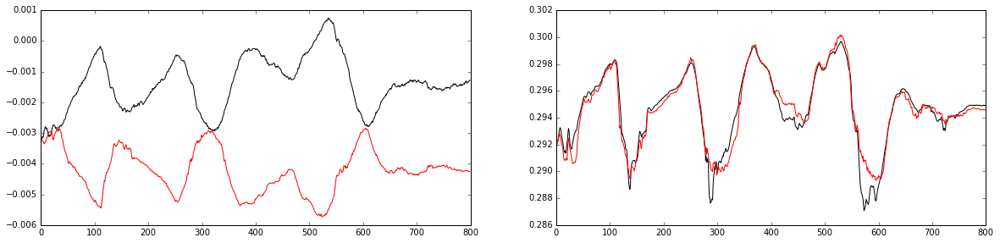

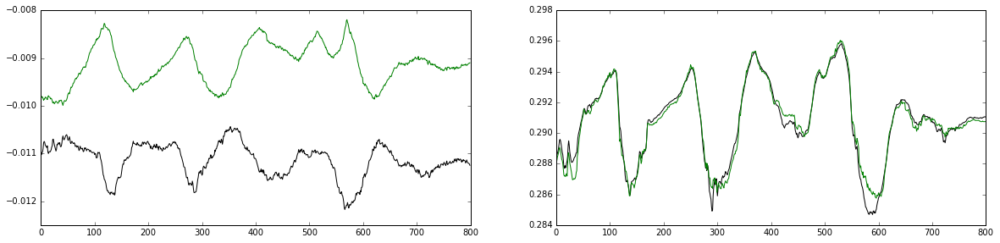

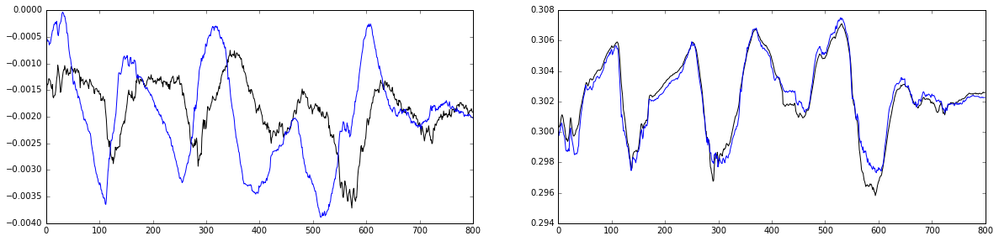

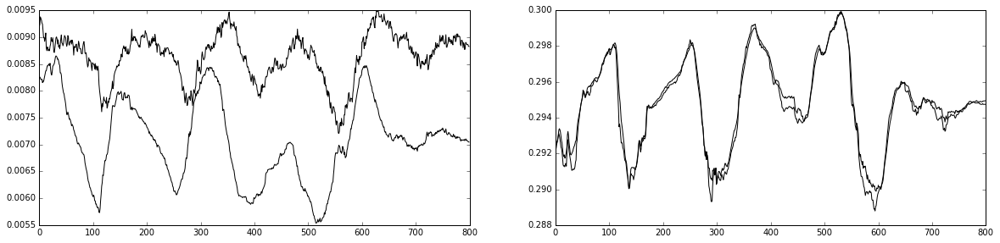

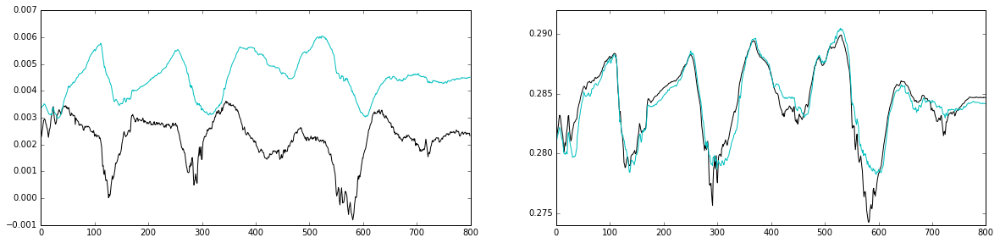

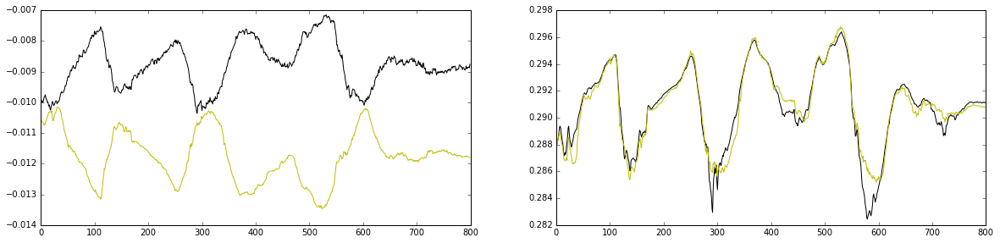

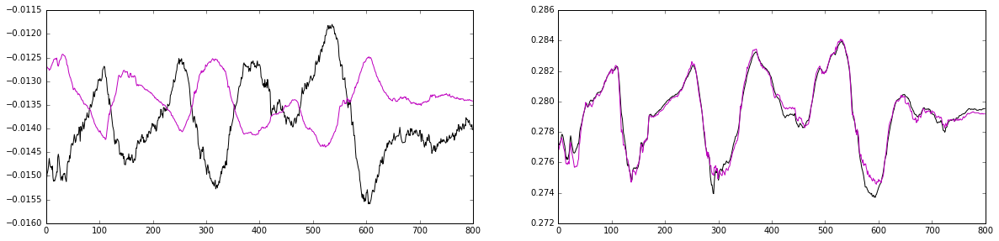

In [124]:
modelled_gain_check=[]

for i in range(len(corr_list)):
    modelled_gain_check.append([])

for i in range(len(corr_list)):
    modelled_gain_check[i] =  gain_reflection_short_cable_model_600[i] +reflections_ref_val_600[i] + reflections_ref_long_val_600[i] + gain_reflection_long_cable_model_600[i]
    
    plt.figure()
    gain_line_sub_600=[]
    gain_line_lin=[]
    
    for kk in range(len(frame_numbers)):
        gain_raw = gain_all[kk,i,:] # for cable 2
        z=np.polyfit(freq_phase[50:990], gain_raw,1)
        p=np.poly1d(z)
        gain_line_sub = gain_raw - p(freq_phase[50:990])
        gain_line_sub_600.append(gain_line_sub[freq])
        gain_line_lin.append(p(freq_phase[50:990])[freq])
        
    plt.subplot(2,2,1)    
    plt.plot(gain_line_sub_600,'k')
    plt.plot((modelled_gain_check[i]), color=colors[i])
    
    plt.subplot(2,2,2)
    plt.plot(gain_line_lin,'k')
    plt.plot(gain_linear_model_600[i], color=colors[i])

C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\numpy\core\numeric.py:482: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


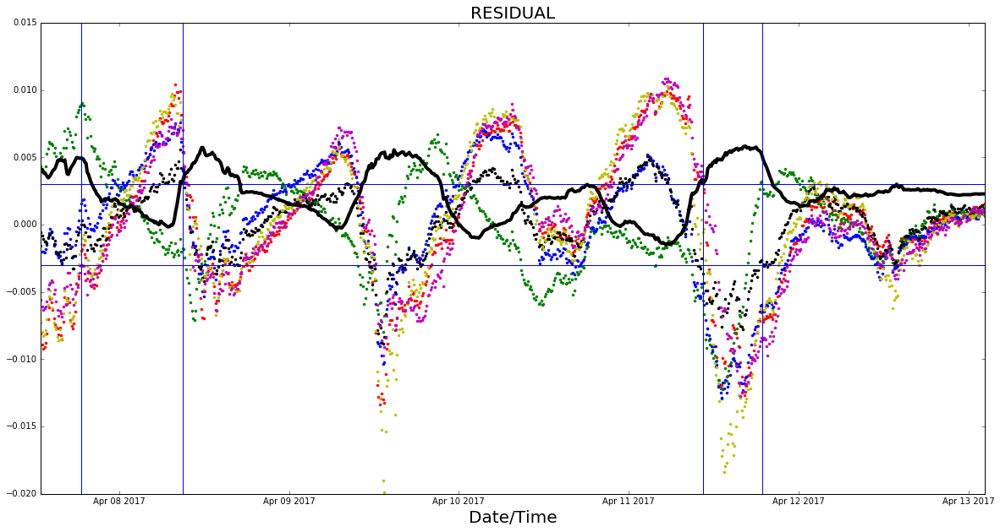

In [125]:
modelled_gain=[]
for i in range(len(corr_list)):
    modelled_gain.append([])
    
for i in range(len(corr_list)):
    modelled_gain[i] = gain_linear_model_600[i] + gain_reflection_short_cable_model_600[i] +reflections_ref_val_600[i] + reflections_ref_long_val_600[i] + gain_reflection_long_cable_model_600[i]

for i in range(len(corr_list)):
    if i!=4:
        frac_change_gain_raw = (gain_all[0:800,i,freq]-np.mean(gain_all[0:800,i,freq]))/np.mean(gain_all[0:800,i,freq])
        frac_change_gain_model = (modelled_gain[i]-np.mean(modelled_gain[i]))/np.mean(modelled_gain[i])
        plt.figure(1)
        plt.plot(date_stamp[0:800], frac_change_gain_raw-frac_change_gain_model,'.', color=colors[i])
        plt.title('RESIDUAL', size=20)
        plt.xlabel('Date/Time', size=20)
        #plt.ylabel('$Gain_raw$ - $Gain_model$', size=20)
        plt.axhline(y=-0.003)
        plt.axhline(y=0.003)
plt.plot(time_intercept_model[0:800],(temp_intercept_model[0:size])/2000,'k',linewidth =4)
plt.axvline(x=time_intercept_model[120])
plt.axvline(x=time_intercept_model[580+30])
plt.axvline(x=time_intercept_model[580-20])
plt.axvline(x=time_intercept_model[34])


# NOTES/Questions?
# When the temperature starts incresing fast, residual is going off limit. Currently cadence is 10 min and the temperature we are getting is not exactly at same time as the acquisition, ie, acquisition at 12:17 pm and temp data is of 12:20 pm, if we do better in this, can we get better model?

C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\numpy\core\numeric.py:482: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


(-0.02, 0.02)

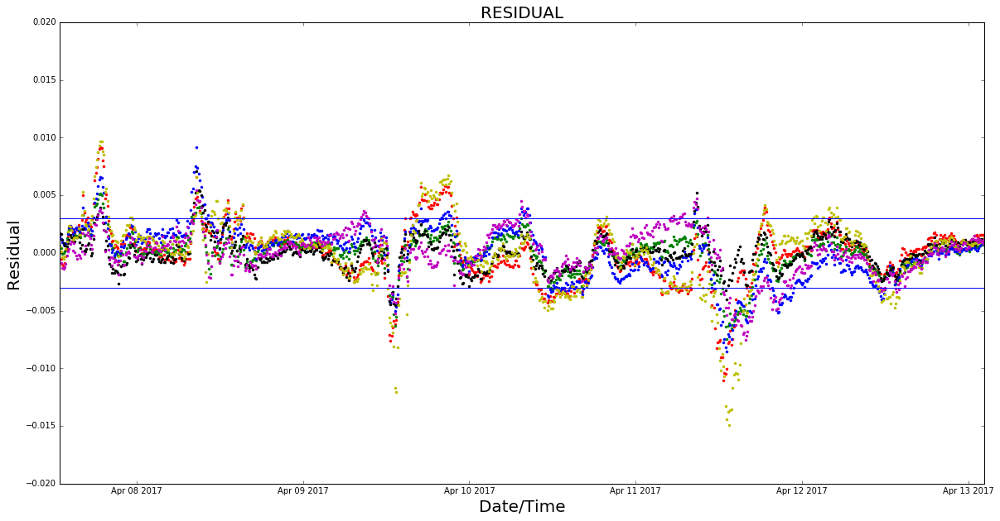

In [108]:
modelled_gain=[]
for i in range(len(corr_list)):
    modelled_gain.append([])
    
for i in range(len(corr_list)):
    modelled_gain[i] = gain_linear_model_600[i] + gain_reflection_short_cable_model_600[i] +reflections_ref_val_600[i] + reflections_ref_long_val_600[i] + gain_reflection_long_cable_model_600[i]
'''
for i in range(len(corr_list)):
    if i!=4:
        frac_change_gain_raw = (gain_all[0:800,i,freq]-np.mean(gain_all[0:800,i,freq]))/np.mean(gain_all[0:800,i,freq])
        frac_change_gain_model = (modelled_gain[i]-np.mean(modelled_gain[i]))/np.mean(modelled_gain[i])
        plt.figure(1)
        plt.plot(date_stamp[0:800], frac_change_gain_raw-frac_change_gain_model,'.', color=colors[i])
        plt.title('RESIDUAL', size=20)
        plt.xlabel('Date/Time', size=20)
        #plt.ylabel('$Gain_raw$ - $Gain_model$', size=20)
        plt.axhline(y=-0.003)
        plt.axhline(y=0.003)
plt.plot(time_intercept_model[0:800],(temp_intercept_model[0:size])/2000,'k',linewidth =4)
plt.xlim(date_stamp[144], date_stamp[144*3])
'''

for i in range(len(corr_list)):
    if i!=4:
        frac_change_gain_raw = (gain_all[0:800,i,freq]-np.mean(gain_all[0:800,i,freq]))/np.mean(gain_all[0:800,i,freq])
        frac_change_gain_model = (modelled_gain[i]-np.mean(modelled_gain[i]))/np.mean(modelled_gain[i])
        plt.figure(2)
        plt.plot(date_stamp[0:800], frac_change_gain_raw-frac_change_gain_model,'.', color=colors[i])
        plt.title('RESIDUAL', size=20)
        plt.xlabel('Date/Time', size=20)
        plt.ylabel('Residual',size=20)
        #plt.ylabel('$Gain_raw$ - $Gain_model$', size=20)
        plt.axhline(y=-0.003)
        plt.axhline(y=0.003)
#plt.plot(time_intercept_model[0:800],(temp_intercept_model[0:size])/2000,'ok')#,linewidth =4)
#plt.xlim(date_stamp[144*2], date_stamp[144*5])
plt.ylim(-0.02,0.02)

In [ ]:
# based on the new model where we have proxy for temperature for short cables
for i in range(len(corr_list)):
    frac_change_gain_raw = (gain_all[0:800,i,freq]-np.mean(gain_all[0:800,i,freq]))/np.mean(gain_all[0:800,i,freq])
    frac_change_gain_model = (modelled_gain[i]-np.mean(modelled_gain[i]))/np.mean(modelled_gain[i])
    plt.figure(i+1)
    
    plt.subplot(2,2,1)
    plt.title('RESIDUAL', size=20)
    plt.plot(date_stamp[0:800], frac_change_gain_raw-frac_change_gain_model,'.', color=colors[i], label = 'total residual')
    plt.plot(date_stamp[0:800],gain_linear_raw_600[i] - gain_linear_model_600[i],'k', label='Difference of linear fit and Linear model')
    plt.legend()
    plt.axhline(y=-0.003)
    plt.axhline(y=0.003)
    plt.axvline(x=time_intercept_model[120])
    plt.axvline(x=time_intercept_model[34])
    plt.axvline(x=time_intercept_model[580+30])
    plt.axvline(x=time_intercept_model[580-20])
    plt.xticks([])
    
    plt.subplot(2,2,2)
    plt.title("linear model", size=20)
    plt.plot(date_stamp[0:800],gain_linear_model_600[i], '.', color=colors[i], label='Modelled Linear fit')
    plt.plot(date_stamp[0:800],gain_linear_raw_600[i], '+k', label='Raw Gain Linear fit')
    plt.xticks([])
    plt.axvline(x=time_intercept_model[120])
    plt.axvline(x=time_intercept_model[34])
    plt.axvline(x=time_intercept_model[580+30])
    plt.axvline(x=time_intercept_model[580-20])
    plt.legend()
    
    plt.subplot(2,2,3)
    plt.title('Reflection Long Cables', size=20)
    plt.plot(date_stamp[0:800],value_all_long_600[i][:,freq],'.', color=colors[i], label = 'Raw Data')
    plt.plot(date_stamp[0:800],gain_reflection_long_cable_model_600[i],'+k', label = 'Model')
    plt.plot(date_stamp[0:800],value_all_long_600[i][:,freq]-gain_reflection_long_cable_model_600[i],'k', label='Difference')
    plt.legend()
    plt.axvline(x=time_intercept_model[120])
    plt.axvline(x=time_intercept_model[34])
    plt.axvline(x=time_intercept_model[580+30])
    plt.axvline(x=time_intercept_model[580-20])
    
    plt.subplot(2,2,4)
    plt.title('Reflection short cables', size=20)
    plt.plot(date_stamp[0:800],value_all_600[i][:,freq],'.', color=colors[i], label = 'Raw Data')
    plt.plot(date_stamp[0:800],gain_reflection_short_cable_model_600[i],'+k', label = 'Model')
    plt.plot(date_stamp[0:800],value_all_600[i][:,freq]-gain_reflection_short_cable_model_600[i],'k', label='Difference')
    plt.legend()
    plt.axvline(x=time_intercept_model[580+30])
    plt.axvline(x=time_intercept_model[580-20])
    plt.axvline(x=time_intercept_model[120])
    plt.axvline(x=time_intercept_model[34])
    
    
    #plt.ylabel('$Gain_raw$ - $Gain_model$', size=20)
    plt.axhline(y=-0.003)
    plt.axhline(y=0.003)


In [ ]:
for i in range(len(corr_list)):
    frac_change_gain_raw = (gain_all[0:800,i,freq]-np.mean(gain_all[0:800,i,freq]))/np.mean(gain_all[0:800,i,freq])
    frac_change_gain_model = (modelled_gain[i]-np.mean(modelled_gain[i]))/np.mean(modelled_gain[i])
    plt.figure(i+1)
    
    plt.title('RESIDUAL', size=20)
    #plt.subplot(2,1,1)
    plt.plot(date_stamp[0:800], frac_change_gain_raw-frac_change_gain_model,'.', color=colors[i], label = 'total residual')
    
    plt.legend()
    plt.axhline(y=-0.003)
    plt.axhline(y=0.003)
    plt.axvline(x=time_intercept_model[120])
    plt.axvline(x=time_intercept_model[34])
    plt.axvline(x=time_intercept_model[580+30])
    plt.axvline(x=time_intercept_model[580-20])
    plt.xticks([])
    
    #plt.subplot(2,1,2)
    #plt.title("linear model", size=20)
    plt.plot(date_stamp[0:800],gain_linear_raw_600[i] - gain_linear_model_600[i],'k', label='Difference of linear fit and Linear model')
    plt.plot(date_stamp[0:800],value_all_long_600[i][:,freq]-gain_reflection_long_cable_model_600[i],'g', label='Difference Long cables')
    plt.plot(date_stamp[0:800],value_all_600[i][:,freq]-gain_reflection_short_cable_model_600[i],'c', label='Difference short cables')
    plt.legend()
    plt.axvline(x=time_intercept_model[580+30])
    plt.axvline(x=time_intercept_model[580-20])
    plt.axvline(x=time_intercept_model[120])
    plt.axvline(x=time_intercept_model[34])
    plt.plot(time_intercept_model[0:800],(temp_intercept_model[0:size])/2000,'k',linewidth =4)
    #plt.ylabel('$Gain_raw$ - $Gain_model$', size=20)
    plt.axhline(y=-0.003)
    plt.axhline(y=0.003)


In [ ]:
for k in range(len(corr_list)):
    plt.figure(1)
    plt.plot(gain_all[500:650,k,freq])
    plt.axvline(x=80-20)
    plt.axvline(x=80+30)

In [ ]:
for i in range(len(corr_list)):
    plt.figure(i+1)
    plt.title("linear model")
    plt.plot(date_stamp[0:800],gain_linear_model_600[i], '.', color=colors[i], label='Modelled')
    plt.plot(date_stamp[0:800],gain_linear_raw_600[i], '+k', label='Raw Gain Linear part')

    plt.axvline(x=time_intercept_model[120])
    plt.axvline(x=time_intercept_model[34])
    plt.axvline(x=time_intercept_model[580+30])
    plt.axvline(x=time_intercept_model[580-20])
    plt.xlim(time_intercept_model[580-30],time_intercept_model[580+40])
    plt.legend()

In [ ]:
modelled_gain=[]
sun_time=[12,13,14,15]

for i in range(len(corr_list)):
    modelled_gain.append([])
    
for i in range(len(corr_list)):
    modelled_gain[i] = gain_linear_model_600[i] + gain_reflection_short_cable_model_600[i] + gain_reflection_long_cable_model_600[i]

for i in range(len(corr_list)):
    raw_non_sun_gain=[]
    modelled_non_sun_gain=[]
    date_stamp_non_sun=[]
    
    if i!=4:
        for k in range(size):
            if time_intercept_model[k].hour not in sun_time:
                raw_non_sun_gain.append(gain_all[k,i,freq])
                modelled_non_sun_gain.append(modelled_gain[i][k])
                date_stamp_non_sun.append(date_stamp)
        frac_change_gain_raw = (raw_non_sun_gain-np.mean(raw_non_sun_gain))/np.mean(raw_non_sun_gain)
        frac_change_gain_model = (modelled_non_sun_gain-np.mean(modelled_non_sun_gain))/np.mean(modelled_non_sun_gain)
        #print(frac_change_gain_raw)
        plt.figure(1)
        plt.plot(frac_change_gain_raw-frac_change_gain_model,'.', color=colors[i])

        plt.axhline(y=-0.003)
        plt.axhline(y=0.003)
    



In [ ]:
for i in range(415:425):
    print(date_stamp[i].minute)

In [ ]:
print(date_stamp[0])
print(date_stamp[359])
print(date_stamp[360])
print(date_stamp[361])
print(date_stamp[362])

In [ ]:
print(len(date_stamp[0:421]))
print(date_stamp[421])

# not taking in account 12 - 4pm data 

In [ ]:
modelled_gain=[]
time_non_sun = [8,9,10,11,12,13,14,15,16,17]
gain_raw_non_sun=[]
gain_model_non_sun=[]
date_non_sun=[]

for i in range(len(corr_list)):
    modelled_gain.append([])
    gain_raw_non_sun.append([])
    gain_model_non_sun.append([])
    date_non_sun.append([])
    
for i in range(len(corr_list)):
    modelled_gain[i] = gain_linear_model_600[i] + gain_reflection_short_cable_model_600[i] +reflections_ref_val_600[i] + reflections_ref_long_val_600[i] + gain_reflection_long_cable_model_600[i]


for i in range(len(corr_list)):
    for k in range(size):
        if date_stamp[k].hour not in time_non_sun:
            gain_raw_non_sun[i].append(gain_all[k,i,freq])
            gain_model_non_sun[i].append(modelled_gain[i][k])
            date_non_sun[i].append(date_stamp[k])

In [ ]:
modelled_gain=[]
frac_change_gain_raw=[]
frac_change_gain_model=[]
for i in range(len(corr_list)):
    modelled_gain.append([])
    
for i in range(len(corr_list)):
    modelled_gain[i] = gain_linear_model_600[i] + gain_reflection_short_cable_model_600[i] +reflections_ref_val_600[i] + reflections_ref_long_val_600[i] + gain_reflection_long_cable_model_600[i]

for i in range(len(corr_list)):
    if i!=4:
        frac_change_gain_raw = (gain_raw_non_sun[i]-np.mean(gain_raw_non_sun[i]))/np.mean(gain_raw_non_sun[i])
        frac_change_gain_model = (gain_model_non_sun[i]-np.mean(gain_model_non_sun[i]))/np.mean(gain_model_non_sun[i])
        plt.figure(1)
        plt.plot(date_non_sun[i], frac_change_gain_raw-frac_change_gain_model,'.', color=colors[i])
        plt.title('RESIDUAL', size=20)
        plt.xlabel('Date/Time', size=20)
        #plt.ylabel('$Gain_raw$ - $Gain_model$', size=20)
        plt.axhline(y=-0.003)
        plt.axhline(y=0.003)
plt.plot(time_intercept_model[0:800],(temp_intercept_model[0:size])/2000,'k',linewidth =4)
plt.axvline(time_intercept_model[360])


# Working with new Temp_data for just 800 point (note this is new interpolated temperature data)
# Three parts of model: linear fit (slope+intercept), Long cables, short cables

In [ ]:
reqd_min=[7,17,27,37,47,57]
k=0
dd=0
for i in range(800):
    if date_stamp[i].minute != reqd_min[k]:
        dd=1
        print(i)
    if dd==1:
        k=reqd_min.index(date_stamp[i].minute)
    k=k+1
    if k > 5:
        k=0

In [ ]:
file = open("weather_interpolated.out","r")
date_temp = np.loadtxt('weather_interpolated.out')
file.close()

interp_time_800_pre = date_temp[0]
interp_temp_800 = date_temp[1]
interp_time_800 = np.array([(datetime.datetime.fromtimestamp(x))  for x in interp_time_800_pre])

In [ ]:
# fitting the linear part of the gain model
# here fit parameters are not frequency dependent

size=800 # we are fititng for 5.5 days of total data
def linear_model(interp_temp_800):
    slope_parameters=[]
    intercept_parameters=[]
    slope_all_wo_ref=[]
    intercept_all_wo_ref=[]

    for i in range(len(corr_list)):
        slope_parameters.append([])
        intercept_parameters.append([])
        slope_all_wo_ref.append([])
        intercept_all_wo_ref.append([])

    for i in range(len(corr_list)):
        slope_all_wo_ref[i] =np.zeros(len(gain_all[0:size,1,freq]))
        intercept_all_wo_ref[i] =np.zeros(len(gain_all[0:size,1,freq]))
        intercept_all =np.zeros(len(gain_all[0:size,1,freq]))

        for j in range(size):
            slope,intercept=np.polyfit(freq_phase[50:990], gain_all[j,i,:],1)
            slope_all_wo_ref[i][j] = slope
            intercept_all_wo_ref[i][j] = intercept

        x0 = [-2,15000,0.0375] # initial guess
        best_vals, covar = curve_fit(func, (interp_temp_800[0:size]+273), intercept_all_wo_ref[i], p0 = x0) # fit for intercept
        best_vals_slope, covar_slope = curve_fit(func, (interp_temp_800[0:size]+273), slope_all_wo_ref[i], p0 = x0) # fit for slope

        intercept_parameters[i] = best_vals
        slope_parameters[i] =  best_vals_slope
        
                                        ################################
            
    gain_linear_model_600=[]
    gain_linear_raw_600=[]

    for i in range(len(corr_list)):
        gain_linear_model_600.append([])
        gain_linear_raw_600.append([])

    for i in range(len(corr_list)):
        gain_linear_model_600[i]= np.zeros(size)
        gain_linear_raw_600[i]= np.zeros(size)

        for k in range(size):
            gain_linear_model_600[i][k] = func(interp_temp_800[k]+273,slope_parameters[i][0], slope_parameters[i][1], slope_parameters[i][2])*freq_phase_model[freq] + func(interp_temp_800[k]+273,intercept_parameters[i][0], intercept_parameters[i][1], intercept_parameters[i][2])
            gain_raw = gain_all[k,i,:]
            z=np.polyfit(freq_phase[50:990], gain_raw,1)
            p=np.poly1d(z)
            gain_raw_all = p(freq_phase[50:990])
            gain_linear_raw_600[i][k] = gain_raw_all[freq]
    return 

In [ ]:
# we have the fit paprameters for part one (linear fit) of the model. Now we are getting the temperature model form the parameters and 
# temperature data.

freq_phase_model = freq_phase[50:990]

gain_linear_model_600=[]
gain_linear_raw_600=[]

for i in range(len(corr_list)):
    gain_linear_model_600.append([])
    gain_linear_raw_600.append([])
    
for i in range(len(corr_list)):
    gain_linear_model_600[i]= np.zeros(size)
    gain_linear_raw_600[i]= np.zeros(size)
    
    for k in range(size):
        gain_linear_model_600[i][k] = func(temp_intercept_model[k]+273,slope_parameters[i][0], slope_parameters[i][1], slope_parameters[i][2])*freq_phase_model[freq] + func(temp_intercept_model[k]+273,intercept_parameters[i][0], intercept_parameters[i][1], intercept_parameters[i][2])
        gain_raw = gain_all[k,i,:]
        z=np.polyfit(freq_phase[50:990], gain_raw,1)
        p=np.poly1d(z)
        gain_raw_all = p(freq_phase[50:990])
        gain_linear_raw_600[i][k] = gain_raw_all[freq]